# Portfolio Performance & Risk Analysis 

## Table of Contents
<hr style="border: 0.25px solid black;">

- [1. Analysis of Portfolio Constituents](#section-1)
    * [1.1 Daily Returns](#subsection-11)
    * [1.2 Normalized Plot of Closing Prices](#subsection-12) 
    * [1.3 Histogram of Returns](#subsection-13) 
    * [1.4 Correlation Matrix](#subsection-14) 
    * [1.5 Normalized Plot of Cumulative Returns](#subsection-15)
    * [1.6 Box & Whisker Plot of Returns](#subsection-16) 
    * [1.7 Seasonal Pattern of Returns](#subsection-17)
    * [1.8 Dollar Triangle](#subsection-18) 
    * [1.9 Risk vs Return Trade-off](#subsection-19) 
    * [1.10 Wins vs Losses](#subsection-110)
    * [1.11 Statistical Attributes of Returns](#subsection-111) 
    * [1.12 What About Drawdowns and Downside Risk?](#subsection-112) 
    * [1.13 Tail Risk](#subsection-113) 
    * [1.14 Price Crash Risk](#subsection-114)   
    * [1.15 Liquidity Risk](#subsection-115)     
$$$$
- [2. Construction of Portfolios](#section-2)
    * [2.1 Price-Weighted Portfolio (Monthly Rebalancing)](#subsection-21)
    * [2.2 Equally-Weighted Portfolio](#subsection-22)
    * [2.3 Market-Value-Weighted Portfolio (Monthly Rebalancing)](#subsection-23)
    * [2.4 Inverse Volatility Portfolio (Monthly Rebalancing)](#subsection-24)
    * [2.5 Kelly Bet Portfolio](#subsection-25)
    * [2.6 Global Minimum (Annualized) Variance Portfolio](#subsection-26)
    * [2.7 Maximum (Annualized) Sharpe Portfolio](#subsection-27)
    * [2.8 Variance Minimization (Quadratic Programming)](#subsection-28)
    * [2.9 Sharpe Maximization (Quadratic Programming)](#subsection-29)
    * [2.10 Portfolio Comparison : Performance against Benchmark](#subsection-210)
$$$$
- [3. Putting It All Together](#section-3)
    * [3.1 Plotting the Efficient Frontier and the Capital Asset Line](#subsection-31)
    * [3.2 Impact and Magnitude of Diversification](#subsection-32)

## Objective 

<hr style="border: 0.25px solid black;">

This notebook is an introductory guide to understanding stock returns from a statistical perspective, with a focus on the different types of underlying risk. Traditional portfolio construction methods are implemented to show the time-tested effectiveness of diversification in optimizing risk-adjusted returns. Theoretical models for forecasting returns showcase the importance of capturing each asset's relationship with the market (from a linear standpoint).

## Importing the Necessary Libraries 
<hr style="border: 0.25px solid black;">

In [1]:
import pandas as pd 
import pandas_datareader.data as web
import numpy as np 
import yfinance as yf 
import matplotlib.pyplot as plt 
import seaborn as sns 
from scipy import optimize, stats  
from sklearn import linear_model, metrics 
from statsmodels import tools, regression 
from statsmodels.graphics import gofplots
from statsmodels.stats import stattools
from statsmodels.tsa.stattools import adfuller, kpss
from matplotlib import ticker 
np.random.seed(789)
# pd.set_option("display.max_rows", None)  
# pd.set_option("display.max_columns", None) 
pd.set_option("display.float_format", "{:.4f}".format)
import warnings
warnings.filterwarnings("ignore")

In [2]:
from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats("svg")

## Loading the Data (Compustat)
<hr style="border: 0.25px solid black;">

In [3]:
base_path = r"C:/Users/khail/OneDrive/Desktop/Github Projects/1. Portfolio Performance and Risk Analysis"

open_tech = pd.read_excel(f"{base_path}/Open.xlsx", parse_dates = ["Date"], index_col = "Date")

high_tech = pd.read_excel(f"{base_path}/High.xlsx", parse_dates = ["Date"], index_col = "Date")

low_tech = pd.read_excel(f"{base_path}/Low.xlsx", parse_dates = ["Date"], index_col = "Date")

close_tech = pd.read_excel(f"{base_path}/Close.xlsx", parse_dates = ["Date"], index_col = "Date")

adj_close_tech = pd.read_excel(f"{base_path}/Adj_Close.xlsx", parse_dates = ["Date"], index_col = "Date")

shares_outstd_tech = pd.read_excel(f"{base_path}/Shares_Outstanding.xlsx", parse_dates = ["Date"], index_col = "Date")

In [4]:
rf_rate = 0.03
start_date = "2019-12-31"
end_date = "2024-01-01" 
tickers = close_tech.columns.tolist( )

## Key Assumptions 
<hr style="border: 0.25px solid black;">

- **Long-only, stocks-only portfolio for long-term investing**
> No short positions are allowed, and all positions are held for at least a month. Portfolios are constructed and rebalanced based on traditional allocation methods, and do not incorporate fundamental analysis, technical analysis, or machine learning. 

- **US-based, tech-only portfolio**
> Our universe is restricted to the technology sector. As such, calculations for the sector allocation effect (picking the right sectors) and stock selection effect (picking the right stocks in each sector) to explain under or over performance relative to a benchmark are not meaningful. 

- **Execution of portfolio rebalancing orders at the closing price of each month's first day (market order)**
> In reality, a large block order is broken down into smaller limit orders executed at different offer prices throughout the day. Other order types can be used, such as Immediate or Cancel, All or None, Fill or Kill, pegged, or reserve orders.

- **Absence of trading costs & rebates**
> Commissions and rebates are not taken into account. Calculations of effective cost and realized cost require the execution price and the Bid-Ask midpoint at the time of each smaller order. Without these, net returns cannot be computed.

- **Absence of dividends**
> The compounding effect of reinvesting dividends is not taken into account. Without this, total returns cannot be computed. 

- **Use of arithmetic mean return**
> Though less used, geometric mean return is more accurate by taking into account serial correlation and period over period compounding.

## 1. Analysis of Portfolio Constituents 
<a id="section-1"></a>
<hr style="border: 0.25px solid black;">

### 1.1 Daily Returns
<a id="subsection-11"></a>

$$
\text{Daily Return}_{t} = \frac{\text{Close Price}_{t} - \text{Close Price}_{t-1}}{\text{Close Price}_{t-1}}
$$

In [5]:
returns = adj_close_tech.pct_change(periods = 1).iloc[1:] 

In [6]:
returns

,AAPL,AMD,AMZN,AVGO,CRM,GOOGL,INTC,META,MSFT,NFLX,NVDA,ORCL,QCOM,SAP,TSLA
Date,,,,,,,,,,,,,,,
2020-01-02,0.0228,0.0706,0.0272,0.0202,0.0267,0.0219,0.0165,0.0221,0.0185,0.0193,0.0196,0.0183,0.0052,0.0210,0.0285
2020-01-03,-0.0097,-0.0102,-0.0121,-0.0254,-0.0049,-0.0052,-0.0122,-0.0053,-0.0125,-0.0119,-0.0160,-0.0035,-0.0188,-0.0207,0.0296
2020-01-06,0.0080,-0.0043,0.0149,-0.0015,0.0438,0.0267,-0.0028,0.0188,0.0026,0.0305,0.0042,0.0052,-0.0059,0.0016,0.0193
2020-01-07,-0.0047,-0.0029,0.0021,-0.0034,0.0147,-0.0019,-0.0167,0.0022,-0.0091,-0.0151,0.0121,0.0022,0.0284,-0.0043,0.0388
2020-01-08,0.0161,-0.0087,-0.0078,-0.0125,0.0076,0.0071,0.0007,0.0101,0.0159,0.0257,0.0019,-0.0006,-0.0029,0.0109,0.0492
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-22,-0.0055,-0.0022,-0.0027,-0.0047,-0.0034,0.0076,0.0195,-0.0020,0.0028,-0.0099,-0.0033,0.0032,0.0074,0.0034,-0.0077
2023-12-26,-0.0028,0.0273,-0.0001,0.0088,-0.0005,0.0002,0.0521,0.0041,0.0002,0.0091,0.0092,-0.0001,0.0137,0.0031,0.0161
2023-12-27,0.0005,0.0185,-0.0005,-0.0051,0.0019,-0.0081,0.0051,0.0085,-0.0016,0.0012,0.0028,-0.0024,0.0018,0.0178,0.0188


### 1.2 Normalized Plot of Closing Prices
<a id="subsection-12"></a>

$$
\text{Normalized Close Price}_{t} = \frac{\text{Close Price}_{t}}{\text{Close Price}_{0}} \times 100
$$ 

In [7]:
adj_close_tech = adj_close_tech.iloc[1:]
norm_close_tech = adj_close_tech.div(adj_close_tech.iloc[0]).mul(100)

In [8]:
def plot_normalized_close(norm_close_df, freq = None) :
    """
    Arguments :
    ---------
    - norm_close_df : DataFrame of normalized closing prices 
    - freq (optional) : str for resampling frequency -> weekly or monthly or quarterly or annual 

    Returns :
    -------
    - None 
    
    Function :
    --------
    - Draws a line plot of normalized closing prices for each asset
    """
    if freq : 
        resampling = {
            "weekly" : "W-Fri", 
            "monthly" : "BM", 
            "quarterly" : "BQ", 
            "annual" : "A"
        } 
        norm_close_df = norm_close_df.resample(resampling[freq]).last( )
    
    plt.figure(figsize = (12, 7))
    colors = sns.color_palette("tab20")
    
    for i, asset in enumerate(norm_close_df.columns) :
        plt.plot(
            norm_close_df[asset], 
            linewidth = 1.0, 
            c = colors[i], 
            label = asset
        )
    
    plt.xlabel("")
    plt.ylabel("Normalized Close ($)", fontsize = 12)
    plt.legend( )
    plt.style.use("default") 
    plt.show( )   

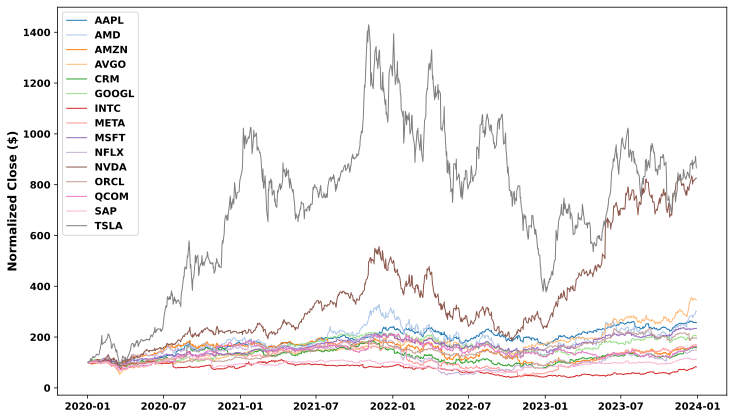

In [9]:
plot_normalized_close(norm_close_tech)

### 1.3 Histogram of Returns
<a id="subsection-13"></a>

In [10]:
def plot_histogram(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 

    Returns :
    -------
    - None 
    
    Function :
    --------
    - Draws a histogram and a kernel density estimation plot of daily returns for each asset 
    - Highlights the minimum return, average return, and maximum return with dotted vertical lines 
    """
    assets = returns_df.columns
    n_assets = len(assets)
    
    if n_assets % 2 == 0 :
        n_rows = n_assets // 2
    else :
        n_rows = (n_assets // 2) + 1
    
    fig, ax = plt.subplots(nrows = n_rows, ncols = 2, figsize = (12, n_rows * 5))
    colors = sns.color_palette("tab20")
    
    for i in range(n_rows) :
        for j in range(2) :
            idx = 2 * i + j
            
            if idx < n_assets :
                asset = assets[idx]
                
                min_ret = returns_df[asset].min( ) * 100
                mean_ret = returns_df[asset].mean( ) * 100
                max_ret = returns_df[asset].max( ) * 100
                
                ax[i][j].hist(
                    returns_df[asset] * 100,
                    bins = 50,
                    density = True,
                    color = colors[idx],
                    alpha = 0.7,
                    label = asset
                )
                sns.kdeplot(
                    returns_df[asset] * 100,
                    color = "black", 
                    ax = ax[i][j],
                )
                
                ax[i][j].axvline(x = min_ret, color = "red", linestyle = "--", label = f"{min_ret:.2f}")
                ax[i][j].axvline(x = mean_ret, color = "gold", linestyle = "--", label = f"{mean_ret:.2f}")
                ax[i][j].axvline(x = max_ret, color = "green", linestyle = "--", label = f"{max_ret:.2f}")
                ax[i][j].set_xlabel("Daily Return (%)", fontsize = 12)
                
                if idx % 2 == 0  :
                    ax[i][j].set_ylabel("Density", fontsize = 12)
                else :
                    ax[i][j].set_ylabel("")
                ax[i][j].legend(fontsize = 10)
    
    plt.style.use("default")
    plt.show( )

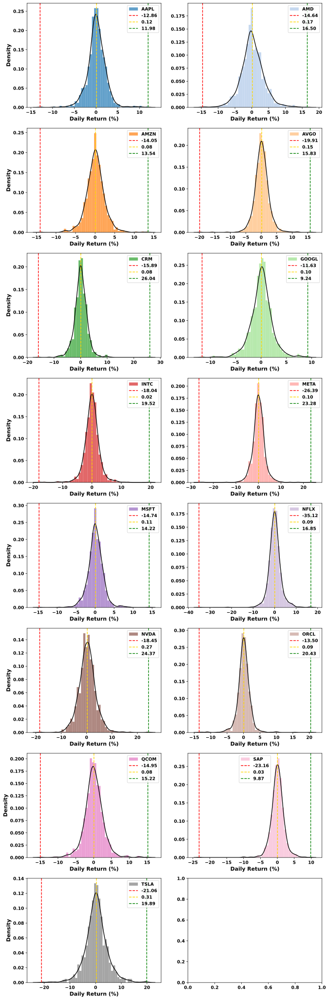

In [11]:
plot_histogram(returns[tickers])

### 1.4 Correlation Matrix
<a id="subsection-14"></a>

$$
\text{r}_{X, Y} = \frac{\sum_{t=1}^{T} (\text{Return}_{X,t} - \bar{\text{Return}_X}) \cdot (\text{Return}_{Y,t} - \bar{\text{Return}_Y})}{\sqrt{\sum_{t=1}^{T} (\text{Return}_{X,t} - \bar{\text{Return}_X})^2 \cdot \sum_{t=1}^{T} (\text{Return}_{Y,t} - \bar{\text{Return}_Y})^2}}
$$ 

In [12]:
def plot_corr_heatmap(returns_df, method = "pearson") :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns
    - method : str for the method for computing correlation -> pearson or spearman or kendall

    Returns :
    -------
    - None 
    
    Function :
    --------
    - Computes the correlation matrix using the specified method 
    - Removes repetitive correlation coefficients between the assets
    - Applies a green colormap to display the strength of correlation 
    """
    corr_mat = returns_df.corr(method = method) 
    n_assets = len(corr_mat.columns)
    
    for i in range(n_assets - 1) :
        corr_mat.iloc[i , i + 1 :] = np.nan 
    
    plt.figure(figsize = (min(12, n_assets), min(12, n_assets)))
    sns.heatmap(
        corr_mat, 
        annot = True, 
        square = True, 
        vmin = 0.55, 
        vmax = 0.85, 
        cmap = "Greens", 
        cbar = False, 
        fmt = ".4f"
    )
    sns.set_theme(font_scale = 1) 
    
    plt.xlabel("")
    plt.ylabel("")
    plt.style.use("default") 
    plt.show( )   

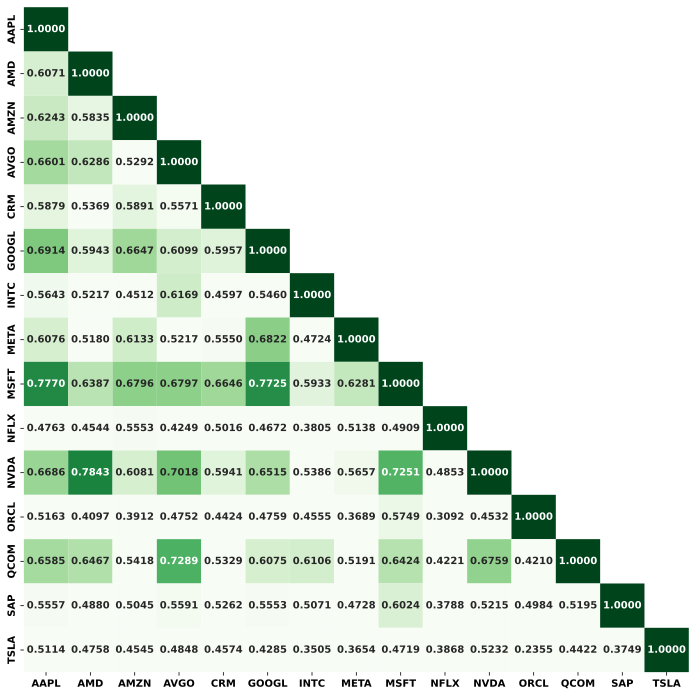

In [13]:
plot_corr_heatmap(returns[tickers])

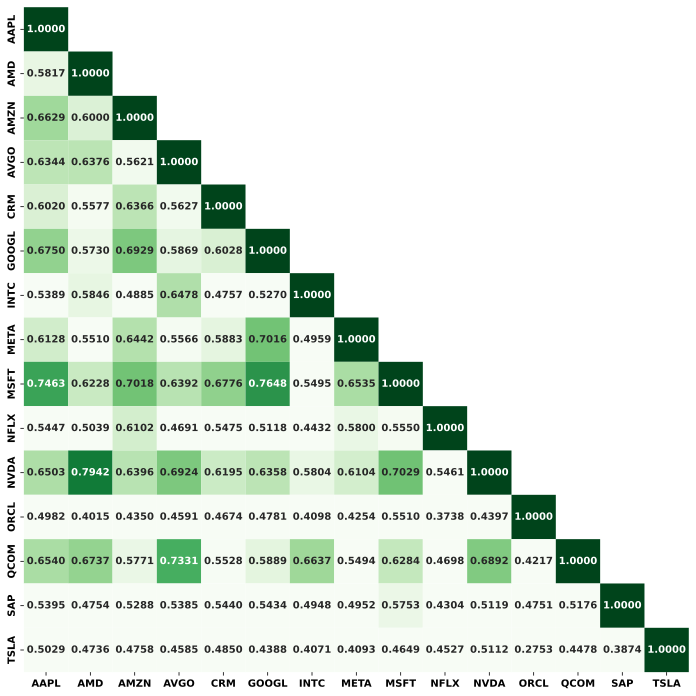

In [14]:
plot_corr_heatmap(returns[tickers], method = "spearman")

### 1.5 Normalized Plot of Cumulative Returns 
<a id="subsection-15"></a>

$$ 
\text{Cumulative Return}_{T} = \left( \prod_{t=1}^{T} 1 + \text{Return}_{t} \right) - 1
$$

In [15]:
cum_returns_stocks = (1 + returns[tickers]).cumprod( ) - 1 

In [16]:
def plot_cum_returns(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 

    Returns :
    -------
    - None 
        
    Function :
    --------
    - Draws a line plot of cumulative daily returns for each asset 
    """
    cum_returns_df = (1 + returns_df).cumprod( ) - 1 
    
    plt.figure(figsize = (12, 7))
    colors = sns.color_palette("tab20")
    
    for i, asset in enumerate(returns_df.columns) :
        plt.plot(
            cum_returns_df[asset].mul(100), 
            linewidth = 1.0, 
            c = colors[i], 
            label = asset
        )
    
    plt.xlabel("")
    plt.ylabel("Cumulative Returns (%)", fontsize = 12)
    plt.legend( )
    plt.style.use("default")
    plt.show( )  

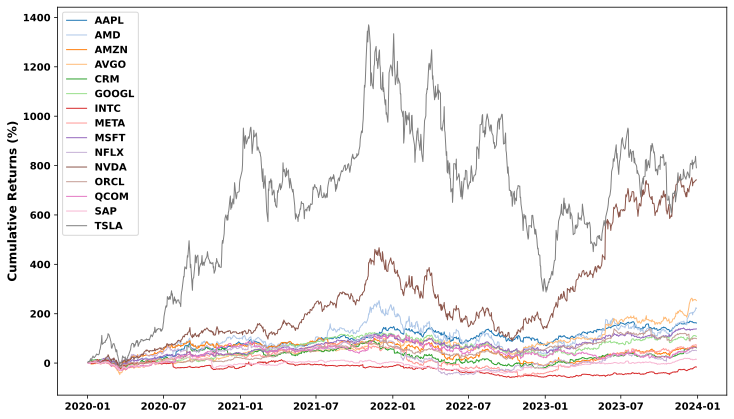

In [17]:
plot_cum_returns(returns[tickers]) 

### 1.6 Box & Whisker Plot of Returns 
<a id="subsection-16"></a>

$$ 
\text{Maximum} = \text{Q3} + 1.5 \times (\text{Q3} - \text{Q1}) 
$$ 

$$
\text{Q3} = \frac{4 \times (\text{N}+1)}{4}\text{-th ordered value}
$$ 

$$
\text{Median} = \frac{(\text{N}+1)}{2}\text{-th ordered value} 
$$

$$
\text{Q1} = \frac{(\text{N}+1)}{4}\text{-th ordered value}
$$ 

$$
\text{Minimum} = \text{Q1} - 1.5 \times (\text{Q3} - \text{Q1})
$$ 

In [18]:
def plot_box_whisker(returns_df, freq = None) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    - freq (optional) : str for resampling frequency -> weekly or monthly or quarterly or annual 

    Returns :
    -------
    - None 
        
    Function :
    --------
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Draws a box & whisker plot of returns for each asset 
    - Plots outlier values of returns for each asset
    """
    if freq : 
        resampling = {
            "weekly" : "W-Fri", 
            "monthly" : "BM", 
            "quarterly" : "BQ", 
            "annual" : "A"
        } 
        returns_df = returns_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    assets = returns_df.columns
    n_assets = len(assets)  
        
    plt.figure(figsize = (12, n_assets))
    colors = sns.color_palette("tab20") 
    
    for i, asset in enumerate(assets) :
        box = plt.boxplot(
            returns_df[asset] * 100, 
            positions = [i], 
            widths = 0.5, 
            vert = False, 
            patch_artist = True
        )
        plt.yticks(ticks = range(n_assets), labels = assets)
            
        for patch in box["boxes"] :
            patch.set_facecolor(colors[i])
            patch.set_alpha(0.7)
        for median in box["medians"] :
            median.set_color("black")
            
        if freq :
            plt.xlabel(f"{freq.title( )} Return (%)", fontsize = 12)
        else :
            plt.xlabel("Daily Return (%)", fontsize = 12)
    
    plt.style.use("default")
    plt.show( )

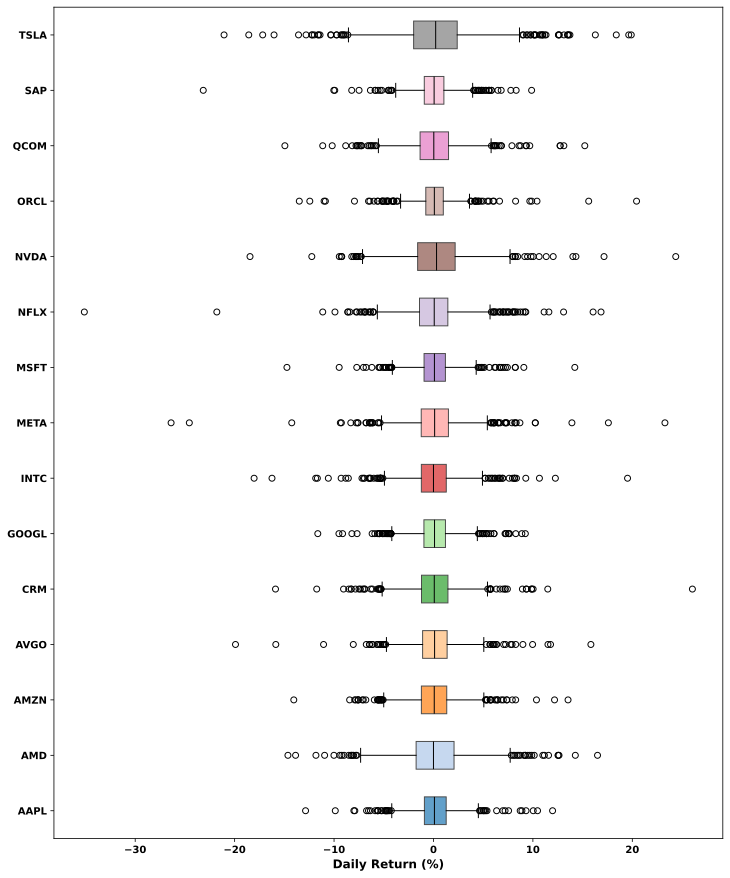

In [19]:
plot_box_whisker(returns[tickers])

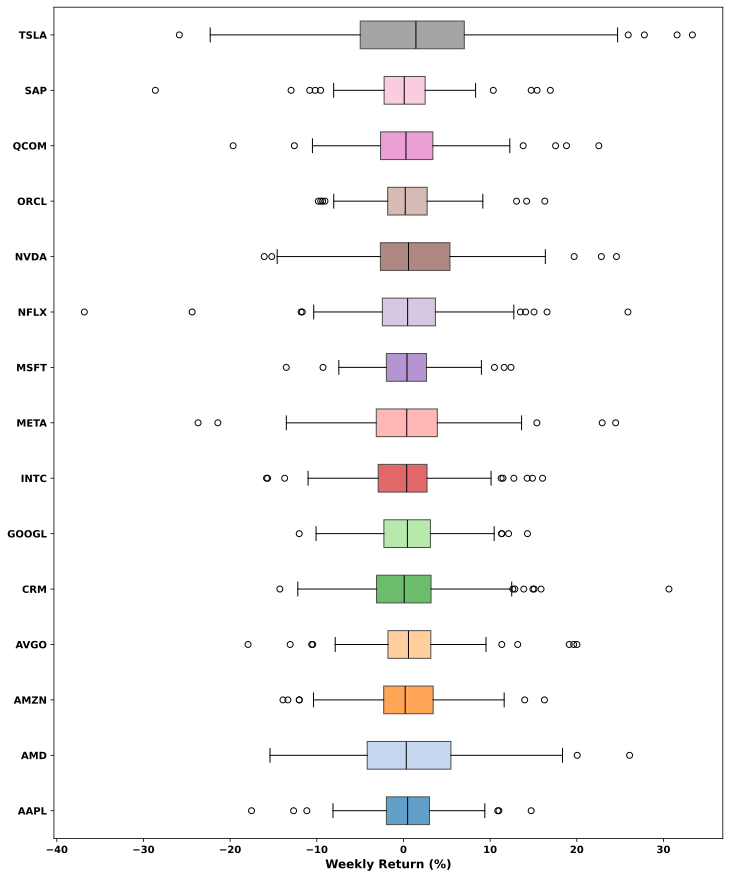

In [20]:
plot_box_whisker(returns[tickers], "weekly")

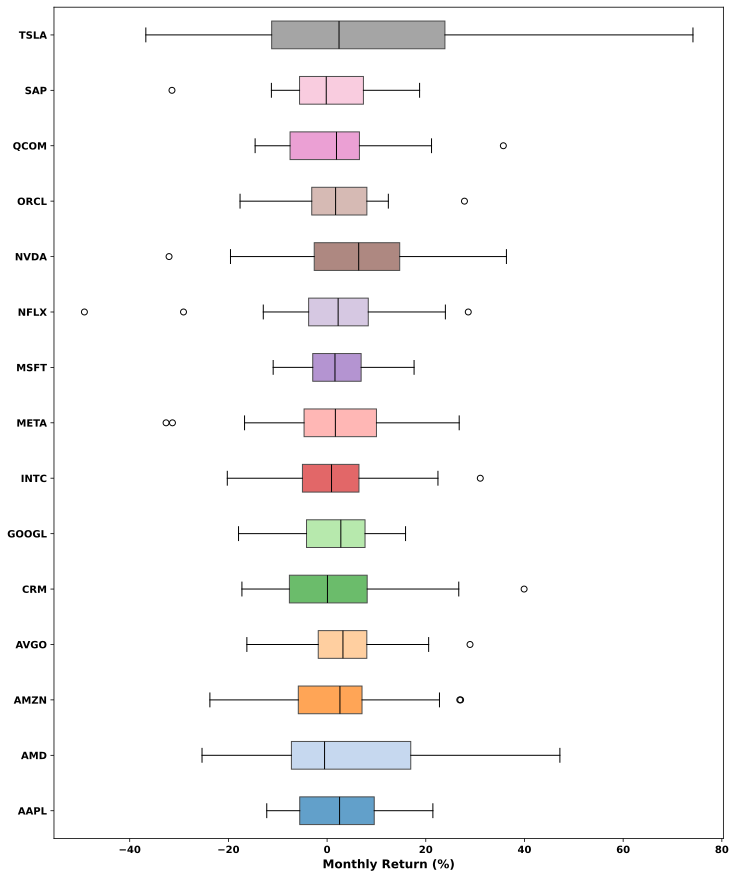

In [21]:
plot_box_whisker(returns[tickers], "monthly")

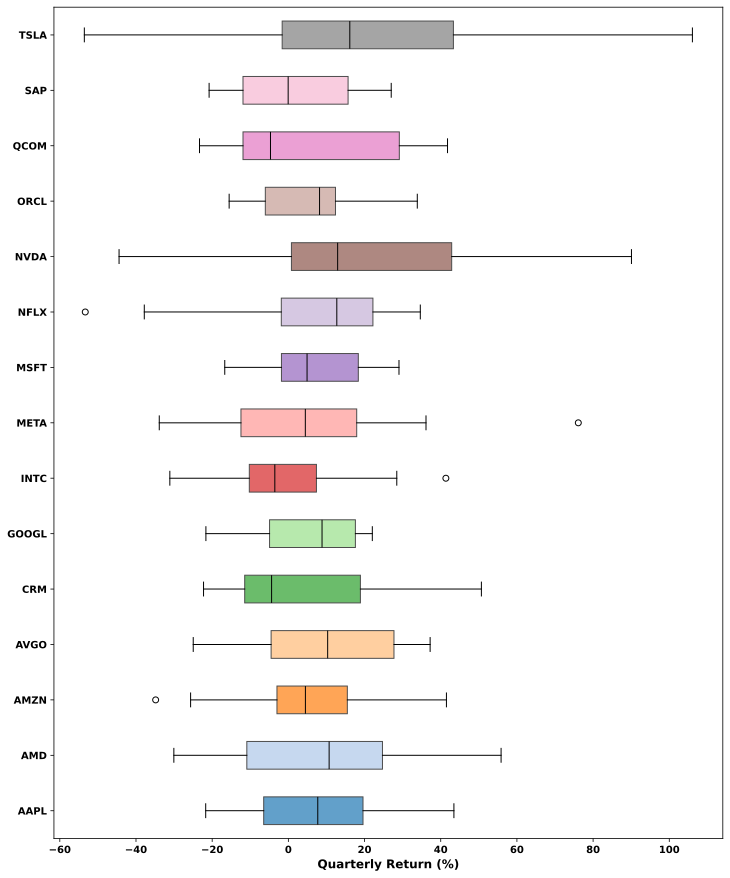

In [22]:
plot_box_whisker(returns[tickers], "quarterly")

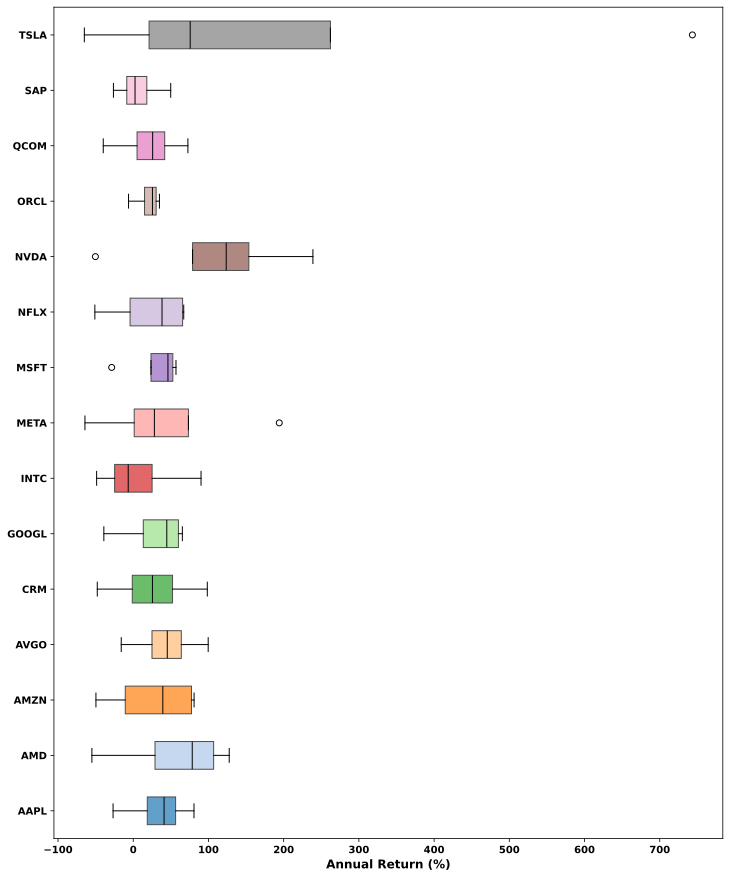

In [23]:
plot_box_whisker(returns[tickers], "annual")

### 1.7 Seasonal Pattern of Returns
<a id="subsection-17"></a>

In [24]:
def plot_seasonal_return(returns_df, freq = None) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    - freq (optional) : str for resampling frequency -> weekly or monthly 

    Returns :
    -------
    - None 
        
    Function :
    --------
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Plots a bar chart showing the average return in each month of the year for each asset
    """
    if freq :
        resampling = {"weekly" : "W-Fri", "monthly" : "BM"} 
        returns_df = returns_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)   
    
    returns_df["Month"] = returns_df.index.month
    monthly_avg_return = returns_df.groupby("Month").mean( )
    returns_df.drop(columns = ["Month"], inplace = True)
    
    month_mapper = {
        1 : "Jan", 2 : "Feb", 3 : "Mar", 
        4 : "Apr", 5 : 'May', 6: "Jun", 
        7 : "Jul", 8 : "Aug", 9 : "Sept", 
        10 : "Oct", 11 : "Nov", 12 : "Dec"
    }
    monthly_avg_return.index = monthly_avg_return.index.map(month_mapper)
    
    assets = returns_df.columns
    n_assets = len(assets)
    
    fig, ax = plt.subplots(nrows = n_assets, ncols = 1, figsize = (12, n_assets * 7))
    colors = sns.color_palette("tab20") 
    
    for i, asset in enumerate(assets) :  
        ax[i].bar(
            monthly_avg_return.index, 
            monthly_avg_return[asset] * 100, 
            width = 0.3, 
            color = colors[i], 
            alpha = 0.7, 
            label = asset
        )
        
        if freq :
            ax[i].set_ylabel(f"Average {freq.title( )} Return (%)", fontsize = 12)
        else :
            ax[i].set_ylabel("Average Daily Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default")
    plt.show( )

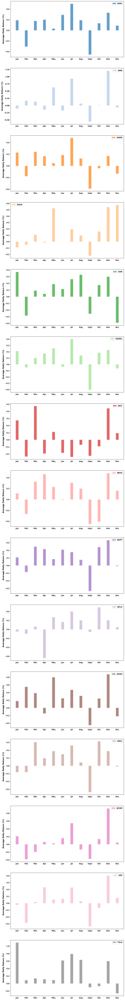

In [25]:
plot_seasonal_return(returns[tickers])

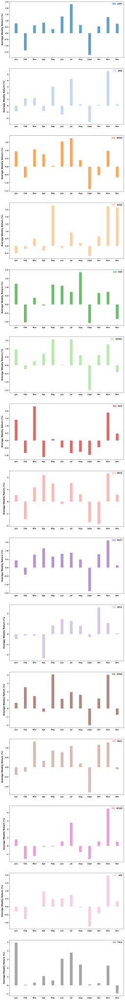

In [26]:
plot_seasonal_return(returns[tickers], freq = "weekly")

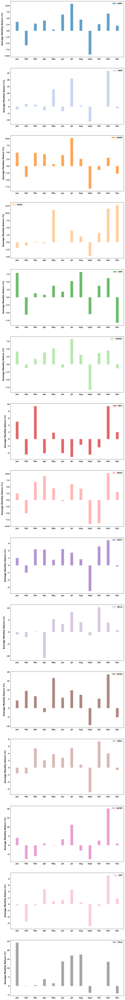

In [27]:
plot_seasonal_return(returns[tickers], freq = "monthly")

### 1.8 Dollar Triangle 
<a id="subsection-18"></a>

In [28]:
def dollar_triangle(returns_df, initial_balance) : 
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns for a particular asset  
    - initial_balance : int representing the initial investment in the asset 
    
    Returns :
    -------
    - dollar_triangle_df 
    
    Function :
    --------
    - Resamples daily returns to annual frequency, and converts to annual log returns 
    - Computes the dollar value of the initial balance invested in the asset at the beginning of the year and held for n years 
    """
    ann_returns = returns_df.resample("A", kind = "period").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1).to_frame( )
    ann_log_returns_df = np.log(ann_returns + 1).dropna( )
    
    max_years = ann_log_returns_df.index.size
    windows = list(range(max_years, 0, - 1)) 
    
    for n_years in windows :  
        ann_log_returns_df[f"{n_years} Y"] = np.exp(n_years * ann_log_returns_df.iloc[: , 0].rolling(n_years).mean( ))

    dollar_triangle_df = ann_log_returns_df.drop(columns = ann_log_returns_df.columns[0])
    dollar_triangle_df = dollar_triangle_df.mul(initial_balance)  
    return dollar_triangle_df 

In [29]:
def plot_dollar_triangle(returns_df, initial_balance = 1_000_000) :  
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns for a particular asset  
    - initial_balance : int representing the initial investment in the asset (1_000_000 by default)
    
    Returns :
    -------
    - None 
    
    Function :
    --------
    - Computes the dollar triangle for each asset 
    - Applies a green colormap to compare dollar values over time   
    """
    assets = returns_df.columns
    n_assets = len(assets)

    if n_assets % 2 == 0 :
        n_rows = n_assets // 2
    else :
        n_rows = (n_assets // 2) + 1
    
    fig, ax = plt.subplots(nrows = n_rows, ncols = 2, figsize = (12, n_rows * 5))

    for i in range(n_rows) :
        for j in range(2) :
            idx = 2 * i + j
            if idx < n_assets :
                asset = assets[idx]
                
                ticker_dollar_triangle = dollar_triangle(returns_df[asset], initial_balance = initial_balance)
            
                sns.heatmap(
                    ticker_dollar_triangle.T, 
                    annot = True, 
                    square = True, 
                    fmt = ".0f", 
                    cmap = "Greens", 
                    cbar = False, 
                    ax = ax[i , j]
                )
            
                ax[i][j].tick_params(axis = "y", left = False, labelleft = False, labelright = True)
                ax[i][j].set_xlabel("Year End", fontsize = 12)
                ax[i][j].set_ylabel(f"Holding Period in {asset}", fontsize = 12, rotation = 90, va = "center", labelpad = - 270)
    
    plt.style.use("default") 
    plt.show( )   

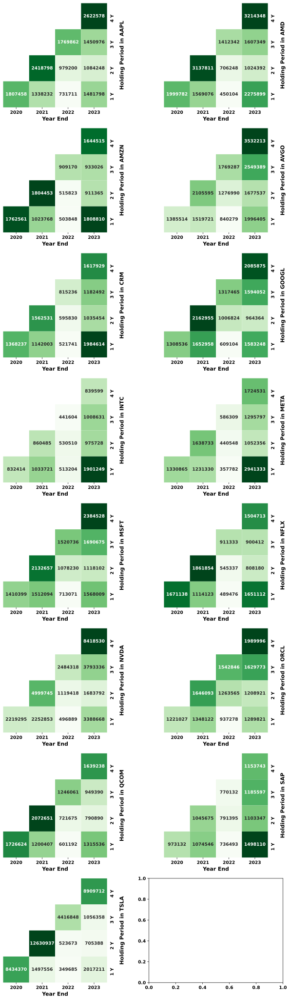

In [30]:
plot_dollar_triangle(returns[tickers])

### 1.9 Risk vs Return Trade-off 
<a id="subsection-19"></a>

**Number of Trading Days** :
- Weekly : 5
- Monthly : 21
- Quarterly : 63
- Annual : 252

$$
\bar{\text{Return}}_{Frequency} = \frac{1}{T} \left( \sum_{t=1}^{T} \text{Return}_{t} \right) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\sigma_{Frequency} = \sqrt{\frac{1}{T}\sum_{t=1}^{T}(\text{Return}_{t} - \bar{\text{Return}})^2} \times \sqrt{\text{Number of Trading Days}_{Frequency}} 
$$ 

$$
\text{Sharpe Ratio}_{Frequency} = \frac{\bar{\text{Return}}_{Frequency}}{\sigma_{Frequency}}
$$ 

In [31]:
def risk_return(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - summary_df : DataFrame displaying the average return, standard deviation, and sharpe ratio for each resampling frequency
    
    Function :
    --------
    - Computes the average daily return and average daily standard deviation
    - Converts the average daily return and average daily standard deviation to weekly, monthly, quarterly, and annual frequency 
    """      
    summary_df = returns_df.agg(["mean" , "std"]).transpose( )
    summary_df.columns = ["Daily Return" , "Daily Volatility"] 
    summary_df["Daily Sharpe"] = (summary_df["Daily Return"]).div(summary_df["Daily Volatility"]) 
    
    n_trading_days = {
        "weekly" : 5, 
        "monthly" : 21, 
        "quarterly" : 63, 
        "annual" : 252
    }
    
    for freq in n_trading_days.keys( ) :
        summary_df[f"{freq.title( )} Return"] = summary_df["Daily Return"] * n_trading_days[freq] 
        summary_df[f"{freq.title( )} Volatility"] =  summary_df["Daily Volatility"] * np.sqrt(n_trading_days[freq])  
        summary_df[f"{freq.title( )} Sharpe"] = summary_df[f"{freq.title( )} Return"].div(summary_df[f"{freq.title( )} Volatility"])
        
    summary_df.columns = pd.MultiIndex.from_product(
        [["Daily", "Weekly", "Monthly", "Quarterly", "Annual"], ["Return", "Volatility", "Sharpe"]]
    )
    return summary_df 

In [32]:
summary_stocks = risk_return(returns[tickers])

In [33]:
summary_stocks#.style\
              #.highlight_max(color = "lightgreen")\
              #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
      Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
AAPL  0.0012     0.0211 0.0559 0.0059     0.0473 0.1250  0.0248     0.0969   
AMD   0.0017     0.0338 0.0512 0.0086     0.0755 0.1144  0.0363     0.1548   
AMZN  0.0008     0.0237 0.0327 0.0039     0.0531 0.0731  0.0163     0.1088   
AVGO  0.0015     0.0242 0.0641 0.0077     0.0540 0.1434  0.0325     0.1107   
CRM   0.0008     0.0258 0.0313 0.0040     0.0577 0.0700  0.0170     0.1183   
GOOGL 0.0010     0.0211 0.0452 0.0048     0.0472 0.1010  0.0200     0.0968   
INTC  0.0002     0.0260 0.0064 0.0008     0.0581 0.0143  0.0035     0.1191   
META  0.0010     0.0295 0.0334 0.0049     0.0659 0.0747  0.0207     0.1350   
MSFT  0.0011     0.0206 0.0523 0.0054     0.0460 0.1170  0.0226     0.0942   
NFLX  0.0009     0.0307 0.0292 0.0045     0.0686 0.0653  0.0188     0.1405   
NVDA  0.0027     0.0341 0.0790 0.0135     0.0764 0.1766  0.0566     0.1565   
ORCL  0.0009     0.0207 0.0433 0.0045     0.0464 0.0968  0.0189     0.0951   
QCOM  0.0008     0.0266 0.0317 0.0042     0.0595 0.0710  0.0177     0.1219   
SAP   0.0003     0.0201 0.0174 0.0017     0.0449 0.0388  0.0073     0.0920   
TSLA  0.0031     0.0429 0.0722 0.0155     0.0959 0.1614  0.0650     0.1965   

             Quarterly                   Annual                    
      Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
AAPL  0.2562    0.0745     0.1679 0.4437 0.2979     0.3357 0.8874  
AMD   0.2345    0.1089     0.2682 0.4062 0.4358     0.5363 0.8125  
AMZN  0.1498    0.0489     0.1885 0.2594 0.1956     0.3769 0.5188  
AVGO  0.2938    0.0976     0.1917 0.5089 0.3903     0.3835 1.0178  
CRM   0.1434    0.0509     0.2050 0.2484 0.2036     0.4099 0.4968  
GOOGL 0.2070    0.0601     0.1677 0.3586 0.2405     0.3353 0.7172  
INTC  0.0292    0.0104     0.2063 0.0506 0.0418     0.4125 0.1012  
META  0.1530    0.0620     0.2338 0.2651 0.2479     0.4677 0.5302  
MSFT  0.2398    0.0677     0.1631 0.4153 0.2710     0.3263 0.8306  
NFLX  0.1338    0.0564     0.2433 0.2317 0.2255     0.4867 0.4634  
NVDA  0.3620    0.1699     0.2710 0.6270 0.6798     0.5421 1.2540  
ORCL  0.1983    0.0566     0.1647 0.3435 0.2262     0.3293 0.6869  
QCOM  0.1454    0.0532     0.2111 0.2519 0.2127     0.4222 0.5037  
SAP   0.0796    0.0220     0.1594 0.1378 0.0879     0.3188 0.2757  
TSLA  0.3307    0.1950     0.3404 0.5728 0.7799     0.6808 1.1456

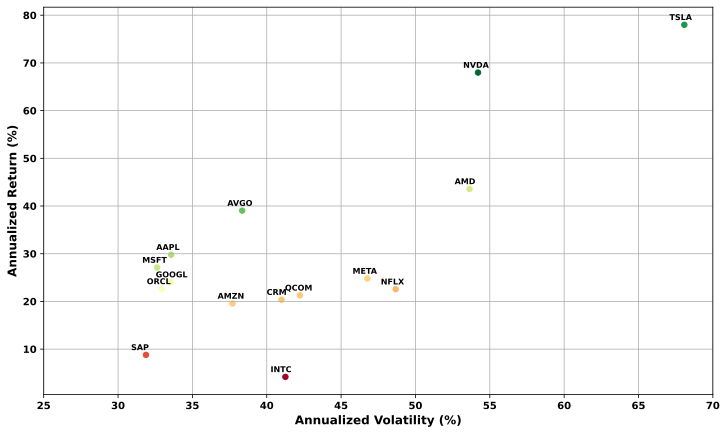

In [34]:
plt.figure(figsize = (12, 7))
plt.scatter(x = summary_stocks[("Annual", "Volatility")].mul(100), 
            y = summary_stocks[("Annual", "Return")].mul(100), 
            s = 30, 
            c = summary_stocks[("Annual", "Sharpe")], 
            cmap = "RdYlGn"
)

for ticker in summary_stocks.index : 
    plt.annotate(ticker, 
                 xy = (summary_stocks.loc[ticker , ("Annual", "Volatility")] * 100 - 1,  
                       summary_stocks.loc[ticker , ("Annual", "Return")] * 100 + 1), 
                 size = 8
    )

plt.xlabel("Annualized Volatility (%)", fontsize = 12)
plt.ylabel("Annualized Return (%)", fontsize = 12) 
plt.xticks(ticks = range(25, 71, 5))
plt.grid( )
plt.style.use("default")
plt.show( )

### 1.10 Wins vs Losses
<a id="subsection-110"></a>

$$
\text{Best Return}_{Frequency} = \max (\text{Frequency Return}_{t = 1}, \text{Frequency Return}_{t = 2}, \text{Frequency Return}_{t = 3}, \ldots, \text{Frequency Return}_{t = T}) 
$$ 

$$
\text{Worst Return}_{Frequency} = \min (\text{Frequency Return}_{t = 1}, \text{Frequency Return}_{t = 2}, \text{Frequency Return}_{t = 3}, \ldots, \text{Frequency Return}_{t = T}) 
$$ 

In [35]:
def best_worst_returns(returns_df) :
    """
    Arguments :
    ---------
    - returns_df: DataFrame of daily returns

    Returns :
    -------
    - best_worst_df: DataFrame displaying the best and worst returns for each resampling frequency

    Function :
    --------
    - Iteratively resamples daily returns
    - For each resampling frequency, computes the maximum return and minimum return for each asset
    """
    resampling = {
        "D" : "Daily", 
        "W-Fri": "Weekly", 
        "BM": "Monthly", 
        "BQ": "Quarterly", 
        "A": "Annual"
    }
    
    best_worst = { }
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        best_worst[f"Best {resampling[freq]} Return"] = np.array(periodic_returns_df.max( ))
        best_worst[f"Worst {resampling[freq]} Return"] = np.array(periodic_returns_df.min( ))

    best_worst_df = pd.DataFrame(data = best_worst, index = returns_df.columns)
    best_worst_df.columns = pd.MultiIndex.from_product(
        [["Daily", "Weekly", "Monthly", "Quarterly", "Annual"], ["Best Return", "Worst Return"]]
    )
    return best_worst_df

In [36]:
best_worst_stocks = best_worst_returns(returns[tickers])

In [37]:
best_worst_stocks#.style\
                 #.highlight_max(color = "lightgreen")\
                 #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
      Best Return Worst Return Best Return Worst Return Best Return   
AAPL       0.1198      -0.1286      0.1473      -0.1753      0.2144   
AMD        0.1650      -0.1464      0.2609      -0.1540      0.4718   
AMZN       0.1354      -0.1405      0.1626      -0.1390      0.2706   
AVGO       0.1583      -0.1991      0.2001      -0.1793      0.2896   
CRM        0.2604      -0.1589      0.3063      -0.1426      0.3993   
GOOGL      0.0924      -0.1163      0.1431      -0.1203      0.1590   
INTC       0.1952      -0.1804      0.1605      -0.1580      0.3105   
META       0.2328      -0.2639      0.2449      -0.2370      0.2677   
MSFT       0.1422      -0.1474      0.1241      -0.1352      0.1763   
NFLX       0.1685      -0.3512      0.2590      -0.3682      0.2861   
NVDA       0.2437      -0.1845      0.2457      -0.1607      0.3634   
ORCL       0.2043      -0.1350      0.1631      -0.0982      0.2784   
QCOM       0.1522      -0.1495      0.2254      -0.1965      0.3572   
SAP        0.0987      -0.2316      0.1695      -0.2863      0.1875   
TSLA       0.1989      -0.2106      0.3334      -0.2586      0.7415   

                     Quarterly                   Annual               
      Worst Return Best Return Worst Return Best Return Worst Return  
AAPL       -0.1223      0.4346      -0.2170      0.8075      -0.2683  
AMD        -0.2534      0.5584      -0.3006      1.2759      -0.5499  
AMZN       -0.2375      0.4150      -0.3484      0.8088      -0.4962  
AVGO       -0.1626      0.3722      -0.2497      0.9964      -0.1597  
CRM        -0.1726      0.5068      -0.2227      0.9846      -0.4783  
GOOGL      -0.1795      0.2204      -0.2165      0.6530      -0.3909  
INTC       -0.2022      0.4135      -0.3111      0.9012      -0.4868  
META       -0.3263      0.7612      -0.3389      1.9413      -0.6422  
MSFT       -0.1093      0.2904      -0.1670      0.5680      -0.2869  
NFLX       -0.4918      0.3464      -0.5332      0.6711      -0.5105  
NVDA       -0.3203      0.9007      -0.4444      2.3887      -0.5031  
ORCL       -0.1764      0.3385      -0.1554      0.3481      -0.0627  
QCOM       -0.1458      0.4178      -0.2333      0.7266      -0.3988  
SAP        -0.3144      0.2700      -0.2081      0.4981      -0.2635  
TSLA       -0.3673      1.0607      -0.5356      7.4344      -0.6503

$$
\text{Batting Average}_{Frequency} = \frac{\text{Number of Periods with Positive Returns}}{\text{T}} 
$$ 

In [38]:
def win_percentage(returns_df) : 
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - win_df : DataFrame displaying the % of rows with positive returns and the gain-pain ratio for each resampling frequency 
    
    Function :
    --------
    - Iteratively resamples daily returns 
    - For each resampling frequency, divides the number of timestamps with return > 0 by the total number of timestamps 
    """
    resampling = {
        "D" : "Day", 
        "W-Fri" : "Week", 
        "BM" : "Month", 
        "BQ" : "Quarter", 
        "A" : "Year"
    }
    
    win = { }
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        percent_win_list = [  ] 
        for asset in returns_df.columns :
            
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            positive_returns = asset_periodic_returns.loc[asset_periodic_returns > 0]
            negative_returns = asset_periodic_returns.loc[asset_periodic_returns < 0] 
            
            percent_win_period = (len(positive_returns) / len(asset_periodic_returns)) * 100
            percent_win_list.append(percent_win_period)
            
        win[f"% of Winning {resampling[freq]}s"] = percent_win_list

    win_df = pd.DataFrame(data = win, index = returns_df.columns)
    return win_df   

In [39]:
win_percent_stocks = win_percentage(returns[tickers])

In [40]:
win_percent_stocks

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
AAPL,52.4851,56.9378,58.3333,62.5000,75.0000
AMD,49.9006,52.1531,50.0000,62.5000,75.0000
AMZN,51.8887,53.1100,56.2500,62.5000,75.0000
AVGO,52.9821,58.8517,70.8333,68.7500,75.0000
CRM,52.0875,50.2392,50.0000,43.7500,75.0000
GOOGL,53.4791,54.0670,58.3333,68.7500,75.0000
INTC,49.8012,53.5885,54.1667,43.7500,50.0000
META,51.7893,52.6316,62.5000,56.2500,75.0000
MSFT,52.3857,55.0239,58.3333,75.0000,75.0000
NFLX,50.8946,52.6316,54.1667,68.7500,75.0000


$$ 
\text{Gain-Pain Ratio}_{Frequency} = \frac{\sum_{t=1}^{T} \max(0, \text{Return}_{t})}{\text{|}\sum_{t=1}^{T} \min(0, \text{Return}_{t})\text{|}}
$$ 

$$ 
\text{Pay Off Ratio}_{Frequency} = \frac{\frac{1}{T}\sum_{t=1}^{T} \text{Return}_{t} > 0}{\text{|}\frac{1}{T}\sum_{t=1}^{T} \text{Return}_{t} < 0\text{|}}
$$ 

$$ 
\text{Kelly Criterion}_{Frequency} = \frac{\text{Pay Off Ratio}_{Frequency} \times \text{Batting Average}_{Frequency} - (\text{1 - Batting Average}_{Frequency})}{\text{Pay Off Ratio}_{Frequency}}
$$ 

In [41]:
def win_loss_ratios(returns_df) :  
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - win_loss_df : DataFrame displaying the gain-pain ratio, payoff ratio, and kelly criterion for each resampling frequency 
    
    Function :
    --------
    - Iteratively resamples daily returns 
    - For each resampling frequency : 
      - Divides the sum of positive returns by the absolute value of the sum of negative returns 
      - Divides the average positive return by the absolute value of the average negative return 
    """
    resampling = {
        "D" : "Day", 
        "W-Fri" : "Week", 
        "BM" : "Month", 
        "BQ" : "Quarter", 
        "A" : "Year"
    }
    
    win_loss = { }
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        gain_pain_list = [  ]
        payoff_list = [  ]
        kelly_list = [  ]
        for asset in returns_df.columns :
            
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            positive_returns = asset_periodic_returns.loc[asset_periodic_returns > 0]
            negative_returns = asset_periodic_returns.loc[asset_periodic_returns < 0] 
            
            gain_pain_period = positive_returns.sum( ) / np.abs(negative_returns.sum( ))
            gain_pain_list.append(gain_pain_period)
            
            payoff_period = positive_returns.mean( ) / np.abs(negative_returns.mean( ))
            payoff_list.append(payoff_period)

            percent_win_period = len(positive_returns) / len(asset_periodic_returns) 
            kelly_period = ((payoff_period * percent_win_period - (1 - percent_win_period)) / payoff_period) * 100
            kelly_list.append(kelly_period)
            
        win_loss[f"{resampling[freq]} Gain-Pain Ratio"] = gain_pain_list
        win_loss[f"{resampling[freq]} Pay Off Ratio"] = payoff_list
        win_loss[f"{resampling[freq]} Kelly Criterion (%)"] = kelly_list

    win_loss_df = pd.DataFrame(data = win_loss, index = returns_df.columns)
    win_loss_df.columns = pd.MultiIndex.from_product(
        [["Daily", "Weekly", "Monthly", "Quarterly", "Annual"], ["Gain-Pain Ratio", "Pay Off Ratio", "Kelly Criterion (%)"]]
    ) 
    return win_loss_df   

In [42]:
win_loss_stocks = win_loss_ratios(returns[tickers])

In [43]:
win_loss_stocks#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
AAPL           1.1713        1.0537              7.3926          1.4258   
AMD            1.1500        1.1500              6.3362          1.3395   
AMZN           1.0948        1.0109              4.2959          1.2178   
AVGO           1.2036        1.0682              8.9641          1.5325   
CRM            1.0956        1.0078              4.5461          1.2069   
GOOGL          1.1347        0.9849              6.2459          1.3070   
INTC           1.0188        1.0148              0.3330          1.0257   
META           1.1061        1.0276              4.8728          1.2227   
MSFT           1.1599        1.0499              7.0329          1.4011   
NFLX           1.0928        1.0543              4.3204          1.2060   
NVDA           1.2397        1.0399             10.3034          1.6295   
ORCL           1.1460        1.0312              6.6019          1.3166   
QCOM           1.0927        1.0627              4.3006          1.2091   
SAP            1.0522        0.9852              2.2511          1.1187   
TSLA           1.2237        1.0495              9.7357          1.5051   

                                                Monthly                \
      Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
AAPL         1.0784             17.0052          1.8863        1.3473   
AMD          1.2289             13.2192          1.8037        1.8037   
AMZN         1.0752              9.4985          1.4731        1.1457   
AVGO         1.0715             20.4482          2.3795        0.9798   
CRM          1.1954              8.6136          1.4501        1.4501   
GOOGL        1.1104             12.7007          1.7234        1.2310   
INTC         0.8883              1.3433          1.0352        0.8759   
META         1.1005              9.5879          1.5200        0.9120   
MSFT         1.1452             15.7507          2.1260        1.5186   
NFLX         1.0854              8.9911          1.5014        1.2704   
NVDA         1.3320             21.2572          2.5682        1.5409   
ORCL         1.0972             13.1180          1.7417        1.4738   
QCOM         1.0472              9.2673          1.4511        1.3350   
SAP          1.0462              5.4823          1.2275        1.3343   
TSLA         1.1835             18.7873          2.2659        1.7623   

                                Quarterly                                    \
      Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
AAPL              27.4083          2.9477        1.7686             41.2968   
AMD               22.2799          2.7608        1.6565             39.8614   
AMZN              18.0642          2.0388        1.2233             31.8447   
AVGO              41.0655          3.4319        1.5599             48.7172   
CRM               15.5186          1.8146        2.3331             19.6399   
GOOGL             24.4846          2.5131        1.1423             41.3938   
INTC               1.8420          1.0774        1.3852              3.1418   
META              21.3803          1.9509        1.5174             27.4173   
MSFT              30.8956          3.4311        1.1437             53.1413   
NFLX              18.0883          1.8646        0.8475             31.8788   
NVDA              38.1637          5.0020        1.6673             60.0059   
ORCL              23.0674          2.5730        1.5438             38.2096   
QCOM              16.1914          1.7755        2.2827             19.1086   
SAP                8.8822          1.3547        1.3547             13.0902   
TSLA              31.4252          4.5441        2.0655             53.6204   

               Annual                                    
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)  
AAPL           6.0662        2.0221   

In [44]:
def streak(returns_df) : 
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - streak_df : DataFrame displaying the longest streak of days with positive / negative returns for each resampling frequency 
    
    Function :
    --------
    - Iteratively resamples daily returns 
    - For each resampling frequency, computes the highest number of consecutive days with returns > 0 / returns < 0
    """
    resampling = {
        "D" : "Day", 
        "W-Fri" : "Week", 
        "BM" : "Month", 
        "BQ" : "Quarter", 
        "A" : "Year"
    }
    
    win_streak = { }
    lose_streak = { }
    for freq in resampling.keys( ) :
        
        if freq == "D" :
            periodic_returns_df = returns_df.copy( )
        else :
            periodic_returns_df = returns_df.resample(freq).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
        
        longest_win_list = [  ]
        longest_lose_list = [  ]
        for asset in returns_df.columns :
            
            asset_periodic_returns = periodic_returns_df[asset].copy( )
            
            longest_win_streak = 0
            current_win_streak = 0      
            for return_value in asset_periodic_returns.values :
                if return_value > 0 :
                    current_win_streak += 1
                    if current_win_streak > longest_win_streak :
                        longest_win_streak = current_win_streak
                else :
                    current_win_streak = 0
            longest_win_list.append(longest_win_streak)
            
            longest_lose_streak = 0
            current_lose_streak = 0      
            for return_value in asset_periodic_returns.values :
                if return_value < 0 :
                    current_lose_streak += 1
                    if current_lose_streak > longest_lose_streak :
                        longest_lose_streak = current_lose_streak
                else :
                    current_lose_streak = 0
            longest_lose_list.append(longest_lose_streak) 
            
        win_streak[f"Longest Streak of Winning {resampling[freq]}s"] = longest_win_list
        lose_streak[f"Longest Streak of Losing {resampling[freq]}s"] = longest_lose_list
    
    win_streak_df = pd.DataFrame(data = win_streak, index = returns_df.columns)
    lose_streak_df = pd.DataFrame(data = lose_streak, index = returns_df.columns)
    
    streak_df = pd.concat(axis = 1, objs = [win_streak_df, lose_streak_df])
    streak_df.columns = pd.MultiIndex.from_product(
        [["Longest Winning Streak", "Longest Losing Streak"], ["Days", "Weeks", "Months", "Quarters", "Years"]]
    ) 
    return streak_df   

In [45]:
win_lose_streak_stocks = streak(returns[tickers])

In [46]:
win_lose_streak_stocks

Longest Winning Streak                              \
                        Days Weeks Months Quarters Years   
AAPL                      11     8      7        3     2   
AMD                        8     7      3        3     2   
AMZN                       8    10      6        4     2   
AVGO                       8     7      6        7     2   
CRM                        8     7      5        2     2   
GOOGL                      7     8      8        7     2   
INTC                       9     7      5        5     1   
META                       8     6      9        5     2   
MSFT                       9     9      6        8     2   
NFLX                       8     6      4        4     2   
NVDA                      10     9      6        5     2   
ORCL                       8     7      6        7     2   
QCOM                       9     6      5        3     2   
SAP                       11     8      5        3     1   
TSLA                      13    11      6        4     2   

      Longest Losing Streak                              
                       Days Weeks Months Quarters Years  
AAPL                      8     8      3        2     1  
AMD                       8     5      4        3     1  
AMZN                      7     8      5        2     1  
AVGO                      7     5      3        3     1  
CRM                       6     5      4        5     1  
GOOGL                     6     5      3        4     1  
INTC                      7     4      4        6     1  
META                      7     7      4        6     1  
MSFT                      7     5      3        3     1  
NFLX                      8     7      6        3     1  
NVDA                      7     5      3        3     1  
ORCL                     11     7      4        3     1  
QCOM                      9     6      4        4     1  
SAP                       7     7      6        3     1  
TSLA                      7     5      5        2     1

### 1.11 Statistical Attributes of Returns 
<a id="subsection-111"></a>

***Tests of Normality :***

$$ 
W = \frac{{(\sum_{i=1}^{T} a_i x_{(i)})^2}}{{\sum_{i=1}^{T} (x_i - \bar{x})^2}} 
$$ 

$\text{Where :}$
- $ T \text{ is the sample size.} $
- $ x_{(i)} \text{ is the \( i \)-th order statistic (i.e., the \( i \)-th smallest value in the sample).} $
- $ \bar{x} \text{ is the sample mean.} $
- $ a_i \text{ are constants obtained from the covariance matrix of the order statistics of a normal sample.} $

The Shapiro-Wilk test evaluates the null hypothesis that the sample is normally distributed. If the p-value associated with the test statistic $W$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected, suggesting that the sample does not follow a normal distribution.

$$
JB = \frac{T}{6} \left( S^2 + \frac{1}{4}(K-3)^2 \right)
$$

Where:
- $ T \text{ is the sample size.} $
- $ S \text{ is the sample skewness.} $
- $ K \text{ is the sample kurtosis.} $

The Jarque-Bera test evaluates the null hypothesis that the sample is normally distributed. If the p-value associated with the test statistic $JB$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected, suggesting that the sample does not follow a normal distribution.

***Tests of Stationarity :***

$$ 
\text{ADF} = \frac{{\text{Coefficient Estimate} - 1}}{{\text{Standard Error}}} 
$$

Where:
- $ \text{Coefficient Estimate is the estimated coefficient of the lagged differenced series in the regression equation.} $
- $ \text{Standard error is the standard error of the coefficient estimate.} $

The Augmented Dickey-Fuller test evaluates the null hypothesis that the time series is stationary around a deterministic trend. If the p-value associated with the test statistic $ADF$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected. The time series has a unit root, indicating non-stationarity (or a stochastic trend).

$$
\text{KPSS} = \frac{{\sum_{t=1}^{T} (S_t - S_{t-1})^2 / T}}{{(\sum_{t=1}^{T} S_t^2 / T)}}
$$

Where:
- $ S_t \text{ is the cumulative sum of the deviations of the time series from its mean at time \( t \).} $
- $ T \text{ is the number of observations in the time series.} $

The Kwiatkowski-Phillips-Schmidt-Shin test evaluates the null hypothesis that the time series is stationary around a deterministic trend. If the p-value associated with the test statistic $KPSS$ is less than a chosen significance level (e.g., 0.05), the null hypothesis is rejected. The time series has a unit root, indicating non-stationarity (or a stochastic trend).

***Finding the Best-Fit Distribution :***

$$ 
D = \max_{i} | F(x_i) - S(x_i) | 
$$ 

$\text{Where :}$
- $ F(x) \text{ is the empirical cumulative distribution function (CDF) of the sample.} $
- $ S(x) \text{ is the theoretical CDF of the specified distribution.} $ 
- $ x_i \text{ are the observed data points.} $

The Kolmogorov-Smirnov test evaluates the null hypothesis that the sample is drawn from the specified distribution. The closer the p-value associated with the test statistic D is to 1, the more the null hypothesis is rejected (assuming p-value > significance level), suggesting that the sample follows more strongly the specified distribution. 

***Common Distributions for Fitting Stock Returns :***

$$ 
F(x) = \frac{1}{2} + \frac{1}{2} \cdot \text{sign}(x - \mu) \cdot \left[1 - \exp\left(-\left(\frac{|x - \mu|}{\beta}\right)^{\alpha}\right)\right] 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)}. $
- $ \mu \text{ is the location parameter.} $
- $ \beta \text{ is the scale parameter.} $
- $ \alpha \text{ is the shape parameter.} $
- $ \text{sign}(x - \mu) \text{ is the sign function, which is 1 if \( x > \mu \), -1 if \( x < \mu \), and 0 if \( x = \mu \).} $
- $ |x - \mu| \text{ represents the absolute difference between \( x \) and \( \mu \).} $

The CDF defines the probability that a random variable following the **Generalized Normal Distribution** is less than or equal to a given value $x$.

$$
F(x) = \frac{1}{\sqrt{2 \pi}} \int_{-\infty}^{x} \frac{1}{\sigma \sqrt{1 + \left(\frac{y - \mu}{\gamma}\right)^2}} e^{-\frac{1}{2} \left(\frac{u}{\sigma \sqrt{1 + \left(\frac{y - \mu}{\gamma}\right)^2}}\right)^2} \, du 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)}. $
- $ \mu \text{ is the location parameter.} $
- $ \gamma \text{ is the shape parameter (scale parameter in some formulations).} $
- $ \sigma \text{ is the scale parameter (shape parameter in some formulations).} $
- $ \text{e is the base of natural logarithms.} $
- $ \pi \text{ is the mathematical constant pi.} $

The CDF defines the probability that a random variable following the **Johnson SU Distribution** is less than or equal to a given value $x$.

$$ 
F(x) = \int_{-\infty}^{x} \frac{\Gamma\left(\frac{\nu + 1}{2}\right)}{\sqrt{\nu \pi} \Gamma\left(\frac{\nu}{2}\right)} \left(1 + \frac{t^2}{\nu}\right)^{-\frac{\nu + 1}{2}} \, dt 
$$

$\text{Where :}$
- $ F(x) \text{ is the cumulative distribution function at \( x \)} $
- $ \nu \text{ is the degrees of freedom parameter, which affects the shape and tail behavior of the distribution.} $
- $ \Gamma(\cdot) \text{ is the gamma function.} $
- $ t \text{ represents the random variable following the Student's t-distribution.} $

The CDF defines the probability that a random variable following the **Student's t Distribution** is less than or equal to a given value $x$.

In [47]:
def distribution_attributes(returns_df) : 
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - distribution_df : DataFrame displaying ratios for analyzing the distribution of daily returns 
    
    Function :
    --------
    - Conducts the Shapiro-Wilik and Jarque-Bera tests of normality and computes the p-values 
    - Conducts the Augmented Dickey-Fuller, Kwiatkowski-Phillips-Schmidt-Shin tests of stationarity and computes the p-values 
    - Returns the distribution (and its p-value) that best fits each asset's daily returns amongst different distributions 
    """  
    dist_names = ["lognorm", "gennorm", "powernorm", "skewnorm", "exponnorm", "truncnorm", "johnsonsb", "johnsonsu", "t"]
    
    sw_list = [  ]
    jb_list = [  ]
    adf_list = [  ]
    kpss_list = [  ]
    best_dist_list = [  ]
    best_p_val_list = [  ]
    for asset in returns_df.columns : 
        
        p_val_sw = stats.shapiro(returns_df[asset])[1] 
        p_val_jb = stats.jarque_bera(returns_df[asset])[1]
        p_val_adf = adfuller(returns_df[asset])[1]
        p_val_kpss = kpss(returns_df[asset])[1]
        
        sw_list.append(p_val_sw)
        jb_list.append(p_val_jb)
        adf_list.append(p_val_adf)
        kpss_list.append(p_val_kpss)
        
        dist_results = [ ]
        for dist_name in dist_names :
            
            dist = getattr(stats, dist_name)
            params = dist.fit(returns_df[asset])
            stat, p_val = stats.kstest(returns_df[asset], dist_name, args = params)
            dist_results.append((dist_name, p_val))
        
        best_dist, best_p_val = (max(dist_results, key = lambda item: item[1]))
        best_dist_list.append(best_dist)
        best_p_val_list.append(best_p_val)
        
    tests_df = pd.DataFrame({
        "Shapiro-Wilk P-Value" : sw_list, 
        "Jarque-Bera P-Value" : jb_list, 
        "Augmented Dickey-Fuller P-Value" : adf_list, 
        "Kwiatkowski-Phillips-Schmidt-Shin P-Value" : kpss_list, 
        "Best-Fit Distribution" : best_dist_list, 
        "Best-Fit P-Value" : best_p_val_list
    }, index = returns_df.columns)
    return tests_df 

In [48]:
dist_attributes_stocks = distribution_attributes(returns[tickers])

In [49]:
dist_attributes_stocks

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
AAPL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9478
AMD,0.0000,0.0000,0.0000,0.1000,gennorm,0.4572
AMZN,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9959
AVGO,0.0000,0.0000,0.0000,0.1000,t,0.9620
CRM,0.0000,0.0000,0.0000,0.1000,t,0.9173
GOOGL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9044
INTC,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9751
META,0.0000,0.0000,0.0000,0.1000,t,0.5524
MSFT,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8796
NFLX,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9971


In [50]:
def plot_qq(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 

    Returns :
    -------
    - None 
    
    Function :
    --------
    - Draws a quantile-quantile plot of daily returns for each asset
    """
    assets = returns_df.columns
    n_assets = len(assets)
    
    if n_assets % 2 == 0 :
        n_rows = n_assets // 2
    else :
        n_rows = (n_assets // 2) + 1
    
    fig, ax = plt.subplots(nrows = n_rows, ncols = 2, figsize = (12, n_rows * 5))
    
    for i in range(n_rows) :
        for j in range(2) :
            idx = 2 * i + j
            if idx < n_assets :
                asset = assets[idx]
                
                gofplots.qqplot(
                    returns_df[asset] * 100, 
                    line = "q", 
                    ax = ax[i][j]
                )
                
                ax[i][j].get_lines( )[0].set_markersize(5)                
                ax[i][j].set_xlabel("σ Away From μ", fontsize = 12)
                if idx % 2 == 0 :
                    ax[i][j].set_ylabel("Daily Returns (%)", fontsize = 12)
                else :
                    ax[i][j].set_ylabel("")
                ax[i][j].legend([asset], fontsize = 10)
    
    plt.style.use("default")
    plt.show( )

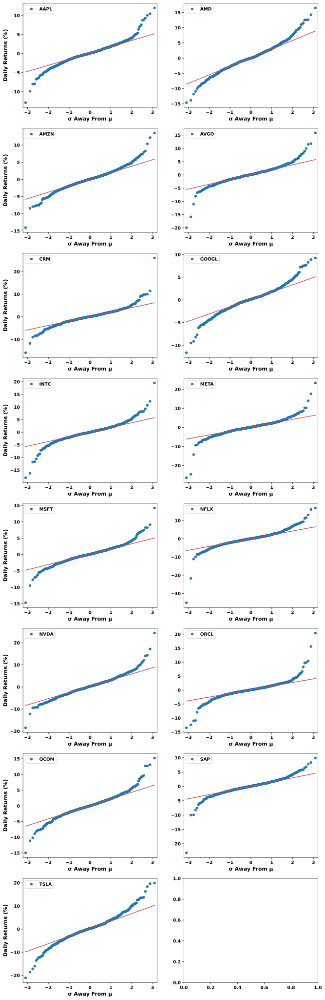

In [51]:
plot_qq(returns[tickers])

### 1.12 What About Drawdowns and Downside Risk? 
<a id="subsection-112"></a>

$$ 
\text{Annualized Downside } \sigma = \sqrt{\frac{1}{T} \sum_{t=1}^{T} \min\left((\text{Return}_{t} - \bar{\text{Return}})^2, 0\right)} \times \sqrt{252} 
$$ 

$$
\text{Average Drawdown} = \frac{1}{T} \sum_{t=1}^{T} \text{Drawdown}_{t}
$$ 

$$
\text{Average Drawdown Duration} = \frac{\text{Number of Drawdown Days}}{\text{Number of Drawdowns}} 
$$ 

$$
\text{Maximum Drawdown} = \max (\text{Drawdown}_{t = 1}, \text{Drawdown}_{t = 2}, \text{Drawdown}_{t = 3}, \ldots, \text{Drawdown}_{t = T}) 
$$ 

$$
\text{Longest Drawdown Duration} = \max(\text{Drawdown Duration}_1, \text{Drawdown Duration}_2, \ldots, \text{Drawdown Duration}_N)
$$ 

$$
\text{Sterling Ratio} = \frac{\text{Annualized Return} - \text{Risk-Free Rate}}{\text{|} \frac{1}{N} \sum_{i=1}^{N} \text{Largest Drawdown}_i\text{|}} 
$$

$$
\text{Ulcer Index} = \sqrt{\frac{1}{T} \sum_{t=1}^{T} (\text{Drawdown}_{t})^2} \times 100
$$

$$
\text{Calmar Ratio} = \frac{\text{Annualized } \bar{\text{Return}}}{\text{|Maximum Drawdown|}}
$$ 

$$
\text{Sortino Ratio} = \frac{\text{Annualized } \bar{\text{Return}} - \text{Risk-Free Rate}}{\text{Annualized Downside } \sigma}
$$ 

$$
\text{Kappa Ratio} = \frac{\text{Annualized } \bar{\text{Return}} - \text{Risk-Free Rate}}{\text{Annualized Downside } \sigma + \text{|Skew|} + \text{|Kurtosis|}}
$$ 

In [52]:
def downside(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - downside_df : DataFrame displaying ratios related to downside risk  
    
    Function :
    --------
    - Computes the annualized semi-deviation, average drawdown, maximum drawdown, sterling ratio, ulcer index, calmar ratio, sortino ratio, and kappa ratio 
    """
    wealth_index = (1 + returns_df).cumprod( )
    previous_peaks = wealth_index.cummax( )
    drawdowns_df = (wealth_index - previous_peaks) / previous_peaks
    
    avg_drawdown = np.array(drawdowns_df.mean( )) 
    max_drawdown = np.array(drawdowns_df.min( )) 
    
    longest_dd_duration_list = [  ]
    avg_dd_duration_list = [  ]
    sterling_list = [  ]
    for asset in drawdowns_df.columns :
        
        longest_dd_streak = 0
        current_dd_streak = 0 
        n_drawdowns = 0
        for drawdown_value in drawdowns_df[asset].values :
            if drawdown_value < 0 :
                current_dd_streak += 1
                if current_dd_streak > longest_dd_streak :
                    longest_dd_streak = current_dd_streak
            else :
                n_drawdowns += 1 
                current_dd_streak = 0
        longest_dd_duration_list.append(longest_dd_streak)   
        
        n_dd_days = len(drawdowns_df[asset].loc[drawdowns_df[asset] < 0]) 
        avg_dd_duration = n_dd_days / n_drawdowns 
        avg_dd_duration_list.append(avg_dd_duration)
        
        ann_return = returns_df[asset].mean( ) * 252 
        worst_five_dds = drawdowns_df[asset].nsmallest(5).values
        avg_worst_dd = worst_five_dds.mean( )
        sterling = (ann_return - rf_rate) / np.abs(avg_worst_dd) 
        sterling_list.append(sterling)
        
    mean_squared_drawdowns = np.array(drawdowns_df.pow(2).mean( )) 
    ulcer_index = np.sqrt(mean_squared_drawdowns) * 100 
    
    avg_return = np.array(returns_df.mean( ).mul(252)) 
    calmar = avg_return / np.abs(max_drawdown) 
    
    downside_std_list = [  ]
    sortino_list = [  ]
    kappa_list = [  ]
    for asset in returns_df.columns : 
        
        downside_returns = returns_df[asset].loc[returns_df[asset] < 0]
        downside_std = downside_returns.std( ) * np.sqrt(252)
        downside_std_list.append(downside_std)
        
        ann_return = returns_df[asset].mean( ) * 252 
        sortino = (ann_return - rf_rate) / downside_std 
        sortino_list.append(sortino)
        
        skew = returns_df[asset].skew( )
        kurt = returns_df[asset].kurtosis( )
        kappa = (ann_return - rf_rate) / (downside_std + np.abs(skew) + np.abs(kurt)) 
        kappa_list.append(kappa)
        
    downside_df = pd.DataFrame({
        "Annual Downside Standard Deviation" : downside_std_list, 
        "Average Drawdown" : avg_drawdown, 
        "Average Drawdown Duration (Days)" : avg_dd_duration_list, 
        "Maximum Drawdown" : max_drawdown, 
        "Longest Drawdown Duration (Days)" : longest_dd_duration_list, 
        "Sterling Ratio" : sterling_list, 
        "Ulcer Index" : ulcer_index, 
        "Calmar Ratio" : calmar, 
        "Sortino Ratio" : sortino_list, 
        "Kappa Ratio" : kappa_list
    }, index = returns_df.columns)
    return downside_df 

In [53]:
downside_stocks = downside(returns[tickers]) 

In [54]:
downside_stocks#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
AAPL,0.2359,-0.0957,12.0649,-0.3143,360,0.8622,12.1738,0.9479,1.1358,0.0517
AMD,0.3432,-0.2496,19.5306,-0.6545,524,0.6279,30.9158,0.6658,1.1822,0.1492
AMZN,0.2560,-0.2023,23.5366,-0.5615,624,0.2987,25.8112,0.3483,0.6468,0.0403
AVGO,0.2800,-0.0914,9.5895,-0.4830,349,0.8503,12.9584,0.8081,1.2867,0.0348
CRM,0.2815,-0.2527,23.5366,-0.5862,538,0.2969,29.9426,0.3474,0.6168,0.0123
GOOGL,0.2386,-0.1343,10.0549,-0.4432,530,0.4928,18.2466,0.5426,0.8820,0.0592
INTC,0.3074,-0.3291,250.5000,-0.6363,990,0.0185,37.2002,0.0656,0.0382,0.0013
META,0.3662,-0.2518,22.9524,-0.7674,582,0.2868,33.5673,0.3231,0.5952,0.0122
MSFT,0.2302,-0.1044,10.0549,-0.3756,392,0.6744,14.3968,0.7215,1.0469,0.0357
NFLX,0.3862,-0.2926,22.9524,-0.7595,531,0.2590,37.9341,0.2970,0.5063,0.0083


$$
\text{Drawdown}_{t} = \min \left( 0 , \text{Cumulative Return}_{t} - \text{Previous Peak}_{t} \right) 
$$ 

In [55]:
def plot_drawdowns(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - None

    Function : 
    --------
    - Computes drawdowns for each asset
    - Plots area charts of drawdowns for each asset 
    """
    wealth_index = (1 + returns_df).cumprod( )
    previous_peaks = wealth_index.cummax( )
    drawdowns_df = (wealth_index - previous_peaks) / previous_peaks 
    avg_drawdowns = np.array(drawdowns_df.mean( )) * 100
    
    assets = returns_df.columns
    n_assets = len(drawdowns_df.columns)
    
    fig, ax = plt.subplots(
        nrows = n_assets, 
        ncols = 1, 
        figsize = (12, n_assets * 3), 
        sharex = False
    )
    colors = sns.color_palette("tab20") 
    
    for i, asset in enumerate(assets) :
        ax[i].fill_between(
            x = drawdowns_df.index, 
            y1 = 0, 
            y2 = drawdowns_df[asset] * 100, 
            color = colors[i], 
            alpha = 0.5,
            label = asset
        )
        
        ax[i].axhline(y = avg_drawdowns[i], color = "red", linestyle = "--", label = str(avg_drawdowns[i].round(2)))
        ax[i].set_ylabel("Drawdown (%)", fontsize = 12)
        ax[i].legend( )
        
    plt.style.use("default") 
    plt.show( ) 

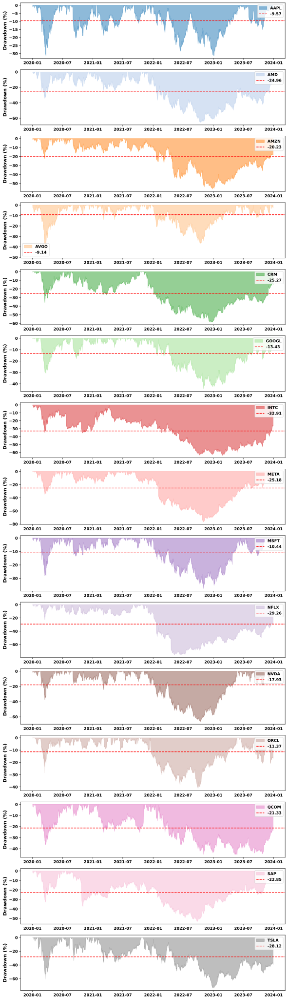

In [56]:
plot_drawdowns(returns[tickers])

### 1.13 Tail Risk
<a id="subsection-113"></a>

$$ 
\text{Skew} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^3}{\left(\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^2\right)^{3/2}}
$$ 

$$
\text{Kurtosis} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^4}{\left(\frac{1}{T} \sum_{t=1}^{T} (\text{Return}_{t} - \bar{\text{Return}})^2\right)^{2}}
$$

$$
\text{Average Lower Tail Return} = \frac{1}{T} \sum_{t=1}^{T} \text{(Return < % Threshold)}_{t}
$$

$$
\text{Average Upper Tail Return} = \frac{1}{T} \sum_{t=1}^{T} \text{(Return > (1 - %) Threshold)}_{t}
$$

$$
\text{Tail Ratio} = \frac{\text{Average Upper Tail Return}}{\text{|Average Lower Tail Return|}}
$$

$$
\text{Common Sense Ratio} = \text{Gain-Pain Ratio} \times \text{Tail Ratio}
$$

$$
\text{Outlier Win Ratio} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return} > \text{99th percentile})_{t}}{\frac{1}{T} \sum_{t=1}^{T} (\text{Return > 0})_{t}}
$$

$$
\text{Outlier Loss Ratio} = \frac{\frac{1}{T} \sum_{t=1}^{T} (\text{Return} < \text{1st percentile})_{t}}{\frac{1}{T} \sum_{t=1}^{T} (\text{Return < 0})_{t}}
$$

In [57]:
def tail_attributes(returns_df, threshold = 0.05) : 
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    - threshold : float representing the quantile for lower and upper tail returns -> 0.01 or 0.05 or 0.1 
    
    Returns :
    -------
    - tail_df : DataFrame displaying ratios for analyzing the tail characteristics of daily returns 
    
    Function :
    --------
    - Computes the skew, kurtosis, average lower tail return, average upper tail return, tail ratio, common sense ratio, outlier win ratio, and outlier loss ratio 
    """
    skew_list = [  ]
    kurt_list = [  ]
    avg_lt_return_list = [  ]
    avg_ut_return_list = [  ]
    tail_list = [  ]
    common_sense_list = [  ]
    outlier_win_list = [  ]
    outlier_loss_list = [  ]
    for asset in returns_df.columns :
        
        skew = returns_df[asset].skew( )
        kurt = returns_df[asset].kurt( )
        
        lower_tail_threshold = returns_df[asset].quantile(threshold)  
        lower_tail_returns = returns_df[asset].loc[returns_df[asset] < lower_tail_threshold]
        avg_lt_return = lower_tail_returns.mean( )
        
        upper_tail_threshold = returns_df[asset].quantile(1 - threshold)
        upper_tail_returns = returns_df[asset].loc[returns_df[asset] > upper_tail_threshold]
        avg_ut_return = upper_tail_returns.mean( )
        if avg_lt_return != 0 :
            tail = avg_ut_return / abs(avg_lt_return)
        else :
            tail = np.nan
        
        positive_returns = returns_df[asset].loc[returns_df[asset] > 0]
        negative_returns = returns_df[asset].loc[returns_df[asset] < 0] 
        if negative_returns.sum( ) != 0 :
            gain_pain = positive_returns.sum( ) / abs(negative_returns.sum( ))
        else :
            gain_pain = np.nan
        common_sense = gain_pain * tail 
        
        avg_upper_outlier_return = returns_df[asset].quantile(1 - threshold).mean( )
        avg_positive_return = returns_df[asset].loc[returns_df[asset] > 0].mean( )
        if avg_positive_return != 0 :
            outlier_win = avg_upper_outlier_return / avg_positive_return
        else :
            outlier_win = np.nan
        
        avg_lower_outlier_return = returns_df[asset].quantile(threshold).mean( )
        avg_negative_return = returns_df[asset].loc[returns_df[asset] < 0].mean( )
        if avg_negative_return != 0 :
            outlier_loss = avg_lower_outlier_return / avg_negative_return
        else :
            outlier_loss = np.nan
        
        skew_list.append(skew)
        kurt_list.append(kurt)
        avg_lt_return_list.append(avg_lt_return)
        avg_ut_return_list.append(avg_ut_return)
        tail_list.append(tail)
        common_sense_list.append(common_sense)
        outlier_win_list.append(outlier_win)
        outlier_loss_list.append(outlier_loss)
    
    tail_df = pd.DataFrame({
        "Skew" : skew_list,
        "Kurtosis" : kurt_list, 
        f"Average Lower Tail Return (< {int(threshold * 100)}%)" : avg_lt_return_list,
        f"Average Upper Tail Return (> {int((1 - threshold) * 100)}%)" : avg_ut_return_list, 
        "Tail Ratio" : tail_list,
        "Common Sense Ratio" : common_sense_list,
        f"Outlier Win Ratio (> {int((1 - threshold) * 100)}%)" : outlier_win_list,
        f"Outlier Loss Ratio (< {int(threshold * 100)}%)" : outlier_loss_list 
    }, index = returns_df.columns)
    return tail_df 

In [58]:
tail_stocks = tail_attributes(returns[tickers], threshold = 0.05)

In [59]:
tail_stocks#.style\
           #.highlight_max(color = "lightgreen")\
           #.highlight_min(color = "lightcoral")

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 95%),Outlier Loss Ratio (< 5%)
AAPL,0.0769,4.8718,-0.0469,0.0488,1.0415,1.2199,2.1135,2.2166
AMD,0.2163,2.1605,-0.0715,0.0805,1.1259,1.2948,2.1121,2.2454
AMZN,0.0959,3.7537,-0.0527,0.0550,1.0431,1.1420,2.2456,2.0753
AVGO,-0.3107,9.7730,-0.0518,0.0567,1.0950,1.3180,2.1330,2.0860
CRM,0.8161,13.0642,-0.0565,0.0596,1.0539,1.1547,2.0996,2.1805
GOOGL,-0.0966,3.2226,-0.0477,0.0497,1.0405,1.1806,2.2945,2.1238
INTC,-0.1492,8.7736,-0.0601,0.0596,0.9923,1.0110,2.0340,2.0564
META,-0.5770,16.8893,-0.0644,0.0669,1.0380,1.1482,2.1182,2.1303
MSFT,0.0246,6.4885,-0.0452,0.0478,1.0567,1.2257,2.0116,2.0784
NFLX,-1.3312,21.7792,-0.0668,0.0722,1.0811,1.1813,2.3350,1.9865


$$
\text{Historic Value at Risk}_{\alpha, Frequency} = \text{Quantile}_{\alpha}(\text{Historical Returns}) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\text{Parametric Value at Risk}_{\alpha, Frequency} = (\mu + z_{\alpha} \times \sigma) \times \text{Number of Trading Days}_{Frequency}  
$$ 

$$
\text{Cornish-Fisher Value at Risk}_{\alpha, Frequency} = \left( \mu + \sigma \times \left( z_{\alpha} + \frac{1}{6} (z_{\alpha}^2 - 1) \times \text{skewness} + \frac{1}{24}(z_{\alpha}^3 - 3z_{\alpha}) \times \text{kurtosis} - \frac{1}{36}(2z_{\alpha}^3 - 5z_{\alpha}) \times \text{skewness}^2 \right) \right) \times \text{Number of Trading Days}_{Frequency} 
$$

$$
\text{Conditional Value at Risk}_{\alpha, Frequency} = \left( \frac{1}{1-\alpha} \int_{-\infty}^{\text{VaR}_{\alpha}} x \cdot f(x) \,dx \right)  \times \text{Number of Trading Days}_{Frequency} 
$$ 

In [60]:
def Value_at_Risk(returns_df, significance = 0.05) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    - significance : float representing the significance level -> 0.01 or 0.05 or 0.1  
    
    Returns :
    -------
    - VaR_df : DataFrame displaying ratios related to Value at Risk 
    
    Function :
    --------
    - Computes the historic VaR, parametric VaR, cornish-fisher VaR, and Conditional VaR at the specified confidence level 
    """    
    hist_VaR_list = [  ]
    param_VaR_list = [  ]
    cf_VaR_list = [  ]
    cond_VaR_list = [  ]
    for asset in returns_df.columns :
        
        hist_VaR = np.percentile(returns_df[asset], significance * 100)
        hist_VaR_list.append(hist_VaR)
        
        avg_return = returns_df[asset].mean( )
        vol = returns_df[asset].std( )
        param_VaR = stats.norm.ppf(significance, avg_return, vol)
        param_VaR_list.append(param_VaR)
        
        skew = returns_df[asset].skew( )
        kurtosis = returns_df[asset].kurt( )
        z = stats.norm.ppf(significance)
        z_cf = z + (z**2 - 1) * skew / 6 + (z**3 - 3 * z) * kurtosis / 24 - (2 * z**3 - 5 * z) * (skew**2) / 36
        cf_VaR = avg_return + z_cf * vol
        cf_VaR_list.append(cf_VaR)
        
        cond_VaR = returns_df[asset].loc[returns_df[asset] <= hist_VaR].mean( )
        cond_VaR_list.append(cond_VaR)
            
    VaR_df = pd.DataFrame({
        "Daily Historic VaR" : hist_VaR_list, 
        "Daily Parametric VaR" : param_VaR_list, 
        "Daily Cornish-Fisher VaR" : cf_VaR_list, 
        "Daily Conditional VaR" : cond_VaR_list
    }, index = returns_df.columns) 
    
    n_trading_days = {
        "weekly" : 5, 
        "monthly" : 21, 
        "quarterly" : 63, 
        "annual" : 252
    }
    
    for freq in n_trading_days.keys( ) :
        VaR_df[f"{freq.title( )} Historic VaR"] = VaR_df["Daily Historic VaR"] * np.sqrt(n_trading_days[freq]) 
        VaR_df[f"{freq.title( )} Parametric VaR"] =  VaR_df["Daily Parametric VaR"] * np.sqrt(n_trading_days[freq])  
        VaR_df[f"{freq.title( )} Cornish-Fisher VaR"] = VaR_df["Daily Cornish-Fisher VaR"] * np.sqrt(n_trading_days[freq])  
        VaR_df[f"{freq.title( )} Conditional VaR"] = VaR_df["Daily Conditional VaR"] * np.sqrt(n_trading_days[freq])  
    
    VaR_df.columns = pd.MultiIndex.from_product([
        ["Daily", "Weekly", "Monthly", "Quarterly", "Annual"],
        [f"Historic VaR ({int((1 - significance) * 100)}%)", f"Parametric VaR ({int((1 - significance) * 100)}%)", 
         f"Cornish-Fisher VaR ({int((1 - significance) * 100)}%)", f"Conditional VaR ({int((1 - significance) * 100)}%)"]
    ])
    return VaR_df 

In [61]:
VaR_stocks = Value_at_Risk(returns[tickers])

In [62]:
VaR_stocks#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                                                \
      Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
AAPL             -0.0324              -0.0336                  -0.0311   
AMD              -0.0519              -0.0538                  -0.0503   
AMZN             -0.0355              -0.0383                  -0.0358   
AVGO             -0.0337              -0.0382                  -0.0355   
CRM              -0.0385              -0.0417                  -0.0285   
GOOGL            -0.0324              -0.0338                  -0.0330   
INTC             -0.0365              -0.0426                  -0.0391   
META             -0.0410              -0.0475                  -0.0421   
MSFT             -0.0295              -0.0327                  -0.0299   
NFLX             -0.0390              -0.0495                  -0.0466   
NVDA             -0.0512              -0.0535                  -0.0463   
ORCL             -0.0271              -0.0332                  -0.0209   
QCOM             -0.0394              -0.0429                  -0.0389   
SAP              -0.0281              -0.0327                  -0.0325   
TSLA             -0.0640              -0.0674                  -0.0641   

                                        Weekly                       \
      Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
AAPL                -0.0469            -0.0724              -0.0751   
AMD                 -0.0715            -0.1160              -0.1204   
AMZN                -0.0527            -0.0793              -0.0856   
AVGO                -0.0518            -0.0754              -0.0854   
CRM                 -0.0565            -0.0860              -0.0932   
GOOGL               -0.0477            -0.0725              -0.0756   
INTC                -0.0601            -0.0815              -0.0952   
META                -0.0644            -0.0918              -0.1062   
MSFT                -0.0452            -0.0659              -0.0732   
NFLX                -0.0668            -0.0873              -0.1108   
NVDA                -0.0696            -0.1144              -0.1196   
ORCL                -0.0467            -0.0607              -0.0743   
QCOM                -0.0590            -0.0881              -0.0959   
SAP                 -0.0454            -0.0628              -0.0731   
TSLA                -0.0932            -0.1432              -0.1508   

                                                                Monthly  \
      Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
AAPL                   -0.0694               -0.1048            -0.1485   
AMD                    -0.1124               -0.1598            -0.2377   
AMZN                   -0.0801               -0.1178            -0.1625   
AVGO                   -0.0794               -0.1158            -0.1546   
CRM                    -0.0638               -0.1264            -0.1762   
GOOGL                  -0.0738               -0.1068            -0.1486   
INTC                   -0.0874               -0.1343            -0.1671   
META                   -0.0941               -0.1441            -0.1881   
MSFT                   -0.0668               -0.1011            -0.1351   
NFLX                   -0.1043               -0.1493            -0.1789   
NVDA                   -0.1035               -0.1557            -0.2345   
ORCL                   -0.0467               -0.1044            -0.1244   
QCOM                   -0.0871               -0.1320            -0.1807   
SAP                    -0.0727               -0.1016            -0.1287   
TSLA                   -0.1433               -0.2085            -0.2935   

                                                                           \
      Parametric VaR (95%) Cornish-Fisher VaR (95%) Conditional VaR (95%)   
AAPL               -0.1540                  -0.1423               -0.2147   
AMD                -0.2467                  -

In [63]:
def plot_Value_at_Risk(VaR_df, freq = "annual") :
    """
    Arguments :
    ---------
    - VaR_df : DataFrame displaying ratios related to Value at Risk
    - freq : str for the resampling frequency -> "daily" or "weekly" or "monthly" or "quarterly" or "annual"

    Returns :
    -------
    - None 
    
    Function :
    --------
    - Plots bar charts of historic, parametric, cornish-fisher, and conditional Value at Risk for each asset at the specified resampling frequency 
    """
    n_assets = len(VaR_df.index)
    ax = VaR_df[freq.title( )].mul(100).plot(
        kind = "bar", 
        figsize = (min(12, n_assets), 20), 
        fontsize = 10, rot = 0, 
        subplots = True, 
        sharex = False, 
        width = 0.5, 
        alpha = 0.7, 
        xlabel = "", 
        ylabel = f"% {freq.title( )}", 
        title = ["", "", "", ""]
    ) 
    
    for i, col in enumerate(VaR_df[freq.title( )].columns) :
        ax[i].tick_params(axis = "x", bottom = False, top = True, labelbottom = False, labeltop = True)
        ax[i].axhline(VaR_df[(freq.title( ), col)].mean( ) * 100, linestyle = "--", c = "red")
        
    plt.style.use("default")
    plt.show( ) 

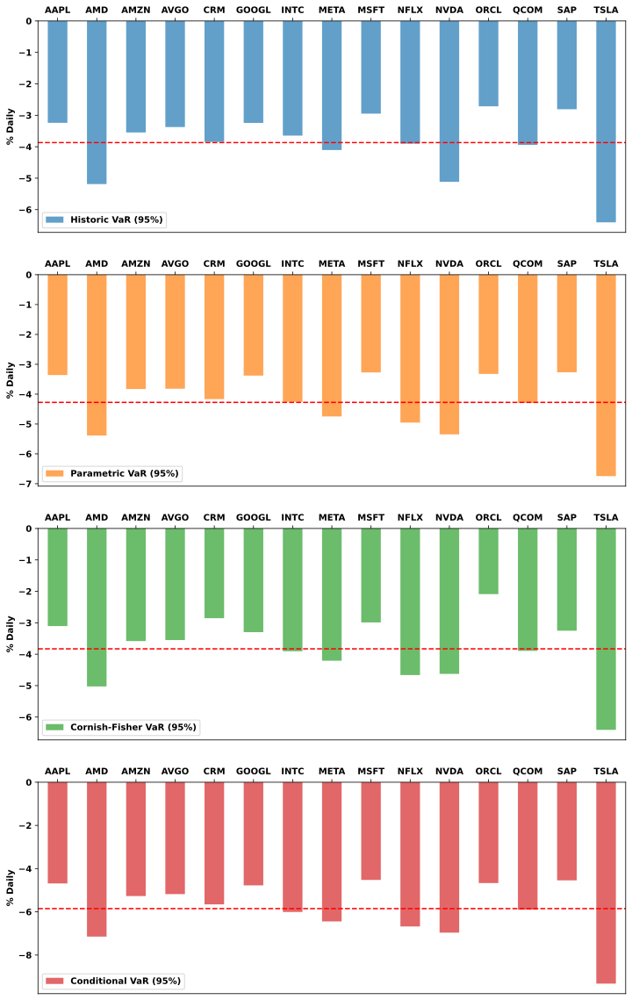

In [64]:
plot_Value_at_Risk(VaR_stocks, "daily") 

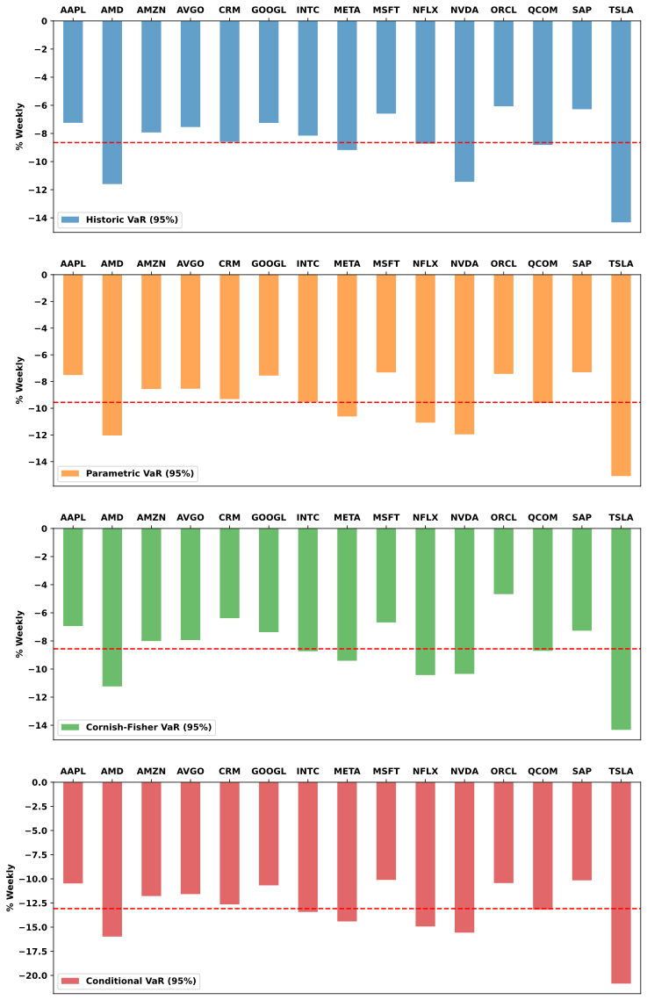

In [65]:
plot_Value_at_Risk(VaR_stocks, "weekly") 

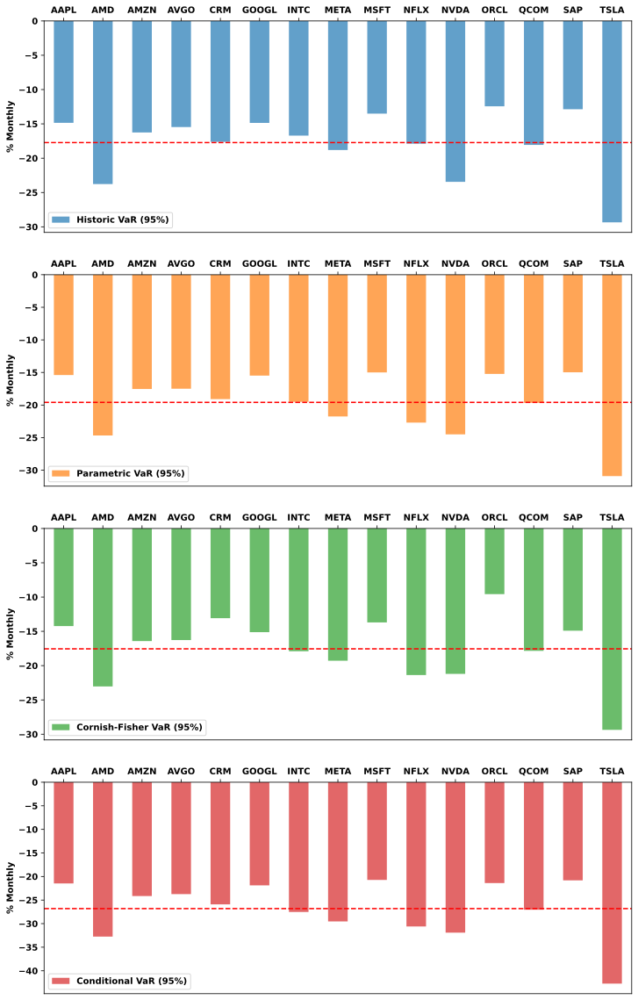

In [66]:
plot_Value_at_Risk(VaR_stocks, "monthly") 

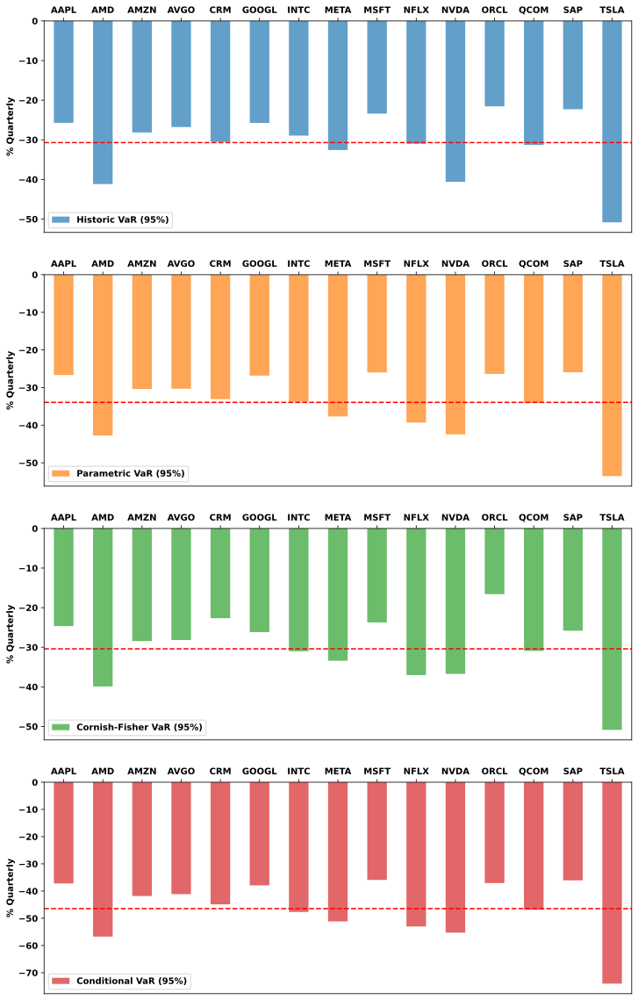

In [67]:
plot_Value_at_Risk(VaR_stocks, "quarterly") 

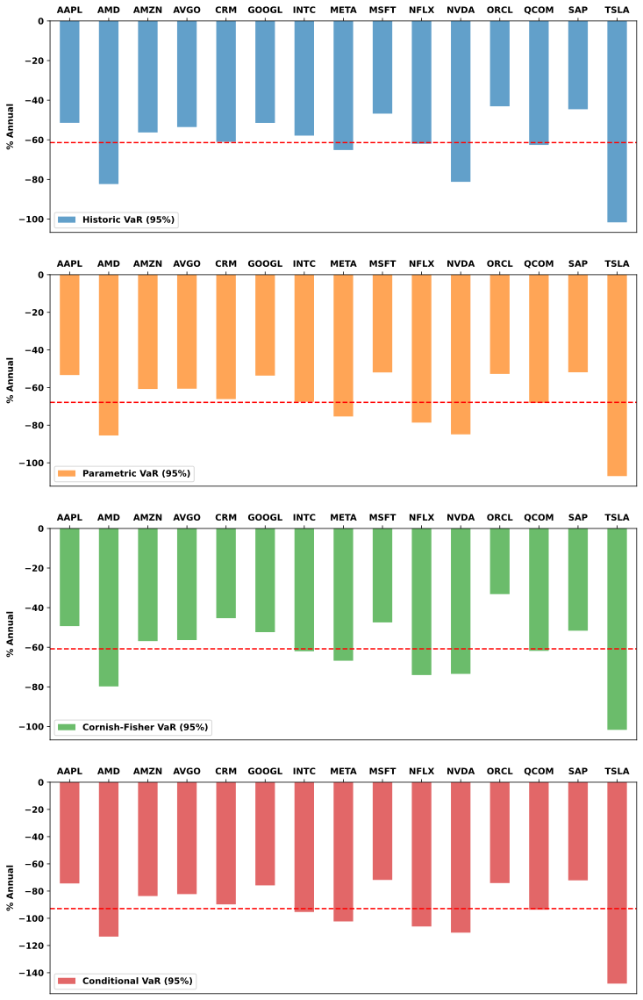

In [68]:
plot_Value_at_Risk(VaR_stocks) 

In [69]:
def plot_MC_worst_scenarios(returns_df, n_days, n_simulations = 10_000) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    - n_days : int for the number of forward days to forecast
    - n_simulations : int for the number of random walks to simulate (10_000 by default) 
    
    Returns :
    -------
    - None 
    
    Function :
    --------
    - Computes Monte Carlo simulations for the n_days forward price of each asset 
    - Plots the 5 simulations with the lowest ending value for each asset 
    """
    assets = returns_df.columns
    n_assets = len(returns_df.columns)
    
    if n_assets % 2 == 0 :
        n_rows = n_assets // 2
    else :
        n_rows = (n_assets // 2) + 1

    fig, ax = plt.subplots(nrows = n_rows, ncols = 2, figsize = (12, n_rows * 5))
    
    for i in range(n_rows) :
        for j in range(2) :
            idx = 2 * i + j
            if idx < n_assets:
                asset = assets[idx]
                
                avg_return = returns_df[asset].mean( )
                vol = returns_df[asset].std( )
                
                if asset in tickers :
                    value_start = close_tech.iloc[-1, close_tech.columns.get_loc(asset)]
                else :
                    value_start = 10_000
                
                simulated_values = { }
                for sim in range(n_simulations) :
                    rand_returns = np.random.normal(avg_return, vol, n_days) + 1
                    forecasted_values = value_start * (rand_returns).cumprod( )
                    simulated_values[sim] = forecasted_values
                
                mc_df = pd.DataFrame(simulated_values)
                bottom_5_paths = mc_df.iloc[-1].nsmallest(5).index.tolist( )
                
                ax[i][j].plot(list(range(n_days)), mc_df[bottom_5_paths])
                
                ax[i][j].set_xlabel("Number of Forward Days", fontsize = 12)
                if idx % 2 == 0 :
                    ax[i][j].set_ylabel("Asset Value ($)", fontsize = 12)
                else :
                    ax[i][j].set_ylabel("")
                ax[i][j].legend([asset], fontsize = 10)
                
    plt.style.use("default")
    plt.show( )

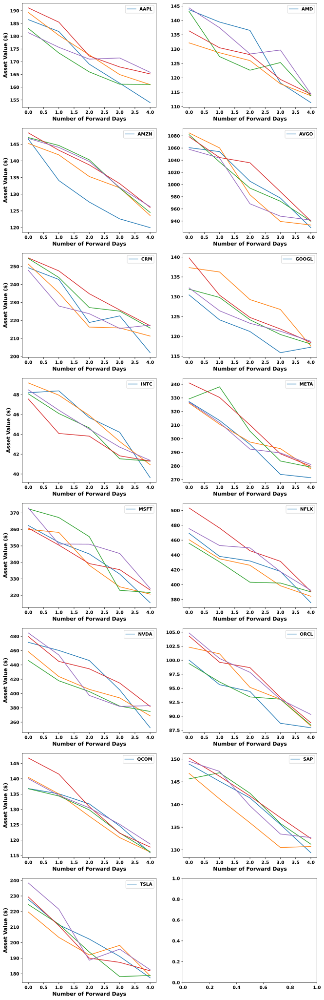

In [70]:
plot_MC_worst_scenarios(returns[tickers], n_days = 5)

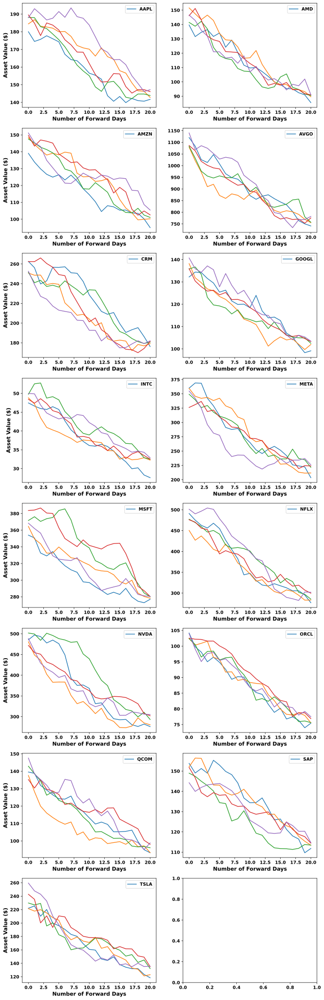

In [71]:
plot_MC_worst_scenarios(returns[tickers], n_days = 21)

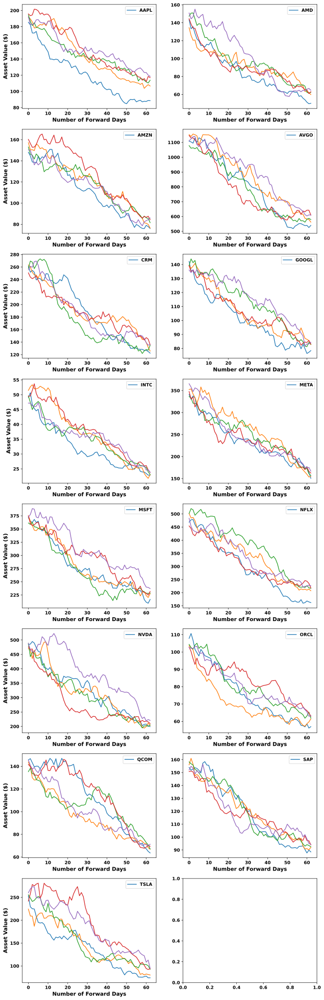

In [72]:
plot_MC_worst_scenarios(returns[tickers], n_days = 63)

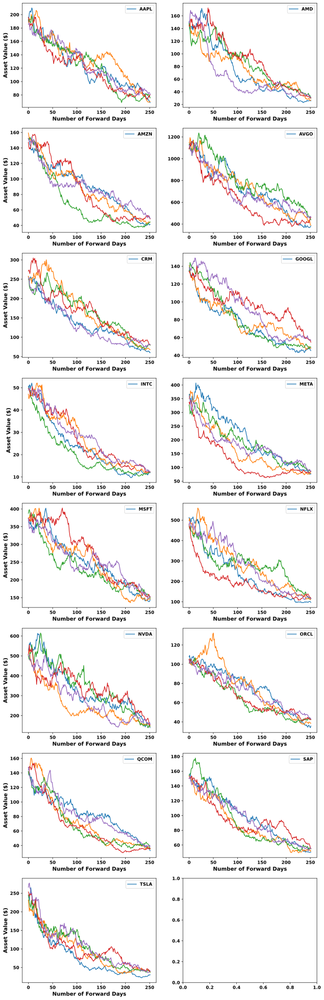

In [73]:
plot_MC_worst_scenarios(returns[tickers], n_days = 252)

### 1.14 Price Crash Risk 
<a id="subsection-114"></a>

$$
\text{Annual Down-to-Up } \sigma = \log \left(\frac{(n_u - 1) \times \sum_{t=1}^{T} min(0, \text{Weekly Return}_t)^2}{(n_d - 1) \times \sum_{t=1}^{T} max(0, \text{Weekly Return}_t)^2}\right)
$$

$$
\text{Annual Negative Coefficient of Skewness} = -\frac{n \times (n - 1)^{3/2} \times \sum_{t=1}^{T} \text{Weekly Return}_t^3}{(n - 1) \times (n - 2) \times \left(\sum_{t=1}^{T} \text{Weekly Return}_t^2\right)^{3/2}}
$$

In [74]:
def price_crash_risk(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - crash_risk_df : DataFrame displaying ratios related to the risk of price crash
    
    Function :
    --------
    - For each year, computes the down-to-up volatility and negative coefficient of skewness 
    """
    weekly_returns = returns_df.resample("W-Fri").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    ann_duvol_list = [  ]
    ann_ncskew_list = [  ]
    for asset in weekly_returns.columns :
        
        for year in weekly_returns.index.year.unique( ) :
            returns_in_year = weekly_returns[asset].loc[str(year)].copy( )
            mean_return = returns_in_year.mean( )
            
            up_returns = returns_in_year.loc[returns_in_year > mean_return]
            down_returns = returns_in_year.loc[returns_in_year < mean_return]
            
            n_weeks = len(returns_in_year)
            n_up_weeks = len(up_returns)
            n_down_weeks = len(down_returns)
            
            sum_squared_up_returns = up_returns.pow(2).sum( )
            sum_squared_down_returns = down_returns.pow(2).sum( )
            ann_duvol = np.log(((n_down_weeks - 1) * sum_squared_down_returns) / ((n_up_weeks - 1) * sum_squared_up_returns))
            ann_duvol_list.append(ann_duvol)
            
            sum_squared_returns = returns_in_year.pow(2).sum( )
            sum_cubed_returns = returns_in_year.pow(3).sum( )
            ann_ncskew = - ((n_weeks) * (n_weeks - 1)**(3/2) * sum_cubed_returns) / ((n_weeks - 1) * (n_weeks - 2) * (sum_squared_returns)**(3/2))
            ann_ncskew_list.append(ann_ncskew)
    
    multi_index = pd.MultiIndex.from_product(
        [weekly_returns.columns, weekly_returns.index.year.unique( )], names = ["Ticker", "Year"]
    )
    crash_risk_df = pd.DataFrame({
        "Down-to-Up Volatility" : ann_duvol_list, 
        "Negative Coefficient of Skewness" : ann_ncskew_list
    }, index = multi_index)
    crash_risk_df = crash_risk_df.unstack(level = "Year")
    return crash_risk_df 

In [75]:
crash_stocks = price_crash_risk(returns[tickers])

In [76]:
crash_stocks#.style\
            #.highlight_max(color = "lightgreen")

Down-to-Up Volatility                          \
Year                    2020    2021    2022    2023   
Ticker                                                 
AAPL                 -0.5048 -0.8320  0.3126 -0.6338   
AMD                  -0.8729 -0.7591  0.4526 -1.1152   
AMZN                 -0.7731 -0.0801  0.5362 -1.0363   
AVGO                 -0.2245 -1.1056  0.1974 -1.4562   
CRM                  -0.8202 -0.0666  0.5023 -1.4909   
GOOGL                -0.2778 -1.2191  0.5480 -0.7052   
INTC                 -0.0909 -0.3502  0.8002 -0.8832   
META                 -0.6025 -0.3544  0.4027 -1.6292   
MSFT                 -0.2557 -1.0028  0.3470 -1.2203   
NFLX                 -0.6441 -0.3712  0.1963 -0.5463   
NVDA                 -0.8296 -0.8827  0.4637 -1.5443   
ORCL                 -0.3147 -0.4691 -0.2824 -0.5457   
QCOM                 -0.4566 -0.9159  0.3293 -0.4929   
SAP                   0.2035 -0.1280  0.3180 -0.9790   
TSLA                 -1.1551 -0.7173  0.6082 -0.9380   

       Negative Coefficient of Skewness                          
Year                               2020    2021    2022    2023  
Ticker                                                           
AAPL                             0.0242 -1.3030  0.1176 -0.4945  
AMD                             -1.1589 -1.0244  0.2084 -1.6345  
AMZN                            -1.0457 -0.0713  0.3265 -1.4104  
AVGO                            -0.1749 -1.8414  0.2398 -2.4895  
CRM                             -1.9983  0.2389 -0.0361 -1.8365  
GOOGL                           -0.0521 -1.9637 -0.0291 -0.7789  
INTC                             0.5070 -0.3387  0.4209 -0.8736  
META                            -0.4663 -0.8032  0.4089 -2.0011  
MSFT                            -0.0799 -0.9105 -0.3815 -1.6462  
NFLX                            -0.9357 -0.5784  1.0429 -0.5172  
NVDA                            -1.2324 -0.9935 -0.0330 -1.8270  
ORCL                            -0.3359 -1.3092 -0.3029 -0.5288  
QCOM                            -0.5626 -2.5101  0.2583 -0.4397  
SAP                              1.1144 -0.1381 -0.3282 -0.8259  
TSLA                            -0.9049 -1.0167  0.3499 -1.3140

### 1.15 Liquidity Risk 
<a id="subsection-115"></a>

## 2. Construction of Portfolios 
<a id="section-2"></a>
<hr style="border: 0.25px solid black;">

In [77]:
def monthly_weights_rebalancing(weights_df) :
    """
    Arguments :
    ---------
    - weights_df : DataFrame of weights of each asset at each timestamp 
    
    Returns :
    -------
    - daily_weights : DataFrame of daily weights of each asset  
        
    Function :
    --------
    - Sets the daily weights of each asset in each month equal to the weights of that month's first day 
    """
    daily_weights = weights_df.copy( ) 
    daily_weights["Year"] = daily_weights.index.year 
    daily_weights["Month"] = daily_weights.index.month 
    daily_weights = daily_weights.reset_index( )
    
    month_start_weights = daily_weights.groupby(["Year", "Month"]).first( ).reset_index(drop = True)
    daily_weights.set_index("Date", inplace = True)
    daily_weights.drop(columns = ["Year", "Month"], inplace = True)
    month_start_weights.set_index("Date", inplace = True)
    
    daily_weights.loc[~ (daily_weights.index.isin(month_start_weights.index)) ] = np.nan 
    daily_weights.ffill(inplace = True)  
    return daily_weights 

In [78]:
def plot_weights_returns(weights_df, returns_df, benchmarks = ["^GSPC", "^NDXT", "IXN"]) :
    """
    Arguments :
    ---------
    - weights_df : DataFrame of weights of each asset at each timestamp 
    - returns_df : DataFrame of daily returns 
    - benchmarks : list of str representing the benchmarks' tickers 
    
    Returns :
    -------
    - None 
        
    Function :
    --------
    - Plots cumulative returns of the portfolio and benchmark indices 
    - Plots the annualized 3-month and 6-month rolling volatility of the portfolio 
    - Plots the weights of each asset over time -> price-weighted / market-value-weighted 
    - Plots the fixed weights of each asset -> equally-weighted / minimum variance / maximum sharpe 
    """
    fig , ax = plt.subplots(figsize = (12 , 24), sharex = False, sharey = False, nrows = 3, ncols = 1)
    
    for benchmark in benchmarks :
        compare = yf.download(tickers = benchmark, start = start_date, end = end_date)
        close_compare = compare["Adj Close"].copy( ) 
        returns_compare = close_compare.pct_change(periods = 1).iloc[1:] 
        returns_df[benchmark] = returns_compare
    
    cum_returns = (1 + returns_df).cumprod( ) - 1 
    cum_returns.mul(100).plot(fontsize = 10, ax = ax[0])
    ax[0].set_xlabel(xlabel = "")
    ax[0].set_ylabel(ylabel = "Cumulative Returns (%)", fontsize = 12) 
    returns_df.drop(columns = benchmarks, inplace = True)
    
    monthly_returns = returns_df.resample("BM").agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)
    portf = monthly_returns.columns[0]
    monthly_returns["3 Months"] = monthly_returns[portf].rolling(3).std( ) * np.sqrt(12)
    monthly_returns["6 Months"] = monthly_returns[portf].rolling(6).std( ) * np.sqrt(12)
    
    ax[1].plot(monthly_returns["3 Months"] * 100, label = "3 Months", c = "red")
    ax[1].plot(monthly_returns["6 Months"] * 100, label = "6 Months", c = "fuchsia")
    ax[1].set_xlabel("")
    ax[1].set_ylabel("Annualized Rolling Volatility (%)", fontsize = 12)
    ax[1].legend( )
    
    if portf == "EWP" or portf == "KP" or "MVP" in portf or "MSP" in portf :
        weights_series = weights_df.iloc[0]
        weights_series.name = "Weights"
        
        contains_zero = weights_series.round(8).isin([0]).any( )
        if contains_zero : 
            weights_series = weights_series.loc[weights_series.round(8) != 0]
            
        colors = sns.color_palette("Set3")
        ax[2].pie(
            weights_series, 
            labels = weights_series.index, 
            colors = colors, 
            autopct = "%.2f%%", 
            radius = 1.2
        )
        
    else :
        colors = sns.color_palette("tab20") 
        for i, asset in enumerate(weights_df.columns) :
            ax[2].plot(weights_df[asset].mul(100), color = colors[i], label = asset)

        ax[2].set_xlabel("")
        ax[2].set_ylabel("Monthly Weights (%)", fontsize = 12)
        ax[2].legend(loc = "upper left", bbox_to_anchor = (0, -0.1), fontsize = 10, title = "Assets")
    
    plt.style.use("default")
    plt.show( )  

### 2.1 Price-Weighted Portfolio (Monthly Rebalancing) 
<a id="subsection-21"></a>

$$
\text{Weight}_t = \frac{\text{Price}_t}{\sum_{i=1}^{N} \text{Price}_{i,t}}
$$ 

$$
\text{PWP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [79]:
def price_weighted_portf(adj_close_df, returns_df) :
    """
    Arguments :
    ---------
    - adj_close_df : DataFrame of daily adjusted closing prices 
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - weights_pwp : DataFrame of daily weights for the price-weighted portfolio
    - returns_pwp : DataFrame of daily weights for the price-weighted portfolio
        
    Function :
    --------
    """
    weights_pwp = monthly_weights_rebalancing(adj_close_df.div(adj_close_df.sum(axis = 1), axis = 0))
    returns_pwp = returns_df.mul(weights_pwp).sum(axis = 1)  
    return weights_pwp, returns_pwp

In [80]:
weights_PWP = price_weighted_portf(adj_close_tech, returns[tickers])[0]
returns["PWP"] = price_weighted_portf(adj_close_tech, returns[tickers])[1]

In [81]:
summary_PWP = risk_return(returns["PWP"].to_frame( )) 

best_worst_PWP = best_worst_returns(returns["PWP"].to_frame( ))

win_percent_PWP = win_percentage(returns["PWP"].to_frame( ))

win_loss_PWP = win_loss_ratios(returns["PWP"].to_frame( )) 

win_lose_streak_PWP = streak(returns["PWP"].to_frame( ))

dist_attributes_PWP = distribution_attributes(returns["PWP"].to_frame( ))

downside_PWP = downside(returns["PWP"].to_frame( )) 

tail_PWP = tail_attributes(returns["PWP"].to_frame( ), threshold = 0.05)

VaR_PWP = Value_at_Risk(returns["PWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


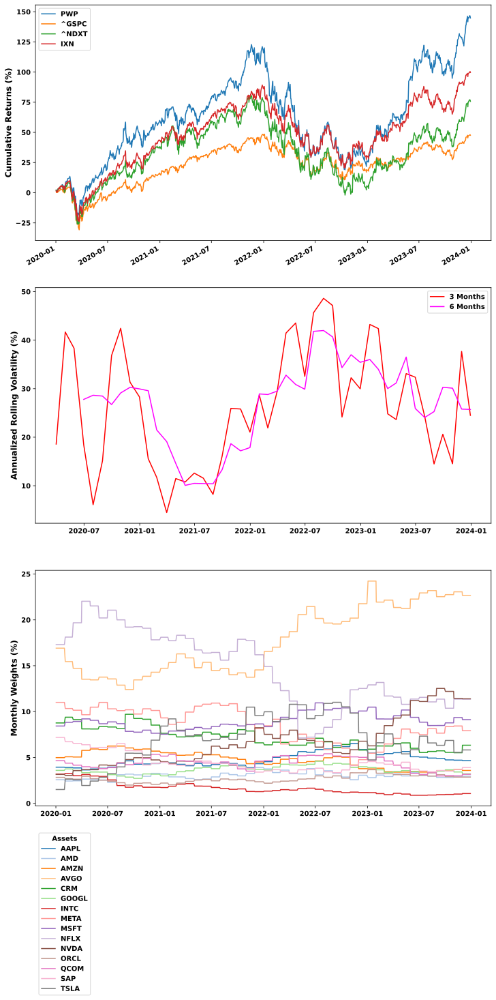

In [82]:
plot_weights_returns(weights_PWP, returns["PWP"].to_frame( )) 

### 2.2 Equally-Weighted Portfolio 
<a id="subsection-22"></a>

$$
\text{W}_t = \frac{1}{N}
$$ 

$$
\text{EWP Return}_t = \frac{1}{N} \times \sum_{i=1}^{N} \text{Return}_{i,t}
$$ 

In [83]:
def equal_weighted_portf(adj_close_df, returns_df) :
    """
    Arguments :
    ---------
    - adj_close_df : DataFrame of daily adjusted closing prices 
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - weights_ewp : DataFrame of daily weights for the equally-weighted portfolio
    - returns_ewp : DataFrame of daily returns for the equally-weighted portfolio 
        
    Function :
    --------
    """
    weights_ewp = pd.DataFrame(
        np.full_like(returns_df.values, 1 / returns_df.shape[1]), 
        columns = returns_df.columns, 
        index = returns_df.index
    )
    returns_ewp = returns_df.mul(weights_ewp).sum(axis = 1)  
    return weights_ewp, returns_ewp

In [84]:
weights_EWP = equal_weighted_portf(adj_close_tech, returns[tickers])[0]
returns["EWP"] = equal_weighted_portf(adj_close_tech, returns[tickers])[1]

In [85]:
summary_EWP = risk_return(returns["EWP"].to_frame( ))

best_worst_EWP = best_worst_returns(returns["EWP"].to_frame( ))

win_percent_EWP = win_percentage(returns["EWP"].to_frame( )) 

win_loss_EWP = win_loss_ratios(returns["EWP"].to_frame( )) 

win_lose_streak_EWP = streak(returns["EWP"].to_frame( ))

dist_attributes_EWP = distribution_attributes(returns["EWP"].to_frame( ))

downside_EWP = downside(returns["EWP"].to_frame( )) 

tail_EWP = tail_attributes(returns["EWP"].to_frame( ), threshold = 0.05)

VaR_EWP = Value_at_Risk(returns["EWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


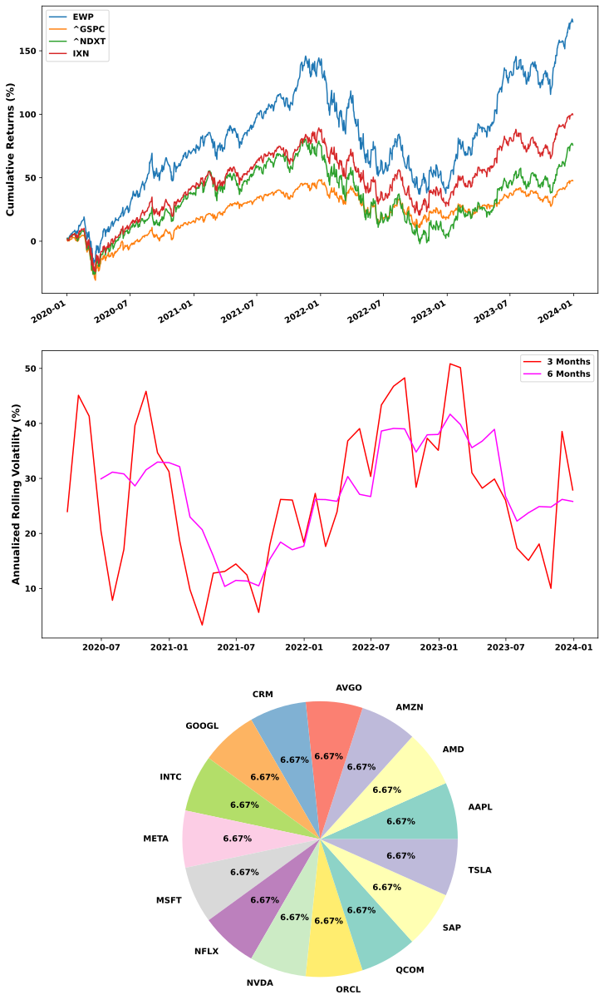

In [86]:
plot_weights_returns(weights_EWP, returns["EWP"].to_frame( ))

### 2.3 Market-Value-Weighted Portfolio (Monthly Rebalancing) 
<a id="subsection-23"></a>

$$
\text{Weight}_t = \frac{\text{Price}_t \times \text{Shares Oustanding}_t}{\sum_{i=1}^{N} \text{Price}_{i,t} \times \text{Shares Outstanding}_{i,t}}
$$ 

$$
\text{MVWP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [87]:
def mktcap_weighted_portf(close_df, shares_outstd_df, returns_df) :
    """
    Arguments :
    ---------
    - close_df : DataFrame of daily closing prices 
    - shares_outstd_df : DataFrame of daily market capitalizations 
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - weights_mvwp : DataFrame of daily weights for the market-value-weighted portfolio
    - returns_mvwp : DataFrame of daily returns for the market-value-weighted portfolio 
        
    Function :
    --------
    """
    mktcap = shares_outstd_df.mul(close_df) 
    total_mktcap = mktcap.sum(axis = 1)
    
    weights_mvwp = monthly_weights_rebalancing(mktcap.div(total_mktcap, axis = 0)) 
    returns_mvwp = returns_df.mul(weights_mvwp).sum(axis = 1) 
    return weights_mvwp, returns_mvwp

In [88]:
weights_MVWP = mktcap_weighted_portf(close_tech.iloc[1:], shares_outstd_tech.iloc[1:], returns[tickers])[0]
returns["MVWP"] = mktcap_weighted_portf(close_tech.iloc[1:], shares_outstd_tech.iloc[1:], returns[tickers])[1]

In [89]:
summary_MVWP = risk_return(returns["MVWP"].to_frame( ))

best_worst_MVWP = best_worst_returns(returns["MVWP"].to_frame( ))

win_percent_MVWP = win_percentage(returns["MVWP"].to_frame( )) 

win_loss_MVWP = win_loss_ratios(returns["MVWP"].to_frame( )) 

win_lose_streak_MVWP = streak(returns["MVWP"].to_frame( ))

dist_attributes_MVWP = distribution_attributes(returns["MVWP"].to_frame( ))

downside_MVWP = downside(returns["MVWP"].to_frame( )) 

tail_MVWP = tail_attributes(returns["MVWP"].to_frame( ), threshold = 0.05)

VaR_MVWP = Value_at_Risk(returns["MVWP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


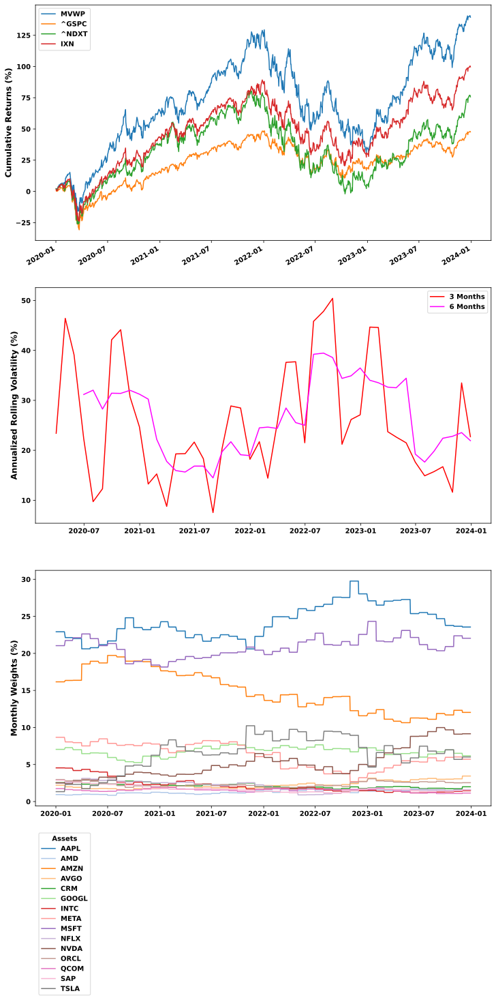

In [90]:
plot_weights_returns(weights_MVWP, returns["MVWP"].to_frame( )) 

### 2.4 Inverse Volatility Portfolio (Monthly Rebalancing) 
<a id="subsection-24"></a>

$$
\text{Weight}_t = \frac{\frac{1}{\sigma_t}}{\sum_{i=1}^{N} \frac{1}{\sigma_{i, t}}}
$$ 

$$
\text{IVP Return}_t = \sum_{i=1}^{N} \text{Return}_{i,t} \times \text{Weight}_{i,t}
$$ 

In [91]:
def inverse_vol_portf(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - weights_ivp : DataFrame of daily weights for the inverse volatility portfolio
    - returns_ivp : DataFrame of daily returns for the inverse volatility portfolio 
        
    Function :
    --------
    """
    rolling_vol = returns_df.rolling(window = 21).std( )
    inverse_vol = 1 / rolling_vol
    
    weights_ivp = monthly_weights_rebalancing(inverse_vol.div(inverse_vol.sum(axis = 1), axis = 0)) 
    returns_ivp = returns_df.mul(weights_ivp).sum(axis = 1) 
    return weights_ivp, returns_ivp

In [92]:
weights_IVP = inverse_vol_portf(returns[tickers])[0]
returns["IVP"] = inverse_vol_portf(returns[tickers])[1]

In [93]:
summary_IVP = risk_return(returns["IVP"].to_frame( ))

best_worst_IVP = best_worst_returns(returns["IVP"].to_frame( ))

win_percent_IVP = win_percentage(returns["IVP"].to_frame( )) 

win_loss_IVP = win_loss_ratios(returns["IVP"].to_frame( )) 

win_lose_streak_IVP = streak(returns["IVP"].to_frame( ))

dist_attributes_IVP = distribution_attributes(returns["IVP"].to_frame( ))

downside_IVP = downside(returns["IVP"].to_frame( )) 

tail_IVP = tail_attributes(returns["IVP"].to_frame( ), threshold = 0.05)

VaR_IVP = Value_at_Risk(returns["IVP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


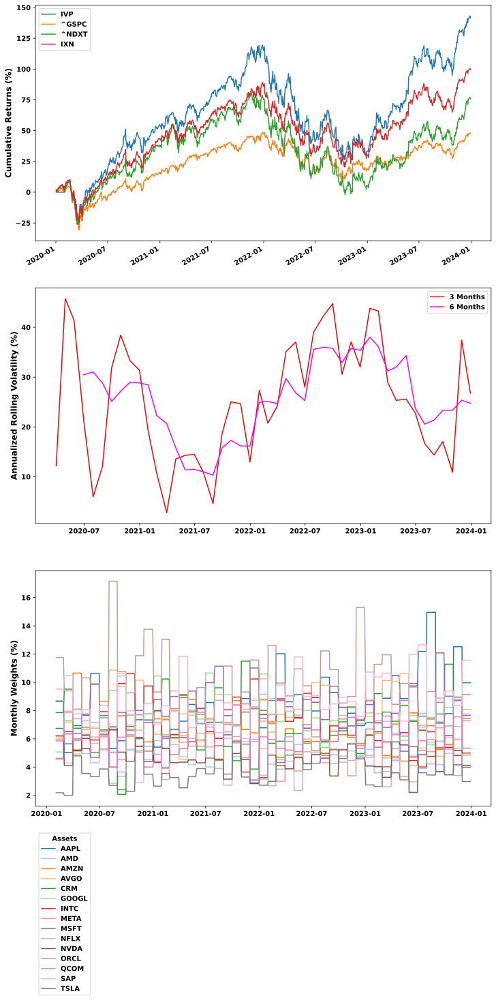

In [94]:
plot_weights_returns(weights_IVP, returns["IVP"].to_frame( )) 

### 2.5 Kelly Bet Portfolio
<a id="subsection-25"></a>

In [95]:
def kelly_bet_portf(returns_df) :
    """
    Arguments :
    ---------
    - returns_df : DataFrame of daily returns 
    
    Returns :
    -------
    - weights_kp : DataFrame of daily weights for the Kelly portfolio
    - returns_kp : DataFrame of daily returns for the Kelly portfolio 
        
    Function :
    --------
    """
    ann_returns = returns_df.mean( ) * 252
    ann_cov_mat = returns_df.cov( ) * 252 
    
    precision_matrix = pd.DataFrame(np.linalg.inv(ann_cov_mat), index = returns_df.columns, columns = returns_df.columns)
    bet_sizes = precision_matrix.dot(ann_returns).apply(lambda x: 0 if x < 0 else x) 
    
    weights_kp = (bet_sizes / bet_sizes.sum( )).values
    weights_kp = pd.DataFrame(np.tile(weights_kp, (len(returns_df), 1)), columns = returns_df.columns, index = returns_df.index)
    returns_kp = returns_df.mul(weights_kp).sum(axis = 1) 
    return weights_kp, returns_kp

In [96]:
weights_KP = kelly_bet_portf(returns[tickers])[0]
returns["KP"] = kelly_bet_portf(returns[tickers])[1]

In [97]:
summary_KP = risk_return(returns["KP"].to_frame( ))

best_worst_KP = best_worst_returns(returns["KP"].to_frame( ))

win_percent_KP = win_percentage(returns["KP"].to_frame( ))  

win_loss_KP = win_loss_ratios(returns["KP"].to_frame( )) 

win_lose_streak_KP = streak(returns["KP"].to_frame( ))

dist_attributes_KP = distribution_attributes(returns["KP"].to_frame( ))

downside_KP = downside(returns["KP"].to_frame( ))  

tail_KP = tail_attributes(returns["KP"].to_frame( ), threshold = 0.05)

VaR_KP = Value_at_Risk(returns["KP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


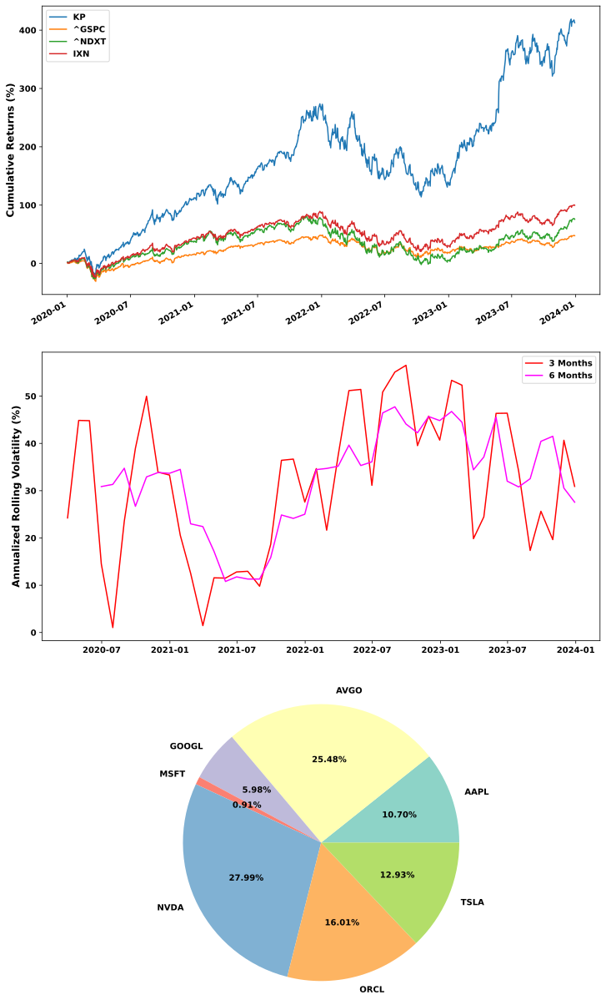

In [98]:
plot_weights_returns(weights_KP, returns["KP"].to_frame( ))

### 2.6 Global Minimum (Annualized) Variance Portfolio 
<a id="subsection-26"></a>

In [99]:
num_portfs = 10_000  
rand_portfs_weights = np.random.random(num_portfs * len(tickers)).reshape(num_portfs, len(tickers))

sum_weights = rand_portfs_weights.sum(axis = 1, keepdims = True)
rand_portfs_weights = rand_portfs_weights / sum_weights

In [100]:
rand_portfs_returns = returns[tickers].dot(rand_portfs_weights.transpose( ))
rand_portfs_summary = risk_return(rand_portfs_returns)

In [101]:
weights_MVP = rand_portfs_weights[rand_portfs_summary[("Annual",  "Volatility")].pow(2).idxmin( )]
weights_MVP = pd.DataFrame(np.tile(weights_MVP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)
returns["MVP"] = rand_portfs_returns[rand_portfs_summary[("Annual",  "Volatility")].pow(2).idxmin( )]

In [102]:
summary_MVP = risk_return(returns["MVP"].to_frame( ))

best_worst_MVP = best_worst_returns(returns["MVP"].to_frame( ))

win_percent_MVP = win_percentage(returns["MVP"].to_frame( ))  

win_loss_MVP = win_loss_ratios(returns["MVP"].to_frame( )) 

win_lose_streak_MVP = streak(returns["MVP"].to_frame( ))

dist_attributes_MVP = distribution_attributes(returns["MVP"].to_frame( ))

downside_MVP = downside(returns["MVP"].to_frame( ))  

tail_MVP = tail_attributes(returns["MVP"].to_frame( ), threshold = 0.05)

VaR_MVP = Value_at_Risk(returns["MVP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


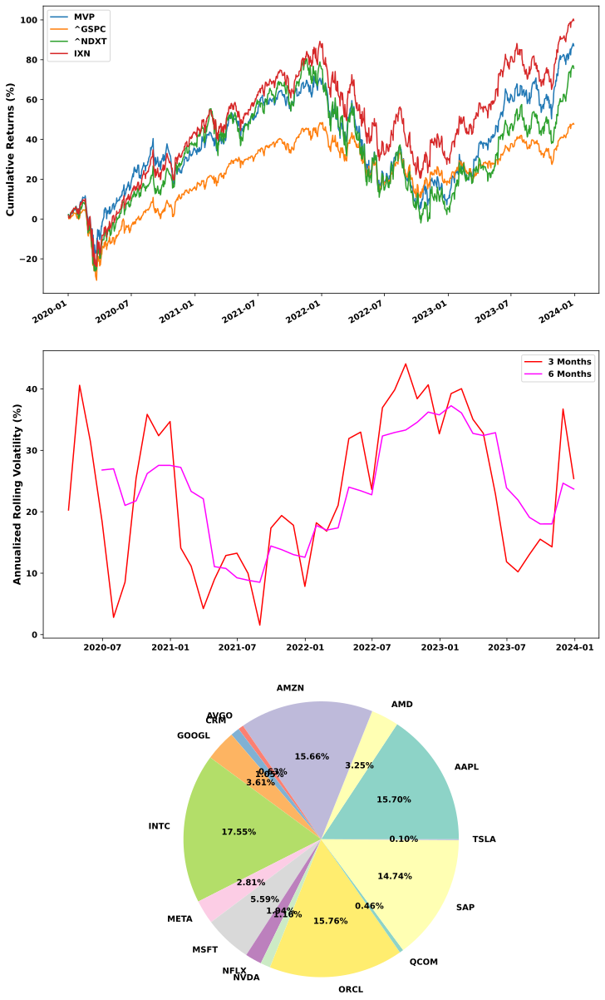

In [103]:
plot_weights_returns(weights_MVP, returns["MVP"].to_frame( ))

### 2.7 Maximum (Annualized) Sharpe Portfolio 
<a id="subsection-27"></a>

In [104]:
weights_MSP = rand_portfs_weights[rand_portfs_summary[("Annual", "Sharpe")].idxmax( )]
weights_MSP = pd.DataFrame(np.tile(weights_MSP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)
returns["MSP"] = rand_portfs_returns[rand_portfs_summary[("Annual", "Sharpe")].idxmax( )]  

In [105]:
summary_MSP = risk_return(returns["MSP"].to_frame( )) 

best_worst_MSP = best_worst_returns(returns["MSP"].to_frame( )) 

win_percent_MSP = win_percentage(returns["MSP"].to_frame( ))  

win_loss_MSP = win_loss_ratios(returns["MSP"].to_frame( )) 

win_lose_streak_MSP = streak(returns["MSP"].to_frame( ))

dist_attributes_MSP = distribution_attributes(returns["MSP"].to_frame( ))

downside_MSP = downside(returns["MSP"].to_frame( ))  

tail_MSP = tail_attributes(returns["MSP"].to_frame( ), threshold = 0.05)

VaR_MSP = Value_at_Risk(returns["MSP"].to_frame( ))

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


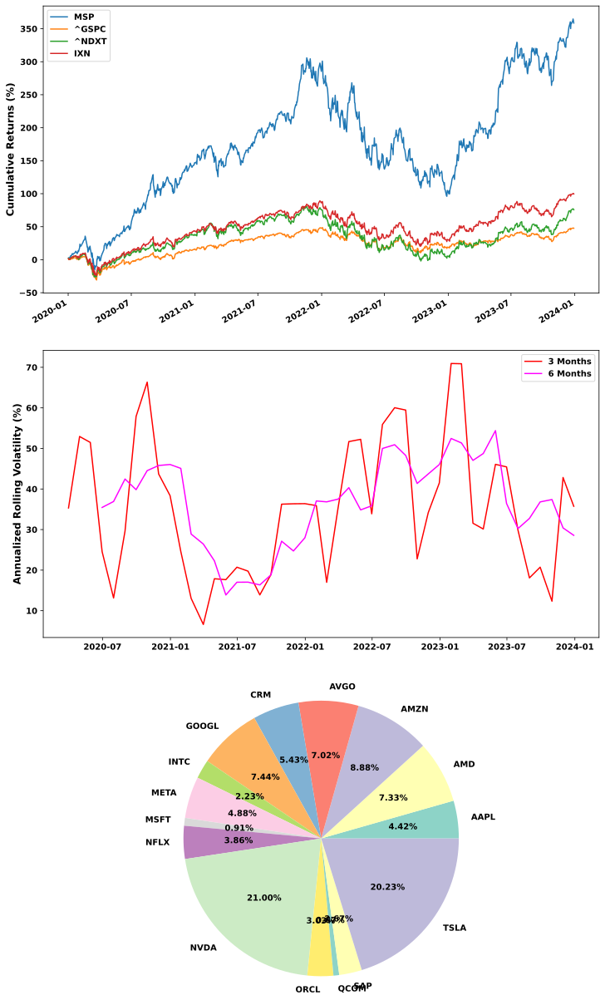

In [106]:
plot_weights_returns(weights_MSP, returns["MSP"].to_frame( ))

### 2.8 Variance Minimization (Quadratic Programming)
<a id="subsection-28"></a>

$$ \text{Minimize}: w^T \Sigma w $$ 

$$ \text{Subject to}: w^T \mathbf{1} = 1 $$
$$ w \geq 0$$ 

In [107]:
def portf_variance(weights, returns_df) :
    ann_cov_mat = returns_df.cov( )  * 252 
    portf_var = np.dot(weights.T, np.dot(ann_cov_mat, weights)) 
    return portf_var 

In [108]:
def optimize_metric(returns_df, metric_func) :
    ann_cov_mat = returns_df.cov( )  * 252 
    constraints = ({"type" : "eq", "fun" : lambda weights: np.sum(weights) - 1})
    bounds = tuple((0, 1) for asset in range(len(ann_cov_mat)))
    initial_weights = np.ones(len(ann_cov_mat)) / len(ann_cov_mat)
    
    result = optimize.minimize(
        metric_func, 
        initial_weights, 
        args = (returns_df,), 
        method = "SLSQP", 
        bounds = bounds, 
        constraints = constraints
    )
    optimized_weights = result.x
    return optimized_weights 

In [109]:
qp_weights_MVP = optimize_metric(returns[tickers], portf_variance) 
qp_weights_MVP = pd.DataFrame(np.tile(qp_weights_MVP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)

qp_returns_MVP = returns[tickers].mul(qp_weights_MVP).sum(axis = 1)
qp_returns_MVP = pd.DataFrame(data = qp_returns_MVP, columns = ["QP_MVP"])

In [110]:
summary_qp_MVP = risk_return(qp_returns_MVP["QP_MVP"].to_frame( )) 
MVP_comparison = pd.concat(axis = 0, objs = [summary_MVP, summary_qp_MVP])

In [111]:
MVP_comparison

Daily                   Weekly                   Monthly             \
       Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
MVP    0.0008     0.0178 0.0438 0.0039     0.0399 0.0980  0.0164     0.0817   
QP_MVP 0.0008     0.0167 0.0450 0.0038     0.0373 0.1007  0.0158     0.0764   

              Quarterly                   Annual                    
       Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
MVP    0.2009    0.0492     0.1415 0.3480 0.1969     0.2829 0.6959  
QP_MVP 0.2064    0.0473     0.1324 0.3575 0.1893     0.2647 0.7150

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


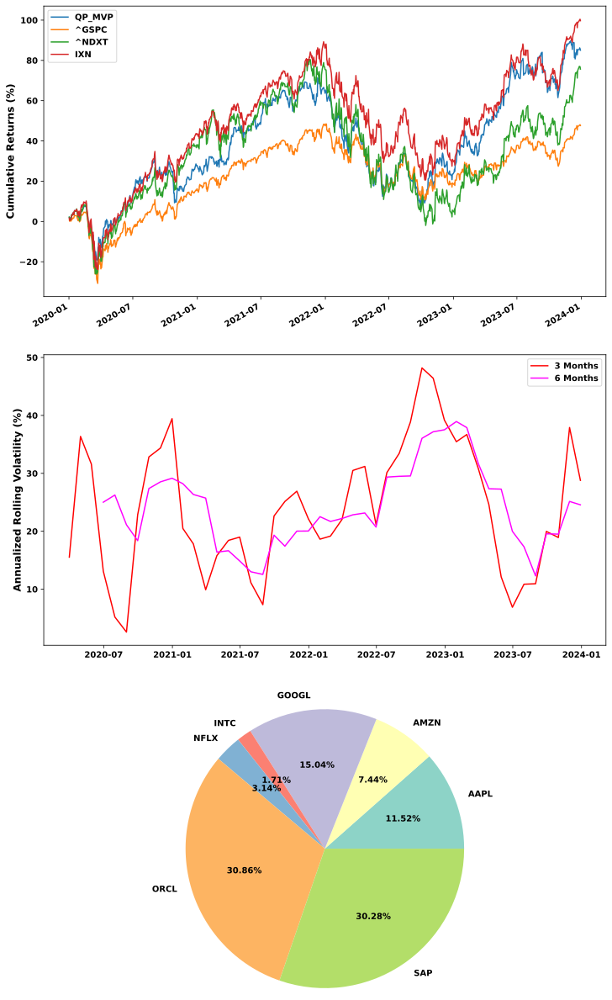

In [112]:
plot_weights_returns(qp_weights_MVP, qp_returns_MVP["QP_MVP"].to_frame( ))

### 2.9 Sharpe Maximization (Quadratic Programming)
<a id="subsection-29"></a>

In [113]:
def portf_sharpe(weights, returns_df) :
    ann_returns = returns_df.mean( ) * 252 
    ann_cov_mat = returns_df.cov( )  * 252 
    
    portf_return = np.sum(weights * ann_returns)
    portf_std = np.sqrt(np.dot(weights.T, np.dot(ann_cov_mat, weights)))
    portf_sharpe = (portf_return - rf_rate) / portf_std
    return - portf_sharpe 

In [114]:
qp_weights_MSP = optimize_metric(returns[tickers], portf_sharpe) 
qp_weights_MSP = pd.DataFrame(np.tile(qp_weights_MSP, (len(returns[tickers]), 1)), columns = tickers, index = returns.index)

qp_returns_MSP = returns[tickers].mul(qp_weights_MSP).sum(axis = 1)
qp_returns_MSP = pd.DataFrame(data = qp_returns_MSP, columns = ["QP_MSP"])

In [115]:
summary_qp_MSP = risk_return(qp_returns_MSP["QP_MSP"].to_frame( )) 
MSP_comparison = pd.concat(axis = 0, objs = [summary_MSP, summary_qp_MSP])

In [116]:
MSP_comparison

Daily                   Weekly                   Monthly             \
       Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
MSP    0.0018     0.0239 0.0754 0.0090     0.0535 0.1685  0.0378     0.1096   
QP_MSP 0.0027     0.0308 0.0872 0.0134     0.0688 0.1950  0.0564     0.1411   

              Quarterly                   Annual                    
       Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
MSP    0.3453    0.1135     0.1898 0.5981 0.4542     0.3797 1.1962  
QP_MSP 0.3997    0.1692     0.2444 0.6922 0.6767     0.4888 1.3845

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


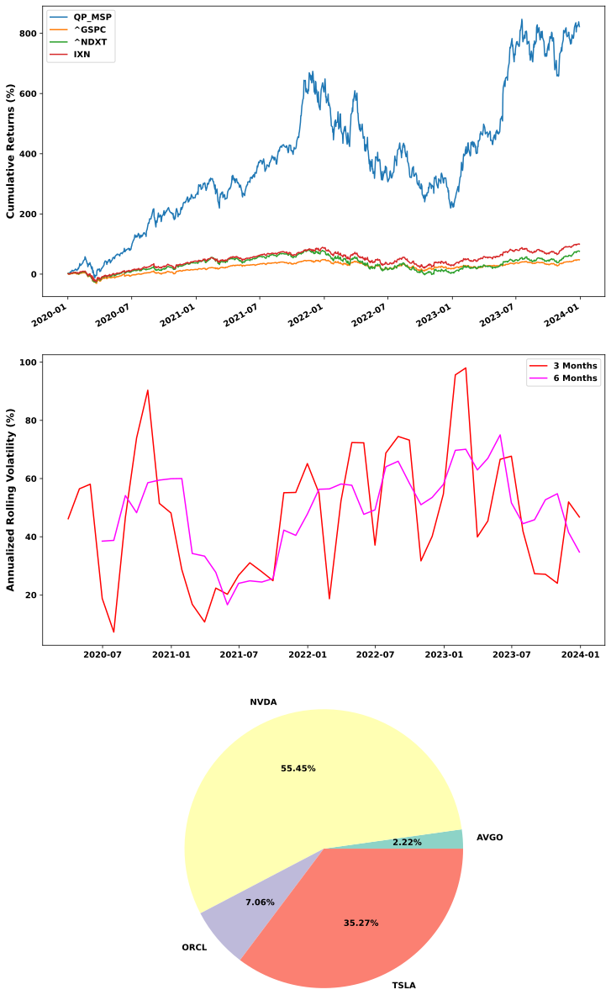

In [117]:
plot_weights_returns(qp_weights_MSP, qp_returns_MSP["QP_MSP"].to_frame( ))

### 2.10 Portfolio Comparison : Performance against Benchmark 
<a id="subsection-210"></a>

In [118]:
sp500 = yf.download(tickers = "^GSPC", start = start_date, end = end_date)
returns["MP"] = sp500["Close"].pct_change(periods = 1).dropna( ) 

[*********************100%%**********************]  1 of 1 completed


In [119]:
summary_MP = risk_return(returns["MP"].to_frame( )) 

best_worst_MP = best_worst_returns(returns["MP"].to_frame( )) 

win_percent_MP = win_percentage(returns["MP"].to_frame( ))  

win_loss_MP = win_loss_ratios(returns["MP"].to_frame( )) 

win_lose_streak_MP = streak(returns["MP"].to_frame( ))

dist_attributes_MP = distribution_attributes(returns["MP"].to_frame( ))

downside_MP = downside(returns["MP"].to_frame( ))  

tail_MP = tail_attributes(returns["MP"].to_frame( ), threshold = 0.05)

VaR_MP = Value_at_Risk(returns["MP"].to_frame( ))

In [120]:
portfs = ["PWP", "EWP", "MVWP", "IVP", "KP", "MVP", "MSP"]

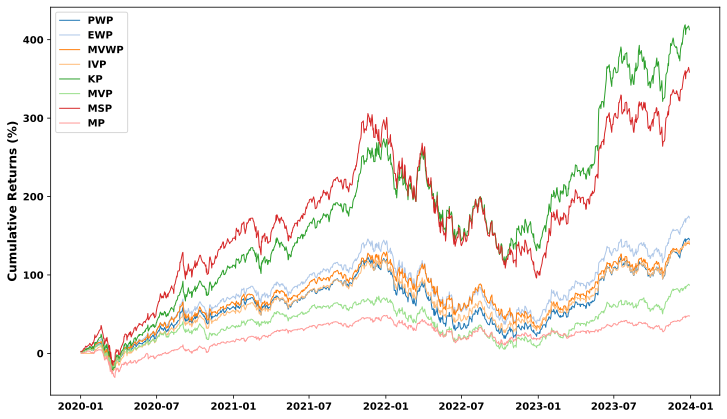

In [121]:
plot_cum_returns(returns[portfs + ["MP"]])

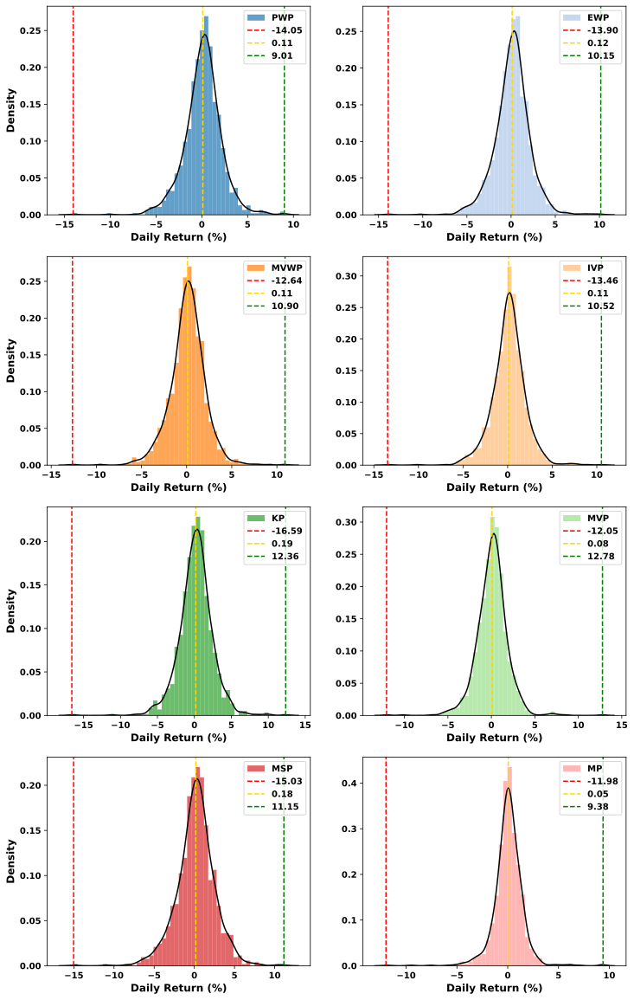

In [122]:
plot_histogram(returns[portfs + ["MP"]])

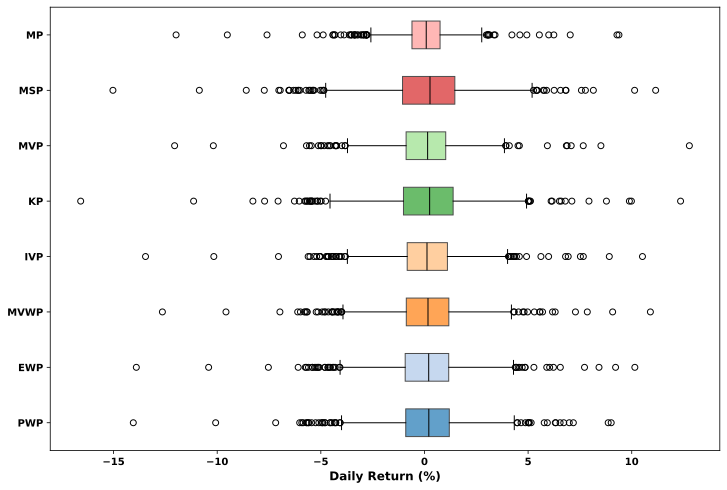

In [123]:
plot_box_whisker(returns[portfs + ["MP"]])  

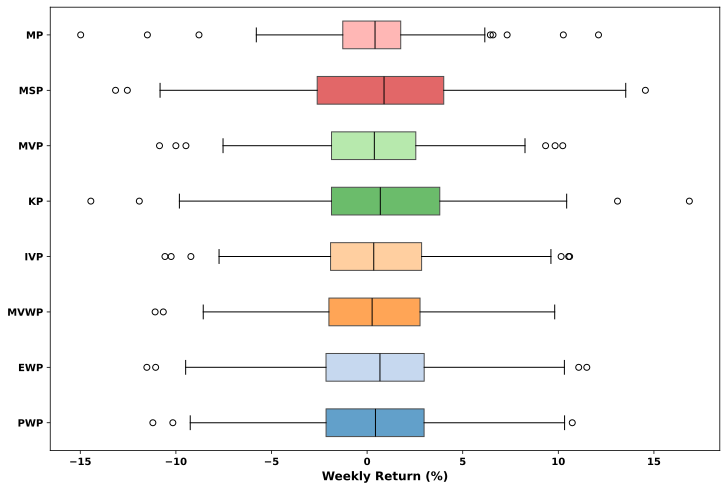

In [124]:
plot_box_whisker(returns[portfs + ["MP"]], "weekly")  

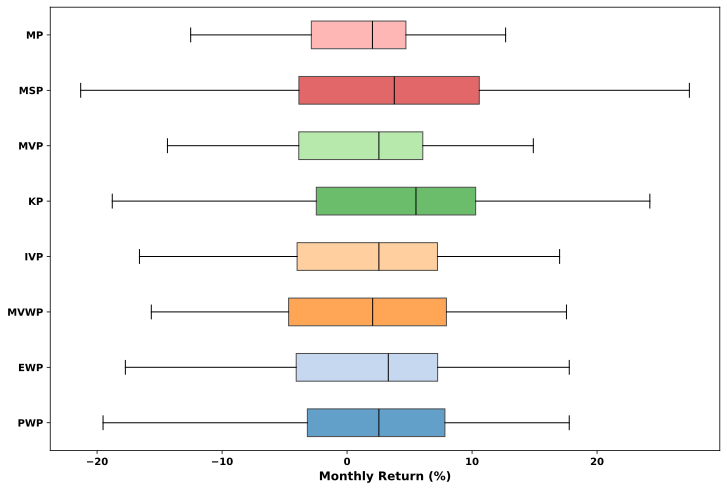

In [125]:
plot_box_whisker(returns[portfs + ["MP"]], "monthly")  

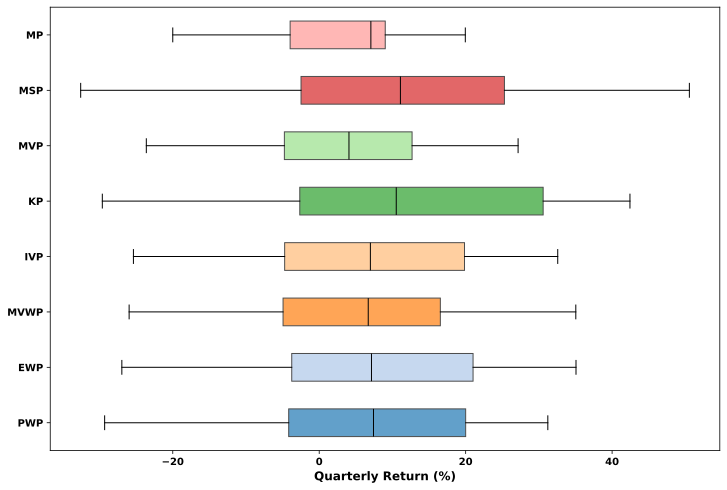

In [126]:
plot_box_whisker(returns[portfs + ["MP"]], "quarterly")  

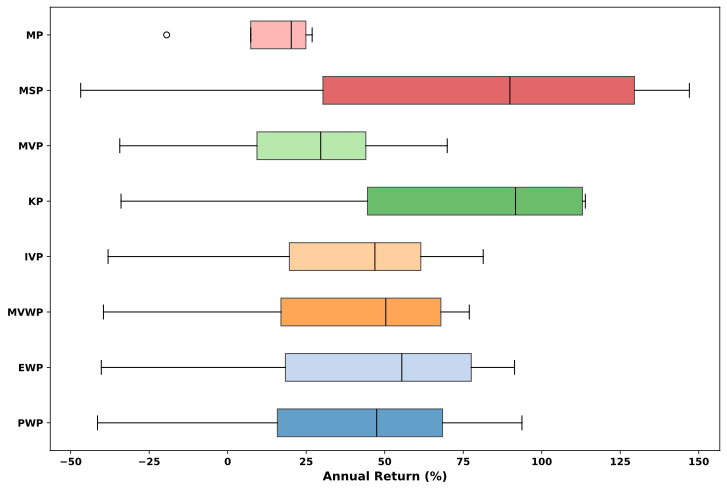

In [127]:
plot_box_whisker(returns[portfs + ["MP"]], "annual")  

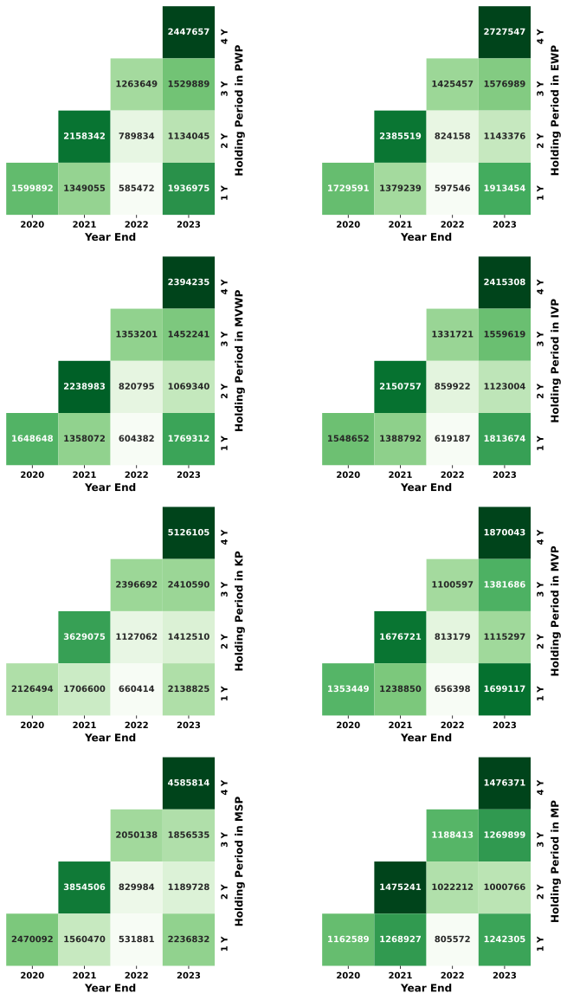

In [128]:
plot_dollar_triangle(returns[portfs + ["MP"]])

In [129]:
summary_portfs = pd.concat([
    summary_PWP, 
    summary_EWP, 
    summary_MVWP, 
    summary_IVP, 
    summary_KP, 
    summary_MVP, 
    summary_MSP, 
    summary_MP
])

best_worst_portfs = pd.concat([
    best_worst_PWP, 
    best_worst_EWP, 
    best_worst_MVWP, 
    best_worst_IVP, 
    best_worst_KP, 
    best_worst_MVP, 
    best_worst_MSP,
    best_worst_MP
])

win_percent_portfs = pd.concat([
    win_percent_PWP, 
    win_percent_EWP, 
    win_percent_MVWP, 
    win_percent_IVP, 
    win_percent_KP, 
    win_percent_MVP, 
    win_percent_MSP,
    win_percent_MP
])

win_loss_portfs = pd.concat([
    win_loss_PWP, 
    win_loss_EWP, 
    win_loss_MVWP, 
    win_loss_IVP, 
    win_loss_KP, 
    win_loss_MVP, 
    win_loss_MSP,
    win_loss_MP
])

win_lose_streak_portfs = pd.concat([
    win_lose_streak_PWP, 
    win_lose_streak_EWP, 
    win_lose_streak_MVWP, 
    win_lose_streak_IVP, 
    win_lose_streak_KP, 
    win_lose_streak_MVP, 
    win_lose_streak_MSP,
    win_lose_streak_MP
])

dist_attributes_portfs = pd.concat([
    dist_attributes_PWP, 
    dist_attributes_EWP, 
    dist_attributes_MVWP, 
    dist_attributes_IVP, 
    dist_attributes_KP, 
    dist_attributes_MVP, 
    dist_attributes_MSP,
    dist_attributes_MP
])

downside_portfs = pd.concat([
    downside_PWP, 
    downside_EWP, 
    downside_MVWP, 
    downside_IVP, 
    downside_KP, 
    downside_MVP, 
    downside_MSP, 
    downside_MP
]) 

tail_portfs = pd.concat([
    tail_PWP, 
    tail_EWP, 
    tail_MVWP, 
    tail_IVP, 
    tail_KP, 
    tail_MVP, 
    tail_MSP,
    tail_MP
]) 

VaR_portfs = pd.concat([
    VaR_PWP, 
    VaR_EWP, 
    VaR_MVWP, 
    VaR_IVP, 
    VaR_KP, 
    VaR_MVP, 
    VaR_MSP,
    VaR_MP
]) 

In [130]:
summary_portfs#.style\
              #.highlight_max(color = "lightgreen")\
              #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
     Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
PWP  0.0011     0.0203 0.0540 0.0055     0.0455 0.1207  0.0231     0.0932   
EWP  0.0012     0.0201 0.0598 0.0060     0.0449 0.1337  0.0252     0.0920   
MVWP 0.0011     0.0196 0.0541 0.0053     0.0439 0.1209  0.0223     0.0899   
IVP  0.0011     0.0189 0.0558 0.0053     0.0423 0.1249  0.0222     0.0867   
KP   0.0019     0.0228 0.0828 0.0094     0.0510 0.1851  0.0396     0.1045   
MVP  0.0008     0.0178 0.0438 0.0039     0.0399 0.0980  0.0164     0.0817   
MSP  0.0018     0.0239 0.0754 0.0090     0.0535 0.1685  0.0378     0.1096   
MP   0.0005     0.0145 0.0340 0.0025     0.0324 0.0760  0.0103     0.0664   

            Quarterly                   Annual                    
     Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
PWP  0.2473    0.0692     0.1615 0.4284 0.2767     0.3230 0.8568  
EWP  0.2740    0.0756     0.1593 0.4747 0.3024     0.3186 0.9493  
MVWP 0.2478    0.0669     0.1558 0.4292 0.2674     0.3116 0.8584  
IVP  0.2559    0.0666     0.1501 0.4433 0.2662     0.3003 0.8866  
KP   0.3793    0.1189     0.1809 0.6569 0.4755     0.3619 1.3139  
MVP  0.2009    0.0492     0.1415 0.3480 0.1969     0.2829 0.6959  
MSP  0.3453    0.1135     0.1898 0.5981 0.4542     0.3797 1.1962  
MP   0.1558    0.0310     0.1150 0.2699 0.1242     0.2301 0.5399

In [131]:
best_worst_portfs#.style\
                 #.highlight_max(color = "lightgreen")\
                 #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
     Best Return Worst Return Best Return Worst Return Best Return   
PWP       0.0901      -0.1405      0.1073      -0.1120      0.1777   
EWP       0.1015      -0.1390      0.1149      -0.1152      0.1778   
MVWP      0.1090      -0.1264      0.0981      -0.1109      0.1755   
IVP       0.1052      -0.1346      0.1059      -0.1057      0.1700   
KP        0.1236      -0.1659      0.1685      -0.1445      0.2422   
MVP       0.1278      -0.1205      0.1023      -0.1086      0.1490   
MSP       0.1115      -0.1503      0.1455      -0.1316      0.2738   
MP        0.0938      -0.1198      0.1210      -0.1498      0.1268   

                    Quarterly                   Annual               
     Worst Return Best Return Worst Return Best Return Worst Return  
PWP       -0.1952      0.3122      -0.2930      0.9370      -0.4145  
EWP       -0.1774      0.3507      -0.2696      0.9135      -0.4025  
MVWP      -0.1566      0.3504      -0.2596      0.7693      -0.3956  
IVP       -0.1661      0.3257      -0.2537      0.8137      -0.3808  
KP        -0.1878      0.4244      -0.2962      1.1388      -0.3396  
MVP       -0.1437      0.2716      -0.2361      0.6991      -0.3436  
MSP       -0.2131      0.5055      -0.3258      1.4701      -0.4681  
MP        -0.1251      0.1995      -0.2000      0.2689      -0.1944

In [132]:
win_percent_portfs#.style\
                  #.highlight_max(color = "lightgreen")\
                  #.highlight_min(color = "lightcoral")

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
PWP,55.2684,55.5024,60.4167,68.7500,75.0000
EWP,55.4672,55.5024,58.3333,68.7500,75.0000
MVWP,54.4732,53.5885,62.5000,62.5000,75.0000
IVP,53.8767,53.1100,60.4167,68.7500,75.0000
KP,55.6660,56.9378,66.6667,68.7500,75.0000
MVP,54.2744,53.5885,64.5833,68.7500,75.0000
MSP,55.7654,57.8947,60.4167,68.7500,75.0000
MP,52.9821,55.5024,60.4167,68.7500,75.0000


In [133]:
win_loss_portfs#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
     Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
PWP           1.1602        0.9390              7.6308          1.3830   
EWP           1.1798        0.9472              8.4538          1.4307   
MVWP          1.1607        0.9700              7.5403          1.3946   
IVP           1.1702        0.9565              5.6553          1.4084   
KP            1.2571        1.0012             11.3850          1.6547   
MVP           1.1313        0.9531              6.3010          1.3125   
MSP           1.2279        0.9740             10.3517          1.5425   
MP            1.1086        0.9838              5.1889          1.2442   

                                               Monthly                \
     Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
PWP         1.1088             15.3696          1.9513        1.2785   
EWP         1.1470             16.7091          2.0566        1.4690   
MVWP        1.2078             15.1622          1.9112        1.1467   
IVP         1.1800             13.3722          1.9751        1.2259   
KP          1.2515             22.5286          2.6581        1.3291   
MVP         1.1367             12.7584          1.6946        0.9293   
MSP         1.1218             20.3610          2.3727        1.5545   
MP          0.9975             10.8935          1.5136        0.9916   

                               Quarterly                                    \
     Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
PWP              29.4549          2.9305        1.3320             45.2898   
EWP              29.9692          3.2895        1.4952             47.8500   
MVWP             29.7976          2.9458        1.7675             41.2830   
IVP              28.1281          2.8243        1.2838             44.4076   
KP               41.5862          5.2844        2.4020             55.7400   
MVP              26.4731          2.4635        1.1198             40.8425   
MSP              34.9538          4.4111        2.0051             53.1644   
MP               20.4997          1.9592        0.8905             33.6590   

              Annual                                    
     Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)  
PWP           4.5496        1.5165             58.5149  
EWP           5.0249        1.6750             60.0743  
MVWP          4.4893        1.4964             58.2935  
IVP           4.5984        1.5328             58.6899  
KP            8.7516        2.9172             66.4301  
MVP           3.7585        1.2528             55.0451  
MSP           6.9798        2.3266             64.2548  
MP            3.4657        1.1552             53.3591

In [134]:
win_lose_streak_portfs#.style\
                      #.highlight_max(color = "lightgreen")\
                      #.highlight_min(color = "lightcoral") 

Longest Winning Streak                             Longest Losing Streak  \
                       Days Weeks Months Quarters Years                  Days   
PWP                       9     8      5        7     2                     7   
EWP                      11     9      5        7     2                     7   
MVWP                     10     8      7        7     2                     7   
IVP                      11     9      5        7     2                     7   
KP                       10     8     10        7     2                     7   
MVP                       9     5      6        7     2                    10   
MSP                      11     8      5        8     2                     7   
MP                        8     9      7        7     2                     7   

                                  
     Weeks Months Quarters Years  
PWP      5      3        3     1  
EWP      8      3        3     1  
MVWP     7      3        4     1  
IVP      8      3        3     1  
KP       5      3        3     1  
MVP      8      3        3     1  
MSP      5      3        4     1  
MP       7      3        3     1

In [135]:
dist_attributes_portfs#.style\
                      #.highlight_max(color = "lightgreen")\
                      #.highlight_min(color = "lightcoral")

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
PWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9896
EWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8947
MVWP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9860
IVP,0.0000,0.0000,0.0000,0.1000,gennorm,0.6082
KP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9988
MVP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9508
MSP,0.0000,0.0000,0.0000,0.1000,gennorm,0.9792
MP,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9658


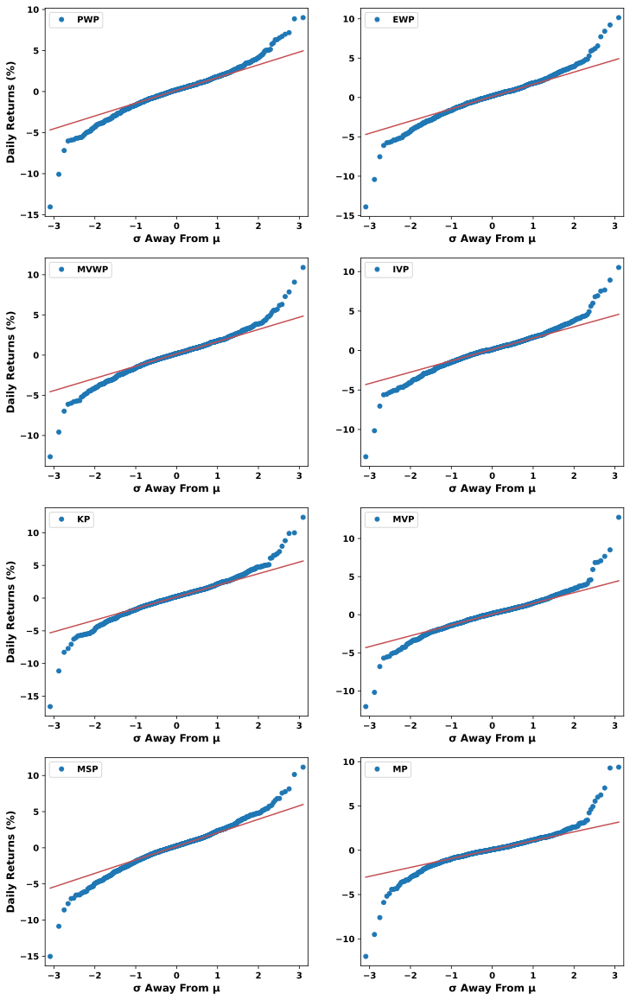

In [136]:
plot_qq(returns[portfs + ["MP"]])

In [137]:
downside_portfs#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral") 

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
PWP,0.2380,-0.1398,8.4019,-0.4657,497,0.5335,20.2558,0.5942,1.0367,0.0531
EWP,0.2358,-0.1275,6.9213,-0.4427,495,0.6183,18.6629,0.6832,1.1551,0.0527
MVWP,0.2266,-0.1191,8.1455,-0.4291,468,0.5618,17.0112,0.6233,1.0478,0.0523
IVP,0.2239,-0.1206,6.1348,-0.4240,471,0.5607,17.7520,0.6279,1.0551,0.0401
KP,0.2623,-0.1049,5.5752,-0.4271,354,1.0709,15.6744,1.1132,1.6982,0.0781
MVP,0.2054,-0.1149,10.0549,-0.3929,480,0.4287,16.2935,0.5012,0.8124,0.0233
MSP,0.2760,-0.1413,6.4519,-0.5169,394,0.8338,20.7116,0.8786,1.5367,0.1167
MP,0.1856,-0.0829,8.6731,-0.3392,500,0.3070,11.1261,0.3661,0.5074,0.0075


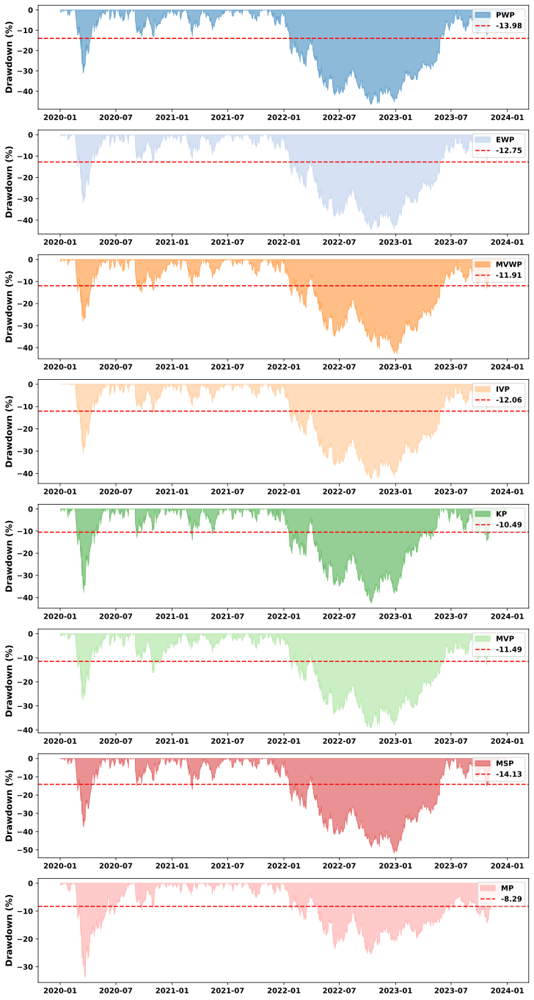

In [138]:
plot_drawdowns(returns[portfs + ["MP"]]) 

In [139]:
tail_portfs#.style\
           #.highlight_max(color = "lightgreen")\
           #.highlight_min(color = "lightcoral")

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 95%),Outlier Loss Ratio (< 5%)
PWP,-0.3837,4.0236,-0.0467,0.0453,0.9706,1.1261,2.1946,2.1891
EWP,-0.3575,4.5796,-0.0457,0.0444,0.9700,1.1445,2.2525,2.1121
MVWP,-0.2369,4.0725,-0.0445,0.0434,0.9751,1.1318,2.2140,2.1799
IVP,-0.3034,5.3613,-0.0431,0.0422,0.9781,1.1446,2.1926,2.0618
KP,-0.3132,5.1249,-0.0507,0.0516,1.0193,1.2813,2.1830,2.0300
MVP,-0.0672,6.8788,-0.0403,0.0394,0.9782,1.1067,2.1788,2.0399
MSP,-0.3410,3.0177,-0.0542,0.0526,0.9694,1.1904,2.3054,2.1672
MP,-0.4816,11.8225,-0.0349,0.0316,0.9058,1.0041,2.0183,2.1199


In [140]:
VaR_portfs#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                                                \
     Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
PWP             -0.0335              -0.0324                  -0.0329   
EWP             -0.0317              -0.0318                  -0.0319   
MVWP            -0.0316              -0.0312                  -0.0309   
IVP             -0.0291              -0.0301                  -0.0296   
KP              -0.0336              -0.0356                  -0.0352   
MVP             -0.0265              -0.0285                  -0.0264   
MSP             -0.0387              -0.0375                  -0.0383   
MP              -0.0205              -0.0233                  -0.0218   

                                       Weekly                       \
     Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
PWP                -0.0467            -0.0750              -0.0724   
EWP                -0.0457            -0.0708              -0.0711   
MVWP               -0.0445            -0.0707              -0.0698   
IVP                -0.0431            -0.0650              -0.0672   
KP                 -0.0507            -0.0751              -0.0796   
MVP                -0.0403            -0.0593              -0.0638   
MSP                -0.0542            -0.0866              -0.0839   
MP                 -0.0349            -0.0458              -0.0522   

                                                               Monthly  \
     Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
PWP                   -0.0735               -0.1044            -0.1537   
EWP                   -0.0714               -0.1022            -0.1451   
MVWP                  -0.0691               -0.0995            -0.1449   
IVP                   -0.0662               -0.0964            -0.1331   
KP                    -0.0788               -0.1133            -0.1540   
MVP                   -0.0590               -0.0901            -0.1216   
MSP                   -0.0857               -0.1213            -0.1775   
MP                    -0.0488               -0.0780            -0.0938   

                                                                          \
     Parametric VaR (95%) Cornish-Fisher VaR (95%) Conditional VaR (95%)   
PWP               -0.1483                  -0.1507               -0.2139   
EWP               -0.1458                  -0.1464               -0.2095   
MVWP              -0.1431                  -0.1417               -0.2040   
IVP               -0.1377                  -0.1357               -0.1976   
KP                -0.1632                  -0.1615               -0.2322   
MVP               -0.1308                  -0.1210               -0.1847   
MSP               -0.1720                  -0.1757               -0.2485   
MP                -0.1070                  -0.0999               -0.1599   

              Quarterly                                                \
     Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
PWP             -0.2663              -0.2569                  -0.2609   
EWP             -0.2512              -0.2525                  -0.2536   
MVWP            -0.2511              -0.2478                  -0.2454   
IVP             -0.2306              -0.2386                  -0.2350   
KP              -0.2667              -0.2826                  -0.2797   
MVP             -0.2106              -0.2265                  -0.2095   
MSP             -0.3075              -0.2980                  -0.3044   
MP              -0.1624              -0.1853                  -0.1731   

                                       Annual                       \
     Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
PWP                -0.3704            -0.5325              -0.5138   
EWP                -0.3629            -0.5025              -0.5049   
MVWP               -0.3533            -0.5021              -0.4957   
IVP

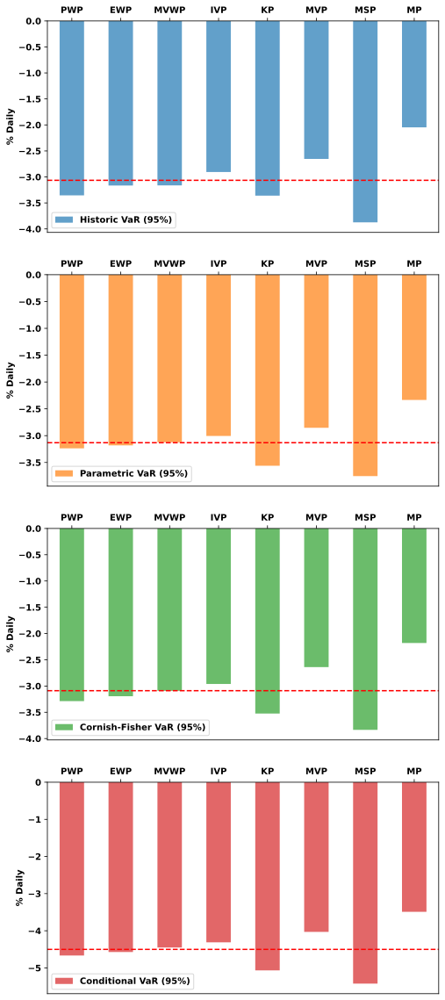

In [141]:
plot_Value_at_Risk(VaR_portfs, "daily") 

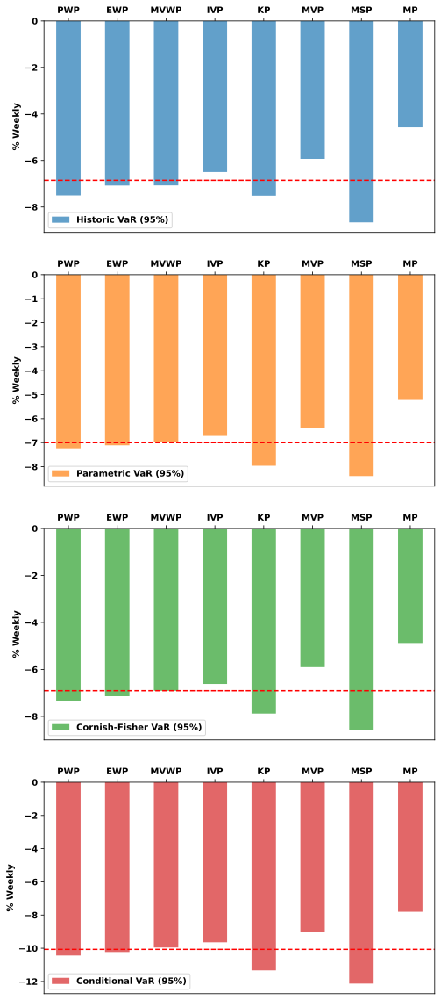

In [142]:
plot_Value_at_Risk(VaR_portfs, "weekly") 

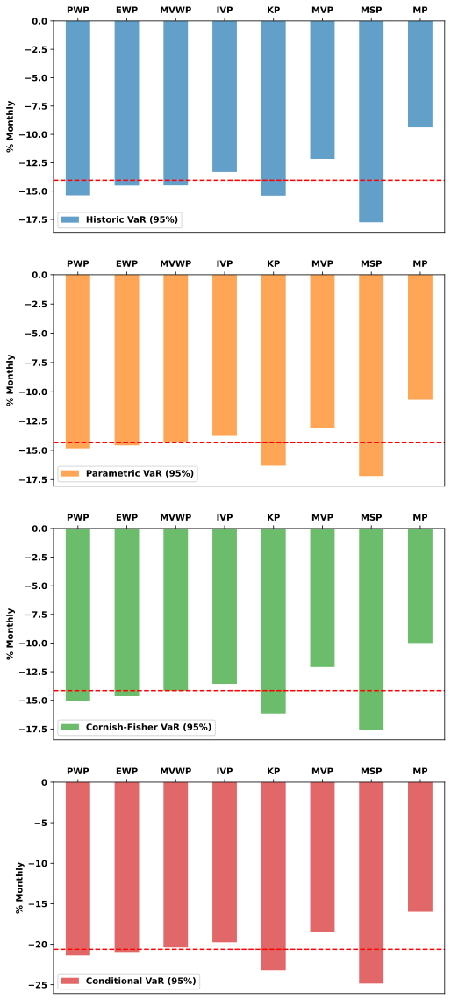

In [143]:
plot_Value_at_Risk(VaR_portfs, "monthly") 

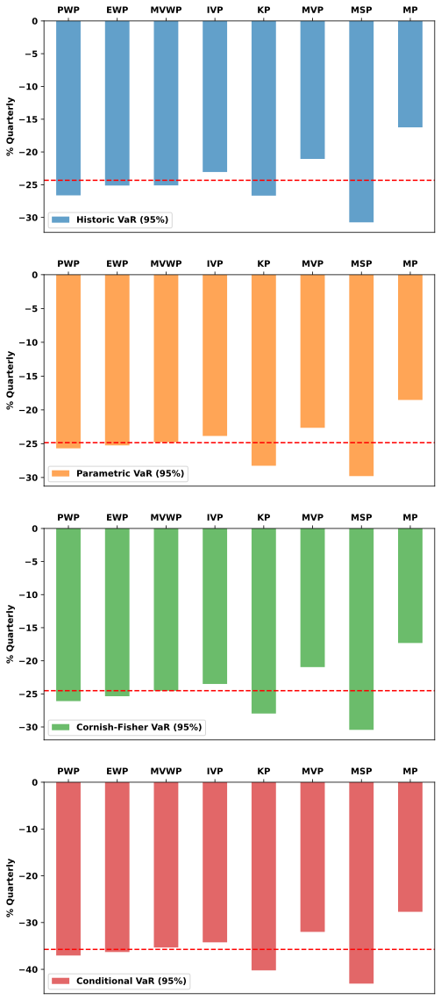

In [144]:
plot_Value_at_Risk(VaR_portfs, "quarterly") 

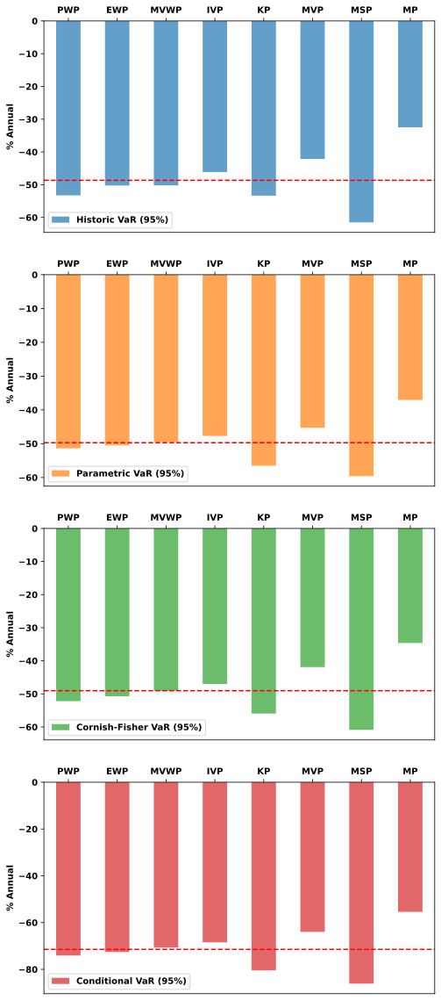

In [145]:
plot_Value_at_Risk(VaR_portfs) 

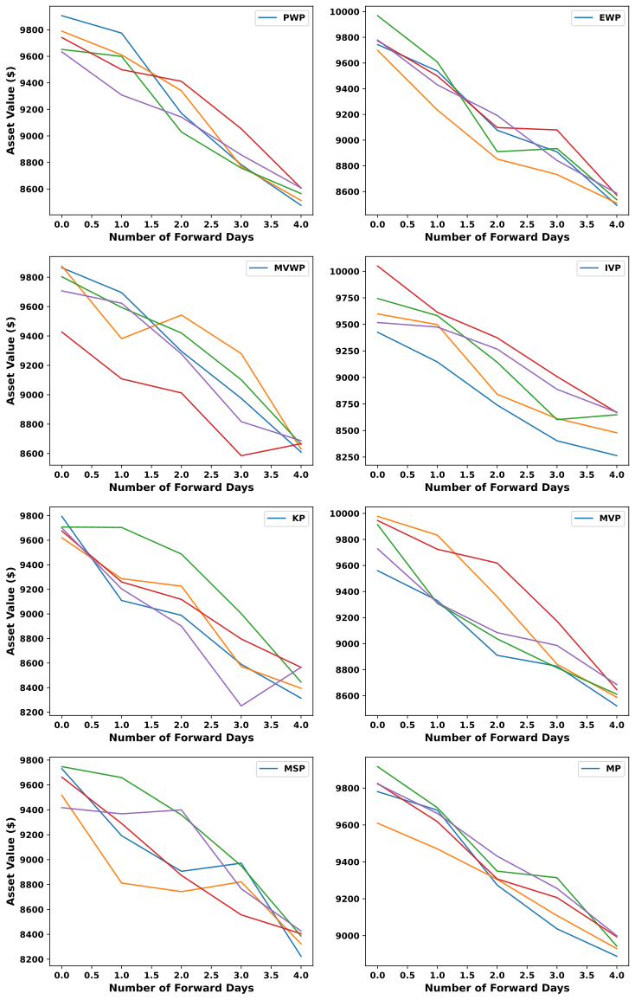

In [146]:
plot_MC_worst_scenarios(returns[portfs + ["MP"]], n_days = 5)

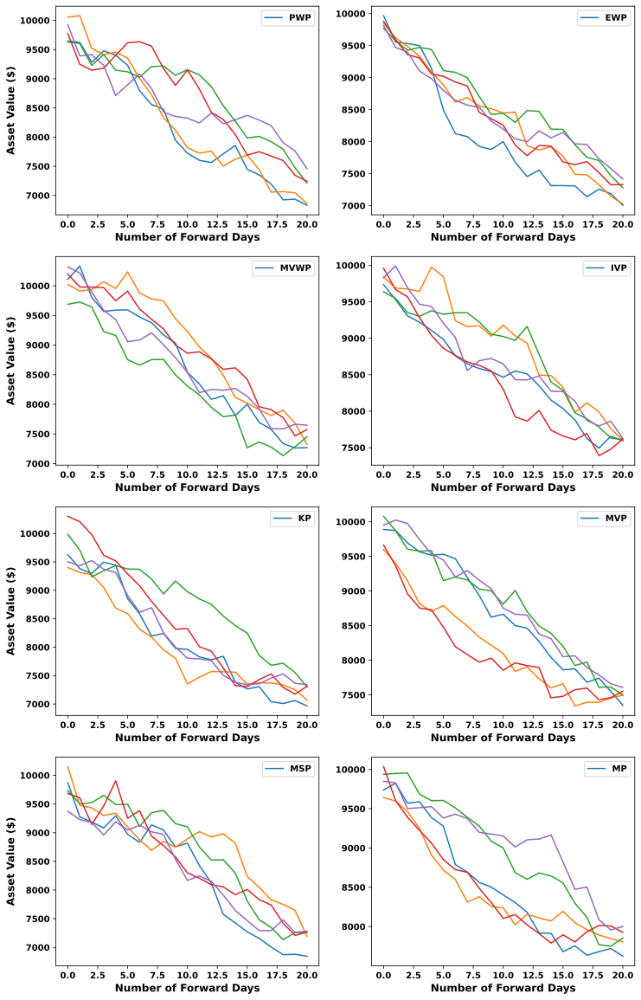

In [147]:
plot_MC_worst_scenarios(returns[portfs + ["MP"]], n_days = 21)

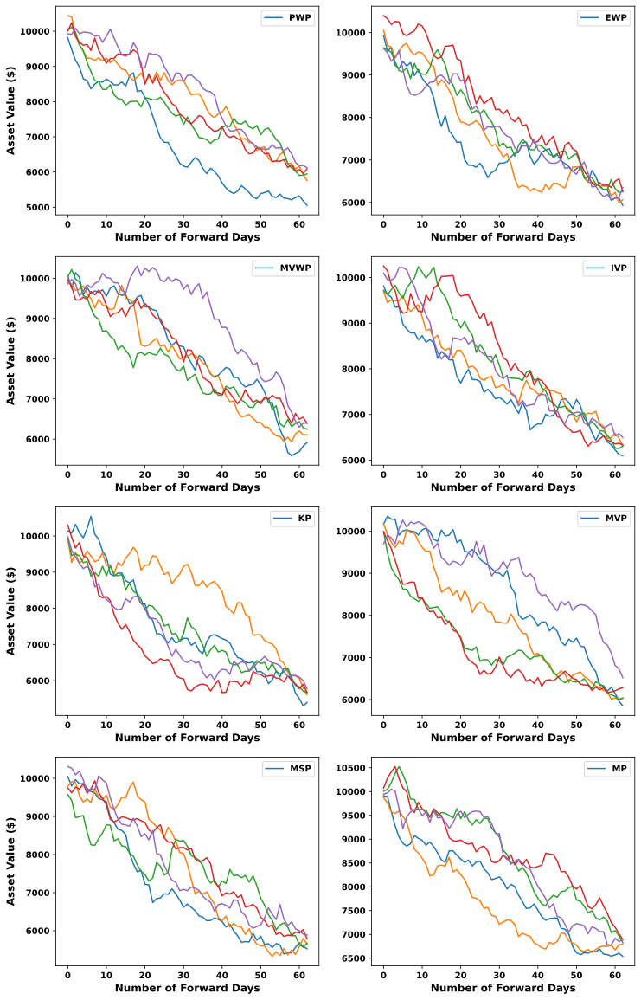

In [148]:
plot_MC_worst_scenarios(returns[portfs + ["MP"]], n_days = 63)

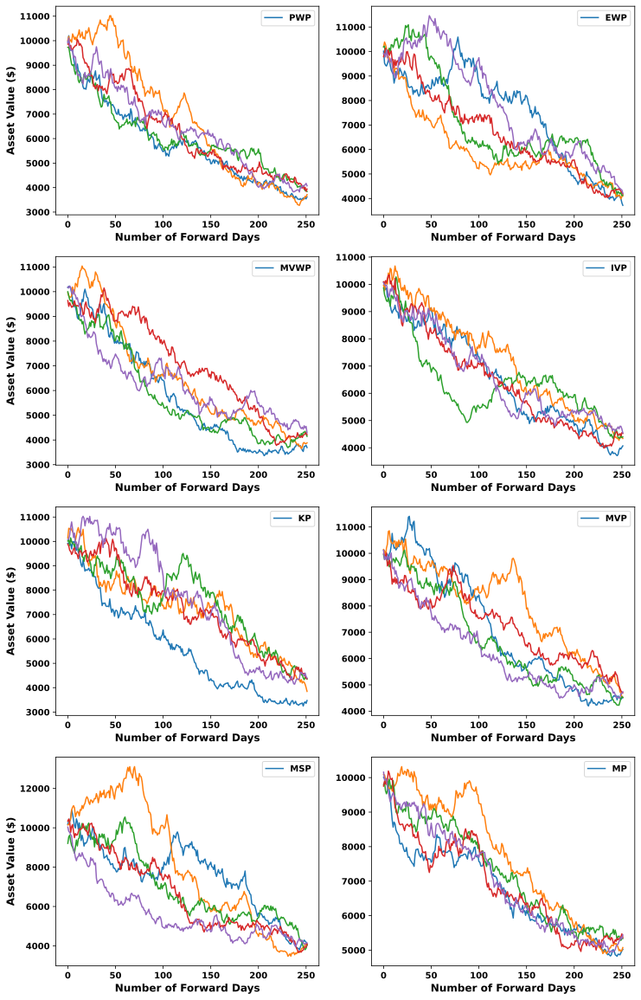

In [149]:
plot_MC_worst_scenarios(returns[portfs + ["MP"]], n_days = 252)

$$
\text{Annualized Active Return}_{portfolio} = \text{Annualized } \bar{\text{Return}}_{portfolio} - \text{Annualized } \bar{\text{Return}}_{benchmark}
$$

$$
\text{Annualized Tracking Error}_{portfolio} = \sqrt{\frac{\sum_{t=1}^{T} (\text{Return}_{portfolio,t} - \text{Return}_{benchmark,t})^2}{T}} \times \sqrt{252}
$$

$$
\text{Annualized Information Ratio}_{portfolio} = \frac{\text{Annualized Active Return}_{portfolio}}{\text{Annualized Tracking Error}_{portfolio}}
$$

$$
\text{Annualized M}^2 \text{ Ratio}_{portfolio} = \text{Annualized Sharpe}_{portfolio} \times \text{Annualized } \sigma_{benchmark} + \text{Risk-Free Rate} 
$$

$$
\text{Upside Capture}_{portfolio} = \frac{\left( \prod_{t=1}^{T} 1 + \max(0, \text{ Return}_{portfolio,t}) \right) - 1}{\left( \prod_{t=1}^{T} 1 + \max(0, \text{ Return}_{benchmark,t}) \right) - 1} 
$$ 

$$
\text{Downside Capture}_{portfolio} = \frac{\left( \prod_{t=1}^{T} 1 + \min(0, \text{ Return}_{portfolio,t}) \right) - 1}{\left( \prod_{t=1}^{T} 1 + \min(0, \text{ Return}_{benchmark,t}) \right) - 1} 
$$ 

$$
\text{R}^2_{portfolio} = 1 - \frac{\sum_{t=1}^{T} (\text{Return}_{benchmark, t} - \hat{\text{Return}}_{benchmark, t})^2}{\sum_{t=1}^{T} (\text{Return}_{benchmark, t} - \bar{\text{Return}}_{benchmark, t})^2}
$$

In [150]:
def perf_against_benchmark(returns_portfs_df, returns_benchmark) :
    """
    Arguments :
    ---------
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - returns_benchmark : DataFrame of daily returns of the benchmark index 
    
    Returns :
    -------
    - perf_df : DataFrame displaying ratios of performance relative to the benchmark 
    
    Function :
    --------
    - Computes the annualized active return, annualized tracking error, annualized information ratio, annualized m-squared ratio, upside cature, downside capture, and r-squared 
    """
    active_return_list = [  ]
    tracking_error_list = [  ]
    bull_excess_return_list = [  ]
    bear_excess_return_list = [  ]
    information_list = [  ]
    m2_list = [  ]
    upside_capture_list = [  ]
    downside_capture_list = [  ]
    r2_list = [  ]
    for portf in returns_portfs_df.columns : 
        
        ann_return_portf = returns_portfs_df[portf].mean( ) * 252
        ann_return_benchmark = returns_benchmark.mean( ) * 252
        active_return = ann_return_portf - ann_return_benchmark
        
        returns_above_benchmark = returns_portfs_df[portf].sub(returns_benchmark)
        tracking_error = returns_above_benchmark.std( ) * np.sqrt(252)
        ann_bull_excess_return = returns_above_benchmark.loc[returns_above_benchmark > 0].mean( ) * 252
        ann_bear_excess_return = returns_above_benchmark.loc[returns_above_benchmark < 0].mean( ) * 252 
        
        information = active_return / tracking_error 
        
        ann_sharpe_portf = (ann_return_portf - rf_rate) / (returns_portfs_df[portf].std( ) * np.sqrt(252)) 
        ann_std_benchmark = returns_benchmark.std( ) * np.sqrt(252)
        m2 = ann_sharpe_portf * ann_std_benchmark + rf_rate 
        
        cum_positive_portf = (1 + returns_portfs_df[portf].loc[returns_portfs_df[portf] > 0]).prod( ) - 1
        cum_positive_benchmark = (1 + returns_benchmark.loc[returns_benchmark > 0]).prod( ) - 1
        upside_capture = cum_positive_portf / cum_positive_benchmark
        
        cum_negative_portf = (1 + returns_portfs_df[portf].loc[returns_portfs_df[portf] < 0]).prod( ) - 1
        cum_negative_benchmark = (1 + returns_benchmark.loc[returns_benchmark < 0]).prod( ) - 1
        downside_capture = cum_negative_portf / cum_negative_benchmark
        
        lin_reg = linear_model.LinearRegression( )
        lin_reg.fit(returns_portfs_df[portf].to_frame( ) , returns_benchmark)
        Y_pred = lin_reg.predict(returns_portfs_df[portf].to_frame( ))
        r2 = metrics.r2_score(returns_benchmark, Y_pred)
        
        active_return_list.append(active_return)
        tracking_error_list.append(tracking_error)
        bull_excess_return_list.append(ann_bull_excess_return)
        bear_excess_return_list.append(ann_bear_excess_return) 
        information_list.append(information)
        m2_list.append(m2)
        upside_capture_list.append(upside_capture)
        downside_capture_list.append(downside_capture)
        r2_list.append(r2)
    
    perf_df = pd.DataFrame({
        "Annual Active Return" : active_return_list, 
        "Annual Tracking Error" : tracking_error_list, 
        "Annual Bull Excess Return" : bull_excess_return_list, 
        "Annual Bear Excess Return" : bear_excess_return_list,
        "Annual Information Ratio" : information_list, 
        "Annual M2 Ratio" : m2_list,
        "Upside Capture" : upside_capture_list, 
        "Downside Capture" : downside_capture_list,  
        "R-Squared" : r2_list
    }, index = returns_portfs_df.columns)
    return perf_df 

In [151]:
relative_perf_porfs = perf_against_benchmark(returns[portfs], returns["MP"])

In [152]:
relative_perf_porfs#.style\
                   #.highlight_max(color = "lightgreen")\
                   #.highlight_min(color = "lightcoral")

,Annual Active Return,Annual Tracking Error,Annual Bull Excess Return,Annual Bear Excess Return,Annual Information Ratio,Annual M2 Ratio,Upside Capture,Downside Capture,R-Squared
PWP,0.1525,0.1709,2.0572,-1.9682,0.8926,0.2057,18.0307,1.0090,0.7424
EWP,0.1782,0.1556,1.9223,-1.8187,1.1457,0.2267,16.6833,1.0088,0.7892
MVWP,0.1433,0.1527,1.9016,-1.8068,0.9380,0.2053,13.6013,1.0087,0.7809
IVP,0.1420,0.1388,1.6997,-1.5923,1.0234,0.2110,9.1069,1.0081,0.8033
KP,0.3513,0.2020,2.5435,-2.2095,1.7388,0.3132,62.6721,1.0094,0.7383
MVP,0.0727,0.1260,1.5177,-1.4309,0.5771,0.1657,5.3821,1.0076,0.8092
MSP,0.3300,0.2305,2.8325,-2.7373,1.4318,0.2870,100.9688,1.0096,0.6792


In [153]:
def plot_cum_active_return(returns_portfs_df, returns_benchmark) :
    """
    Arguments :
    ---------
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - returns_benchmark : DataFrame of daily returns of the benchmark index 
    
    Returns :
    -------
    - None 
    
    Function :
    --------
    - Subtracts the specified benchmark's cumulative returns from each portfolio's cumulative returns 
    - Draws an area plot of the active returns relative to the benchmark for each portfolio 
    """
    cum_returns_benchmark = (1 + returns_benchmark).cumprod( ) - 1 
    cum_returns_portfs = (1 + returns_portfs_df).cumprod( ) - 1 
    cum_active_return_portfs = cum_returns_portfs.sub(cum_returns_benchmark, axis = 0) 
    
    portfs = returns_portfs_df.columns 
    n_portfs = len(portfs)
    
    fig, ax = plt.subplots(nrows = n_portfs, ncols = 1, figsize = (12, n_portfs * 7))
    colors = sns.color_palette("tab10") 
    
    for i, portf in enumerate(portfs) : 
        ax[i].fill_between(
            cum_active_return_portfs.index, 
            cum_active_return_portfs[portf] * 100, 
            color = colors[i], 
            alpha = 0.7, 
            label = portf
        )
        
        ax[i].set_ylabel("Cumulative Active Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default")
    plt.show( )

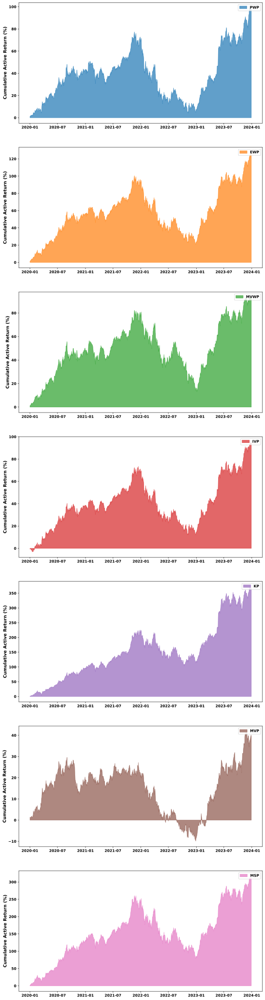

In [154]:
plot_cum_active_return(returns[portfs], returns["MP"])

In [155]:
def plot_seasonal_active_return(returns_portfs_df, returns_benchmark, freq = None) :
    """
    Arguments :
    ---------
    - returns_portfs_df : DataFrame of portfolios' daily returns 
    - returns_benchmark : DataFrame of daily returns of the benchmark index 
    - freq (optional) : str for resampling frequency -> weekly or monthly 

    Returns :
    -------
    - None 
        
    Function :
    --------
    - Resamples daily returns to the specified resampling frequency (if specified)
    - Subtracts the specified benchmark's returns from each portfolio's returns 
    - Plots a bar chart showing the average active return in each month of the year for each asset
    """
    if freq :
        resampling = {"weekly" : "W-Fri", "monthly" : "BM"} 
        returns_portfs_df = returns_portfs_df.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1)   
        returns_benchmark = returns_benchmark.resample(resampling[freq]).agg(lambda daily_ret: (1 + daily_ret).prod( ) - 1) 
    
    active_return_portfs = returns_portfs_df.sub(returns_benchmark, axis = 0)
    active_return_portfs["Month"] = active_return_portfs.index.month
    monthly_avg_active_return = active_return_portfs.groupby("Month").mean( )
    active_return_portfs.drop(columns = ["Month"], inplace = True)
    
    month_mapper = {
        1 : "Jan", 2 : "Feb", 3 : "Mar", 
        4 : "Apr", 5 : 'May', 6: "Jun", 
        7 : "Jul", 8 : "Aug", 9 : "Sept", 
        10 : "Oct", 11 : "Nov", 12 : "Dec"
    }
    monthly_avg_active_return.index = monthly_avg_active_return.index.map(month_mapper)
    
    portfs = returns_portfs_df.columns
    n_portfs = len(portfs)
    
    fig, ax = plt.subplots(nrows = n_portfs, ncols = 1, figsize = (12, n_portfs * 7))
    colors = sns.color_palette("tab10")
    
    for i, portf in enumerate(portfs) :  
        ax[i].bar(
            monthly_avg_active_return.index, 
            monthly_avg_active_return[portf] * 100, 
            width = 0.3, 
            color = colors[i], 
            alpha = 0.7, 
            label = portf
        )
        
        if freq :
            ax[i].set_ylabel(f"Average {freq.title( )} Active Return (%)", fontsize = 12)
        else :
            ax[i].set_ylabel("Average Daily Active Return (%)", fontsize = 12)
        ax[i].legend( )
    
    plt.style.use("default")
    plt.show( )

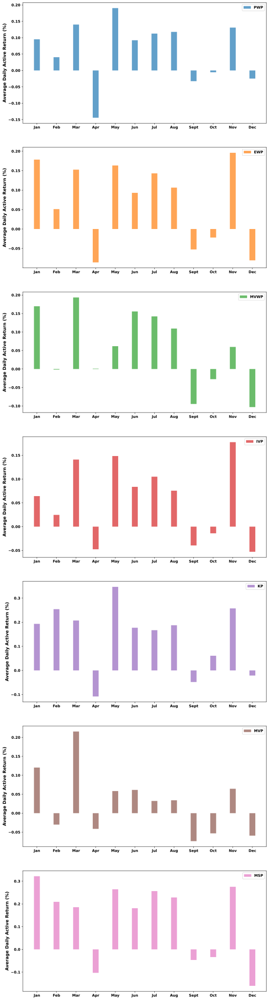

In [156]:
plot_seasonal_active_return(returns[portfs], returns["MP"])

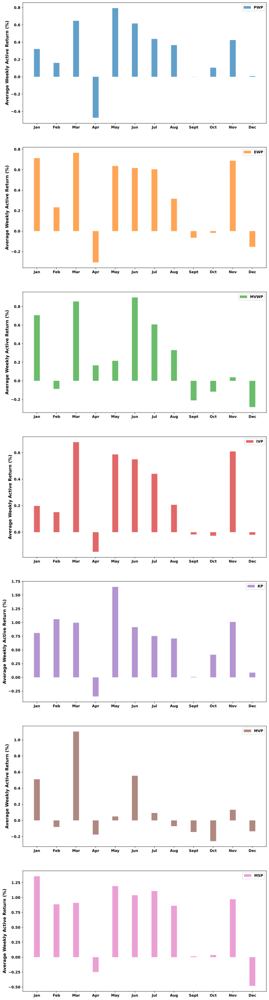

In [157]:
plot_seasonal_active_return(returns[portfs], returns["MP"], freq = "weekly")

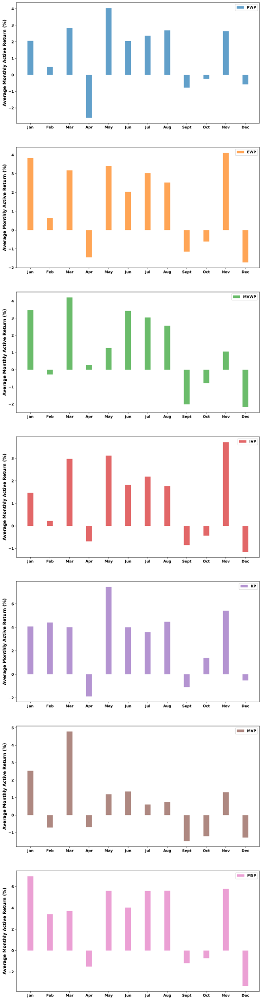

In [158]:
plot_seasonal_active_return(returns[portfs], returns["MP"], freq = "monthly")

## 3. Putting It All Together
<a id="section-3"></a>
<hr style="border: 0.25px solid black;">

In [159]:
summary = pd.concat(objs = [summary_stocks, summary_portfs], axis = 0) 

best_worst = pd.concat(objs = [best_worst_stocks, best_worst_portfs], axis = 0) 

win_percent = pd.concat(objs = [win_percent_stocks, win_percent_portfs], axis = 0)

win_loss = pd.concat(objs = [win_loss_stocks, win_loss_portfs], axis = 0)

win_lose_streak = pd.concat(objs = [win_lose_streak_stocks, win_lose_streak_portfs], axis = 0)

dist_attributes = pd.concat(objs = [dist_attributes_stocks, dist_attributes_portfs], axis = 0)

downside = pd.concat(objs = [downside_stocks, downside_portfs], axis = 0) 

tail = pd.concat(objs = [tail_stocks, tail_portfs], axis = 0) 

VaR = pd.concat(objs = [VaR_stocks, VaR_portfs], axis = 0) 

In [160]:
summary#.style\
       #.highlight_max(color = "lightgreen")\
       #.highlight_min(color = "lightcoral")

Daily                   Weekly                   Monthly             \
      Return Volatility Sharpe Return Volatility Sharpe  Return Volatility   
AAPL  0.0012     0.0211 0.0559 0.0059     0.0473 0.1250  0.0248     0.0969   
AMD   0.0017     0.0338 0.0512 0.0086     0.0755 0.1144  0.0363     0.1548   
AMZN  0.0008     0.0237 0.0327 0.0039     0.0531 0.0731  0.0163     0.1088   
AVGO  0.0015     0.0242 0.0641 0.0077     0.0540 0.1434  0.0325     0.1107   
CRM   0.0008     0.0258 0.0313 0.0040     0.0577 0.0700  0.0170     0.1183   
GOOGL 0.0010     0.0211 0.0452 0.0048     0.0472 0.1010  0.0200     0.0968   
INTC  0.0002     0.0260 0.0064 0.0008     0.0581 0.0143  0.0035     0.1191   
META  0.0010     0.0295 0.0334 0.0049     0.0659 0.0747  0.0207     0.1350   
MSFT  0.0011     0.0206 0.0523 0.0054     0.0460 0.1170  0.0226     0.0942   
NFLX  0.0009     0.0307 0.0292 0.0045     0.0686 0.0653  0.0188     0.1405   
NVDA  0.0027     0.0341 0.0790 0.0135     0.0764 0.1766  0.0566     0.1565   
ORCL  0.0009     0.0207 0.0433 0.0045     0.0464 0.0968  0.0189     0.0951   
QCOM  0.0008     0.0266 0.0317 0.0042     0.0595 0.0710  0.0177     0.1219   
SAP   0.0003     0.0201 0.0174 0.0017     0.0449 0.0388  0.0073     0.0920   
TSLA  0.0031     0.0429 0.0722 0.0155     0.0959 0.1614  0.0650     0.1965   
PWP   0.0011     0.0203 0.0540 0.0055     0.0455 0.1207  0.0231     0.0932   
EWP   0.0012     0.0201 0.0598 0.0060     0.0449 0.1337  0.0252     0.0920   
MVWP  0.0011     0.0196 0.0541 0.0053     0.0439 0.1209  0.0223     0.0899   
IVP   0.0011     0.0189 0.0558 0.0053     0.0423 0.1249  0.0222     0.0867   
KP    0.0019     0.0228 0.0828 0.0094     0.0510 0.1851  0.0396     0.1045   
MVP   0.0008     0.0178 0.0438 0.0039     0.0399 0.0980  0.0164     0.0817   
MSP   0.0018     0.0239 0.0754 0.0090     0.0535 0.1685  0.0378     0.1096   
MP    0.0005     0.0145 0.0340 0.0025     0.0324 0.0760  0.0103     0.0664   

             Quarterly                   Annual                    
      Sharpe    Return Volatility Sharpe Return Volatility Sharpe  
AAPL  0.2562    0.0745     0.1679 0.4437 0.2979     0.3357 0.8874  
AMD   0.2345    0.1089     0.2682 0.4062 0.4358     0.5363 0.8125  
AMZN  0.1498    0.0489     0.1885 0.2594 0.1956     0.3769 0.5188  
AVGO  0.2938    0.0976     0.1917 0.5089 0.3903     0.3835 1.0178  
CRM   0.1434    0.0509     0.2050 0.2484 0.2036     0.4099 0.4968  
GOOGL 0.2070    0.0601     0.1677 0.3586 0.2405     0.3353 0.7172  
INTC  0.0292    0.0104     0.2063 0.0506 0.0418     0.4125 0.1012  
META  0.1530    0.0620     0.2338 0.2651 0.2479     0.4677 0.5302  
MSFT  0.2398    0.0677     0.1631 0.4153 0.2710     0.3263 0.8306  
NFLX  0.1338    0.0564     0.2433 0.2317 0.2255     0.4867 0.4634  
NVDA  0.3620    0.1699     0.2710 0.6270 0.6798     0.5421 1.2540  
ORCL  0.1983    0.0566     0.1647 0.3435 0.2262     0.3293 0.6869  
QCOM  0.1454    0.0532     0.2111 0.2519 0.2127     0.4222 0.5037  
SAP   0.0796    0.0220     0.1594 0.1378 0.0879     0.3188 0.2757  
TSLA  0.3307    0.1950     0.3404 0.5728 0.7799     0.6808 1.1456  
PWP   0.2473    0.0692     0.1615 0.4284 0.2767     0.3230 0.8568  
EWP   0.2740    0.0756     0.1593 0.4747 0.3024     0.3186 0.9493  
MVWP  0.2478    0.0669     0.1558 0.4292 0.2674     0.3116 0.8584  
IVP   0.2559    0.0666     0.1501 0.4433 0.2662     0.3003 0.8866  
KP    0.3793    0.1189     0.1809 0.6569 0.4755     0.3619 1.3139  
MVP   0.2009    0.0492     0.1415 0.3480 0.1969     0.2829 0.6959  
MSP   0.3453    0.1135     0.1898 0.5981 0.4542     0.3797 1.1962  
MP    0.1558    0.0310     0.1150 0.2699 0.1242     0.2301 0.5399

In [161]:
best_worst#.style\
          #.highlight_max(color = "lightgreen")\
          #.highlight_min(color = "lightcoral")

Daily                   Weekly                  Monthly  \
      Best Return Worst Return Best Return Worst Return Best Return   
AAPL       0.1198      -0.1286      0.1473      -0.1753      0.2144   
AMD        0.1650      -0.1464      0.2609      -0.1540      0.4718   
AMZN       0.1354      -0.1405      0.1626      -0.1390      0.2706   
AVGO       0.1583      -0.1991      0.2001      -0.1793      0.2896   
CRM        0.2604      -0.1589      0.3063      -0.1426      0.3993   
GOOGL      0.0924      -0.1163      0.1431      -0.1203      0.1590   
INTC       0.1952      -0.1804      0.1605      -0.1580      0.3105   
META       0.2328      -0.2639      0.2449      -0.2370      0.2677   
MSFT       0.1422      -0.1474      0.1241      -0.1352      0.1763   
NFLX       0.1685      -0.3512      0.2590      -0.3682      0.2861   
NVDA       0.2437      -0.1845      0.2457      -0.1607      0.3634   
ORCL       0.2043      -0.1350      0.1631      -0.0982      0.2784   
QCOM       0.1522      -0.1495      0.2254      -0.1965      0.3572   
SAP        0.0987      -0.2316      0.1695      -0.2863      0.1875   
TSLA       0.1989      -0.2106      0.3334      -0.2586      0.7415   
PWP        0.0901      -0.1405      0.1073      -0.1120      0.1777   
EWP        0.1015      -0.1390      0.1149      -0.1152      0.1778   
MVWP       0.1090      -0.1264      0.0981      -0.1109      0.1755   
IVP        0.1052      -0.1346      0.1059      -0.1057      0.1700   
KP         0.1236      -0.1659      0.1685      -0.1445      0.2422   
MVP        0.1278      -0.1205      0.1023      -0.1086      0.1490   
MSP        0.1115      -0.1503      0.1455      -0.1316      0.2738   
MP         0.0938      -0.1198      0.1210      -0.1498      0.1268   

                     Quarterly                   Annual               
      Worst Return Best Return Worst Return Best Return Worst Return  
AAPL       -0.1223      0.4346      -0.2170      0.8075      -0.2683  
AMD        -0.2534      0.5584      -0.3006      1.2759      -0.5499  
AMZN       -0.2375      0.4150      -0.3484      0.8088      -0.4962  
AVGO       -0.1626      0.3722      -0.2497      0.9964      -0.1597  
CRM        -0.1726      0.5068      -0.2227      0.9846      -0.4783  
GOOGL      -0.1795      0.2204      -0.2165      0.6530      -0.3909  
INTC       -0.2022      0.4135      -0.3111      0.9012      -0.4868  
META       -0.3263      0.7612      -0.3389      1.9413      -0.6422  
MSFT       -0.1093      0.2904      -0.1670      0.5680      -0.2869  
NFLX       -0.4918      0.3464      -0.5332      0.6711      -0.5105  
NVDA       -0.3203      0.9007      -0.4444      2.3887      -0.5031  
ORCL       -0.1764      0.3385      -0.1554      0.3481      -0.0627  
QCOM       -0.1458      0.4178      -0.2333      0.7266      -0.3988  
SAP        -0.3144      0.2700      -0.2081      0.4981      -0.2635  
TSLA       -0.3673      1.0607      -0.5356      7.4344      -0.6503  
PWP        -0.1952      0.3122      -0.2930      0.9370      -0.4145  
EWP        -0.1774      0.3507      -0.2696      0.9135      -0.4025  
MVWP       -0.1566      0.3504      -0.2596      0.7693      -0.3956  
IVP        -0.1661      0.3257      -0.2537      0.8137      -0.3808  
KP         -0.1878      0.4244      -0.2962      1.1388      -0.3396  
MVP        -0.1437      0.2716      -0.2361      0.6991      -0.3436  
MSP        -0.2131      0.5055      -0.3258      1.4701      -0.4681  
MP         -0.1251      0.1995      -0.2000      0.2689      -0.1944

In [162]:
win_percent#.style\
           #.highlight_max(color = "lightgreen")\
           #.highlight_min(color = "lightcoral")

,% of Winning Days,% of Winning Weeks,% of Winning Months,% of Winning Quarters,% of Winning Years
AAPL,52.4851,56.9378,58.3333,62.5000,75.0000
AMD,49.9006,52.1531,50.0000,62.5000,75.0000
AMZN,51.8887,53.1100,56.2500,62.5000,75.0000
AVGO,52.9821,58.8517,70.8333,68.7500,75.0000
CRM,52.0875,50.2392,50.0000,43.7500,75.0000
GOOGL,53.4791,54.0670,58.3333,68.7500,75.0000
INTC,49.8012,53.5885,54.1667,43.7500,50.0000
META,51.7893,52.6316,62.5000,56.2500,75.0000
MSFT,52.3857,55.0239,58.3333,75.0000,75.0000
NFLX,50.8946,52.6316,54.1667,68.7500,75.0000


In [163]:
win_loss#.style\
        #.highlight_max(color = "lightgreen")\
        #.highlight_min(color = "lightcoral")

Daily                                            Weekly  \
      Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio   
AAPL           1.1713        1.0537              7.3926          1.4258   
AMD            1.1500        1.1500              6.3362          1.3395   
AMZN           1.0948        1.0109              4.2959          1.2178   
AVGO           1.2036        1.0682              8.9641          1.5325   
CRM            1.0956        1.0078              4.5461          1.2069   
GOOGL          1.1347        0.9849              6.2459          1.3070   
INTC           1.0188        1.0148              0.3330          1.0257   
META           1.1061        1.0276              4.8728          1.2227   
MSFT           1.1599        1.0499              7.0329          1.4011   
NFLX           1.0928        1.0543              4.3204          1.2060   
NVDA           1.2397        1.0399             10.3034          1.6295   
ORCL           1.1460        1.0312              6.6019          1.3166   
QCOM           1.0927        1.0627              4.3006          1.2091   
SAP            1.0522        0.9852              2.2511          1.1187   
TSLA           1.2237        1.0495              9.7357          1.5051   
PWP            1.1602        0.9390              7.6308          1.3830   
EWP            1.1798        0.9472              8.4538          1.4307   
MVWP           1.1607        0.9700              7.5403          1.3946   
IVP            1.1702        0.9565              5.6553          1.4084   
KP             1.2571        1.0012             11.3850          1.6547   
MVP            1.1313        0.9531              6.3010          1.3125   
MSP            1.2279        0.9740             10.3517          1.5425   
MP             1.1086        0.9838              5.1889          1.2442   

                                                Monthly                \
      Pay Off Ratio Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio   
AAPL         1.0784             17.0052          1.8863        1.3473   
AMD          1.2289             13.2192          1.8037        1.8037   
AMZN         1.0752              9.4985          1.4731        1.1457   
AVGO         1.0715             20.4482          2.3795        0.9798   
CRM          1.1954              8.6136          1.4501        1.4501   
GOOGL        1.1104             12.7007          1.7234        1.2310   
INTC         0.8883              1.3433          1.0352        0.8759   
META         1.1005              9.5879          1.5200        0.9120   
MSFT         1.1452             15.7507          2.1260        1.5186   
NFLX         1.0854              8.9911          1.5014        1.2704   
NVDA         1.3320             21.2572          2.5682        1.5409   
ORCL         1.0972             13.1180          1.7417        1.4738   
QCOM         1.0472              9.2673          1.4511        1.3350   
SAP          1.0462              5.4823          1.2275        1.3343   
TSLA         1.1835             18.7873          2.2659        1.7623   
PWP          1.1088             15.3696          1.9513        1.2785   
EWP          1.1470             16.7091          2.0566        1.4690   
MVWP         1.2078             15.1622          1.9112        1.1467   
IVP          1.1800             13.3722          1.9751        1.2259   
KP           1.2515             22.5286          2.6581        1.3291   
MVP          1.1367             12.7584          1.6946        0.9293   
MSP          1.1218             20.3610          2.3727        1.5545   
MP           0.9975             10.8935          1.5136        0.9916   

                                Quarterly                                    \
      Kelly Criterion (%) Gain-Pain Ratio Pay Off Ratio Kelly Criterion (%)   
AAPL              27.4083          2.9477        1.7686             41.2968   
AMD               22.2799          2.7608        1.6565             39.8614  

In [164]:
win_lose_streak#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

Longest Winning Streak                              \
                        Days Weeks Months Quarters Years   
AAPL                      11     8      7        3     2   
AMD                        8     7      3        3     2   
AMZN                       8    10      6        4     2   
AVGO                       8     7      6        7     2   
CRM                        8     7      5        2     2   
GOOGL                      7     8      8        7     2   
INTC                       9     7      5        5     1   
META                       8     6      9        5     2   
MSFT                       9     9      6        8     2   
NFLX                       8     6      4        4     2   
NVDA                      10     9      6        5     2   
ORCL                       8     7      6        7     2   
QCOM                       9     6      5        3     2   
SAP                       11     8      5        3     1   
TSLA                      13    11      6        4     2   
PWP                        9     8      5        7     2   
EWP                       11     9      5        7     2   
MVWP                      10     8      7        7     2   
IVP                       11     9      5        7     2   
KP                        10     8     10        7     2   
MVP                        9     5      6        7     2   
MSP                       11     8      5        8     2   
MP                         8     9      7        7     2   

      Longest Losing Streak                              
                       Days Weeks Months Quarters Years  
AAPL                      8     8      3        2     1  
AMD                       8     5      4        3     1  
AMZN                      7     8      5        2     1  
AVGO                      7     5      3        3     1  
CRM                       6     5      4        5     1  
GOOGL                     6     5      3        4     1  
INTC                      7     4      4        6     1  
META                      7     7      4        6     1  
MSFT                      7     5      3        3     1  
NFLX                      8     7      6        3     1  
NVDA                      7     5      3        3     1  
ORCL                     11     7      4        3     1  
QCOM                      9     6      4        4     1  
SAP                       7     7      6        3     1  
TSLA                      7     5      5        2     1  
PWP                       7     5      3        3     1  
EWP                       7     8      3        3     1  
MVWP                      7     7      3        4     1  
IVP                       7     8      3        3     1  
KP                        7     5      3        3     1  
MVP                      10     8      3        3     1  
MSP                       7     5      3        4     1  
MP                        7     7      3        3     1

In [165]:
dist_attributes#.style\
               #.highlight_max(color = "lightgreen")\
               #.highlight_min(color = "lightcoral")

,Shapiro-Wilk P-Value,Jarque-Bera P-Value,Augmented Dickey-Fuller P-Value,Kwiatkowski-Phillips-Schmidt-Shin P-Value,Best-Fit Distribution,Best-Fit P-Value
AAPL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9478
AMD,0.0000,0.0000,0.0000,0.1000,gennorm,0.4572
AMZN,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9959
AVGO,0.0000,0.0000,0.0000,0.1000,t,0.9620
CRM,0.0000,0.0000,0.0000,0.1000,t,0.9173
GOOGL,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9044
INTC,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9751
META,0.0000,0.0000,0.0000,0.1000,t,0.5524
MSFT,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.8796
NFLX,0.0000,0.0000,0.0000,0.1000,johnsonsu,0.9971


In [166]:
downside#.style\
        #.highlight_max(color = "lightgreen")\
        #.highlight_min(color = "lightcoral")

,Annual Downside Standard Deviation,Average Drawdown,Average Drawdown Duration (Days),Maximum Drawdown,Longest Drawdown Duration (Days),Sterling Ratio,Ulcer Index,Calmar Ratio,Sortino Ratio,Kappa Ratio
AAPL,0.2359,-0.0957,12.0649,-0.3143,360,0.8622,12.1738,0.9479,1.1358,0.0517
AMD,0.3432,-0.2496,19.5306,-0.6545,524,0.6279,30.9158,0.6658,1.1822,0.1492
AMZN,0.2560,-0.2023,23.5366,-0.5615,624,0.2987,25.8112,0.3483,0.6468,0.0403
AVGO,0.2800,-0.0914,9.5895,-0.4830,349,0.8503,12.9584,0.8081,1.2867,0.0348
CRM,0.2815,-0.2527,23.5366,-0.5862,538,0.2969,29.9426,0.3474,0.6168,0.0123
GOOGL,0.2386,-0.1343,10.0549,-0.4432,530,0.4928,18.2466,0.5426,0.8820,0.0592
INTC,0.3074,-0.3291,250.5000,-0.6363,990,0.0185,37.2002,0.0656,0.0382,0.0013
META,0.3662,-0.2518,22.9524,-0.7674,582,0.2868,33.5673,0.3231,0.5952,0.0122
MSFT,0.2302,-0.1044,10.0549,-0.3756,392,0.6744,14.3968,0.7215,1.0469,0.0357
NFLX,0.3862,-0.2926,22.9524,-0.7595,531,0.2590,37.9341,0.2970,0.5063,0.0083


In [167]:
tail#.style\
    #.highlight_max(color = "lightgreen")\
    #.highlight_min(color = "lightcoral") 

,Skew,Kurtosis,Average Lower Tail Return (< 5%),Average Upper Tail Return (> 95%),Tail Ratio,Common Sense Ratio,Outlier Win Ratio (> 95%),Outlier Loss Ratio (< 5%)
AAPL,0.0769,4.8718,-0.0469,0.0488,1.0415,1.2199,2.1135,2.2166
AMD,0.2163,2.1605,-0.0715,0.0805,1.1259,1.2948,2.1121,2.2454
AMZN,0.0959,3.7537,-0.0527,0.0550,1.0431,1.1420,2.2456,2.0753
AVGO,-0.3107,9.7730,-0.0518,0.0567,1.0950,1.3180,2.1330,2.0860
CRM,0.8161,13.0642,-0.0565,0.0596,1.0539,1.1547,2.0996,2.1805
GOOGL,-0.0966,3.2226,-0.0477,0.0497,1.0405,1.1806,2.2945,2.1238
INTC,-0.1492,8.7736,-0.0601,0.0596,0.9923,1.0110,2.0340,2.0564
META,-0.5770,16.8893,-0.0644,0.0669,1.0380,1.1482,2.1182,2.1303
MSFT,0.0246,6.4885,-0.0452,0.0478,1.0567,1.2257,2.0116,2.0784
NFLX,-1.3312,21.7792,-0.0668,0.0722,1.0811,1.1813,2.3350,1.9865


In [168]:
VaR#.style\
   #.highlight_max(color = "lightgreen")\
   #.highlight_min(color = "lightcoral") 

Daily                                                \
      Historic VaR (95%) Parametric VaR (95%) Cornish-Fisher VaR (95%)   
AAPL             -0.0324              -0.0336                  -0.0311   
AMD              -0.0519              -0.0538                  -0.0503   
AMZN             -0.0355              -0.0383                  -0.0358   
AVGO             -0.0337              -0.0382                  -0.0355   
CRM              -0.0385              -0.0417                  -0.0285   
GOOGL            -0.0324              -0.0338                  -0.0330   
INTC             -0.0365              -0.0426                  -0.0391   
META             -0.0410              -0.0475                  -0.0421   
MSFT             -0.0295              -0.0327                  -0.0299   
NFLX             -0.0390              -0.0495                  -0.0466   
NVDA             -0.0512              -0.0535                  -0.0463   
ORCL             -0.0271              -0.0332                  -0.0209   
QCOM             -0.0394              -0.0429                  -0.0389   
SAP              -0.0281              -0.0327                  -0.0325   
TSLA             -0.0640              -0.0674                  -0.0641   
PWP              -0.0335              -0.0324                  -0.0329   
EWP              -0.0317              -0.0318                  -0.0319   
MVWP             -0.0316              -0.0312                  -0.0309   
IVP              -0.0291              -0.0301                  -0.0296   
KP               -0.0336              -0.0356                  -0.0352   
MVP              -0.0265              -0.0285                  -0.0264   
MSP              -0.0387              -0.0375                  -0.0383   
MP               -0.0205              -0.0233                  -0.0218   

                                        Weekly                       \
      Conditional VaR (95%) Historic VaR (95%) Parametric VaR (95%)   
AAPL                -0.0469            -0.0724              -0.0751   
AMD                 -0.0715            -0.1160              -0.1204   
AMZN                -0.0527            -0.0793              -0.0856   
AVGO                -0.0518            -0.0754              -0.0854   
CRM                 -0.0565            -0.0860              -0.0932   
GOOGL               -0.0477            -0.0725              -0.0756   
INTC                -0.0601            -0.0815              -0.0952   
META                -0.0644            -0.0918              -0.1062   
MSFT                -0.0452            -0.0659              -0.0732   
NFLX                -0.0668            -0.0873              -0.1108   
NVDA                -0.0696            -0.1144              -0.1196   
ORCL                -0.0467            -0.0607              -0.0743   
QCOM                -0.0590            -0.0881              -0.0959   
SAP                 -0.0454            -0.0628              -0.0731   
TSLA                -0.0932            -0.1432              -0.1508   
PWP                 -0.0467            -0.0750              -0.0724   
EWP                 -0.0457            -0.0708              -0.0711   
MVWP                -0.0445            -0.0707              -0.0698   
IVP                 -0.0431            -0.0650              -0.0672   
KP                  -0.0507            -0.0751              -0.0796   
MVP                 -0.0403            -0.0593              -0.0638   
MSP                 -0.0542            -0.0866              -0.0839   
MP                  -0.0349            -0.0458              -0.0522   

                                                                Monthly  \
      Cornish-Fisher VaR (95%) Conditional VaR (95%) Historic VaR (95%)   
AAPL                   -0.0694               -0.1048            -0.1485   
AMD                    -0.1124               -0.1598            -0.2377   
AMZN                   -0.0801               -0.1178            -0.1625   
AVGO             

### 3.1 Plotting the Efficient Frontier and the Capital Asset Line 
<a id="subsection-31"></a>

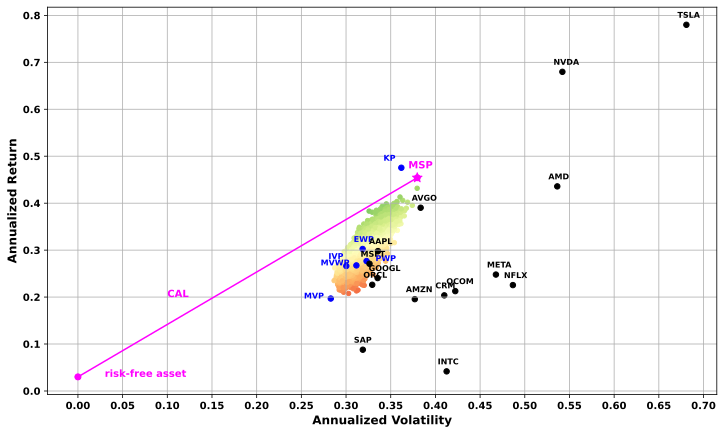

In [169]:
plt.figure(figsize = (12, 7))  
    
# plot the randomly–weighted portfolios 
plt.scatter(
    x = rand_portfs_summary[("Annual", "Volatility")],
    y = rand_portfs_summary[("Annual", "Return")], 
    c = rand_portfs_summary[("Annual", "Sharpe")], 
    cmap = "RdYlGn", vmin = 0.5, 
    vmax = 1.4, 
    s = 20
)

# plot the minimum variance portfolio 
plt.scatter(
    x = summary_portfs.loc["MVP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["MVP" , ("Annual", "Return")], 
    s = 30, 
    c = "blue"
) 

plt.annotate(
    "MVP", 
    size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["MVP" , ("Annual", "Volatility")] - 0.03, summary_portfs.loc["MVP" , ("Annual", "Return")])
)

# plot the maximum sharpe portfolio 
plt.scatter(
    x = summary_portfs.loc["MSP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["MSP" , ("Annual", "Return")],  
    c = "fuchsia", s = 100, marker = "*"
)

plt.annotate(
    "MSP", 
    size = 10, 
    c = "fuchsia", 
    xy = (summary_portfs.loc["MSP" , ("Annual", "Volatility")] - 0.01, summary_portfs.loc["MSP" , ("Annual", "Return")] + 0.02)
)

# plot the price–weighted portfolio
plt.scatter(
    x = summary_portfs.loc["PWP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["PWP" , ("Annual", "Return")], 
    s = 30, 
    c = "blue"
)

plt.annotate(
    "PWP", 
    size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["PWP" , ("Annual", "Volatility")] + 0.01, summary_portfs.loc["PWP" , ("Annual", "Return")])
)

# plot the equally–weighted portfolio
plt.scatter(
    x = summary_portfs.loc["EWP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["EWP" , ("Annual", "Return")], 
    s = 30, 
    c = "blue"
)

plt.annotate(
    "EWP", 
    size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["EWP" , ("Annual", "Volatility")] - 0.01, summary_portfs.loc["EWP" , ("Annual", "Return")] + 0.015)
)

# plot the market–value–weighted portfolio 
plt.scatter(
    x = summary_portfs.loc["MVWP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["MVWP" , ("Annual", "Return")],  
    s = 30, 
    c = "blue",
)

plt.annotate(
    "MVWP", 
    size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["MVWP", ("Annual", "Volatility")] - 0.04, summary_portfs.loc["MVWP" , ("Annual", "Return")])
)  

# plot the inverse volatility portfolio 
plt.scatter(
    x = summary_portfs.loc["IVP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["IVP" , ("Annual", "Return")], 
    s = 30, 
    c = "blue",
)

plt.annotate(
    "IVP", size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["IVP", ("Annual", "Volatility")] - 0.02, summary_portfs.loc["IVP" , ("Annual", "Return")] + 0.015)
)  

# plot the Kelly criterion portfolio 
plt.scatter(
    x = summary_portfs.loc["KP" , ("Annual", "Volatility")], 
    y = summary_portfs.loc["KP" , ("Annual", "Return")], 
    s = 30, 
    c = "blue"
)

plt.annotate(
    "KP", 
    size = 8, 
    c = "blue", 
    xy = (summary_portfs.loc["KP", ("Annual", "Volatility")] - 0.02, summary_portfs.loc["KP" , ("Annual", "Return")] + 0.015)
)  

# plot the individual stocks in the portfolio 
plt.scatter(x = summary_stocks[("Annual", "Volatility")], y = summary_stocks[("Annual", "Return")], s = 30, c = "black")

for ticker in tickers : 
    plt.annotate(
        ticker, 
        size = 8, 
        xy = (summary_stocks.loc[ticker , ("Annual", "Volatility")] - 0.01, summary_stocks.loc[ticker , ("Annual", "Return")] + 0.015), 
    )  

# plot the risk free asset and the capital market line 
plt.scatter(x = pd.Series(data = 0).values, y = rf_rate, s = 30, c = "fuchsia")
plt.annotate("risk-free asset", size = 10, c = "fuchsia", xy = (rf_rate, rf_rate))

plt.plot(
    [0, summary_portfs.loc["MSP" , ("Annual", "Volatility")]], [rf_rate, summary_portfs.loc["MSP" , ("Annual", "Return")]], 
    c = "fuchsia", 
    marker = "o", 
    linestyle = "-"
)
plt.annotate("CAL", size = 10, c = "fuchsia", xy = (0.1, 0.2))

plt.xticks(ticks = np.array(range(0, 71, 5)) / 100)
plt.xlabel("Annualized Volatility", fontsize = 12)
plt.ylabel("Annualized Return", fontsize = 12) 
plt.grid( )
plt.show( )   

### 3.2 Impact and Magnitude of Diversification 
<a id="subsection-32"></a>

$$
\text{Diversification Ratio}_{t} = \frac{\sigma_{portfolio,t}}{\sum_{i=1}^{N} \sigma_{i,t} \times \text{Weight}_{i,t}} - 1
$$

In [170]:
def plot_portf_diversif(returns_tickers, weights_portf, returns_portf) :
    """
    Arguments :
    ---------
    - returns_tickers : DataFrame of daily returns for assets in the portfolio 
    - weights_portf : DataFrame of monthly weights for assets in the portfolio
    - returns_portf : DataFrame of daily returns for the portfolio 
    
    Returns :
    -------
    - None 
        
    Function :
    --------
    - Draws a line plot of the monthly weighted sum of assets' volatilities 
    - Draws a line plot of the monthly volatility of the portfolio
    - Draws a line plot of the % difference between portfolio's volatility and assets' volatilities 
    - Draws a line plot of the sum of squared monthly weights 
    """
    monthly_std_tickers = returns_tickers.resample("BM").std( )
    monthly_weights = weights_portf.resample("BM").last( )
    weighted_sum_std = monthly_std_tickers.mul(monthly_weights).sum(axis = 1)
    
    portf = returns_portf.name 
    monthly_std_portf = returns_portf.resample("BM").std( )
    
    diversif_ratio = -(monthly_std_portf.sub(weighted_sum_std)).div(weighted_sum_std)
    
    fig , ax = plt.subplots(figsize = (11.5 , 7), sharex = False, sharey = False, nrows = 1, ncols = 1)
    
    ax.plot(weighted_sum_std.mul(100), c = "red", label = "Weighted Sum of Assets's Volatilities")
    ax.plot(monthly_std_portf.mul(100), c = "orange", label = f"{portf} Volatility")
    ax.set_ylabel("Monthly Volatility (%)", fontsize = 11)
    ax.legend( )
    
    ax2 = ax.twinx( )
    ax2.plot(diversif_ratio.mul(100), linestyle = "dotted", marker = "o", color = "tab:blue", label = "Diversification Ratio")
    ax2.set_ylabel("Monthly Diversification (%)", fontsize = 11)
    
    plt.style.use("default")
    plt.show( )

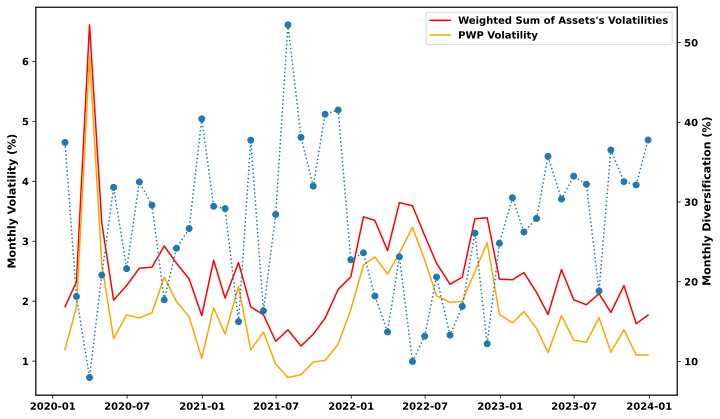

In [171]:
plot_portf_diversif(returns[tickers], weights_PWP, returns["PWP"])

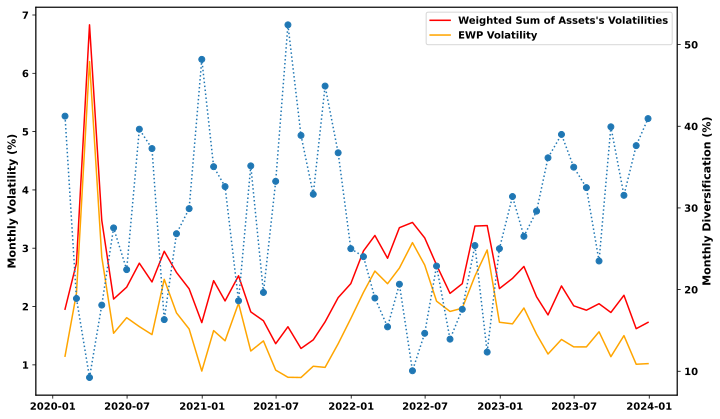

In [172]:
plot_portf_diversif(returns[tickers], weights_EWP, returns["EWP"])

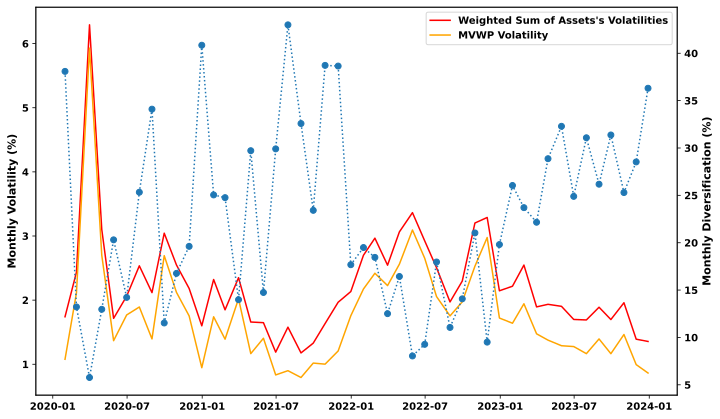

In [173]:
plot_portf_diversif(returns[tickers], weights_MVWP, returns["MVWP"])

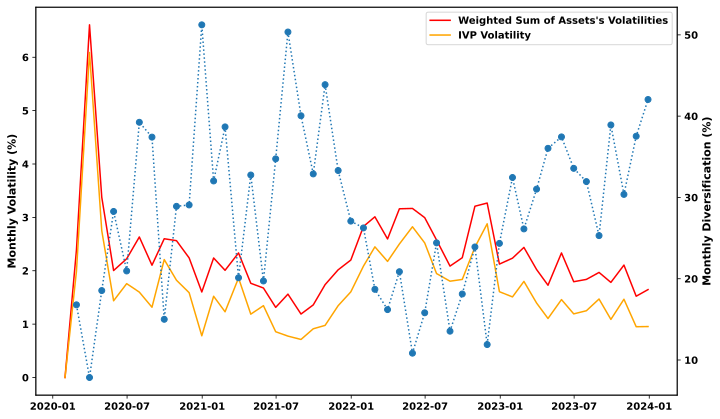

In [174]:
plot_portf_diversif(returns[tickers], weights_IVP, returns["IVP"])

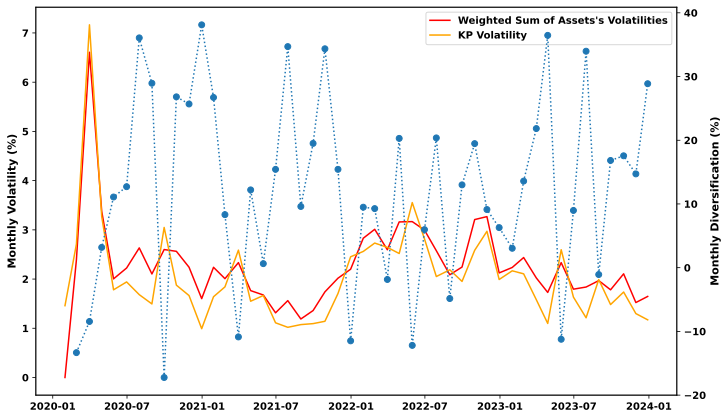

In [175]:
plot_portf_diversif(returns[tickers], weights_IVP, returns["KP"])

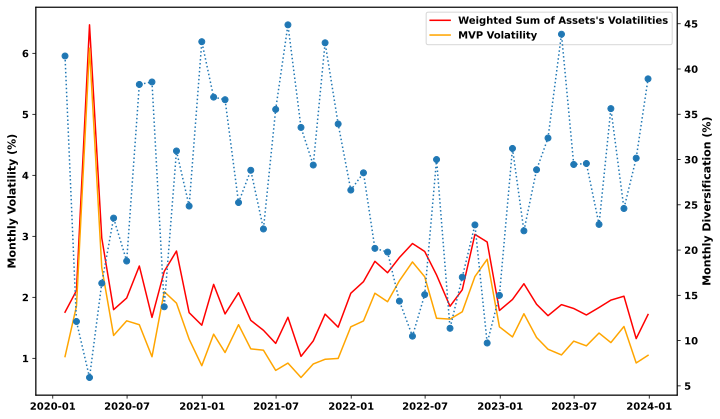

In [176]:
plot_portf_diversif(returns[tickers], weights_MVP, returns["MVP"])

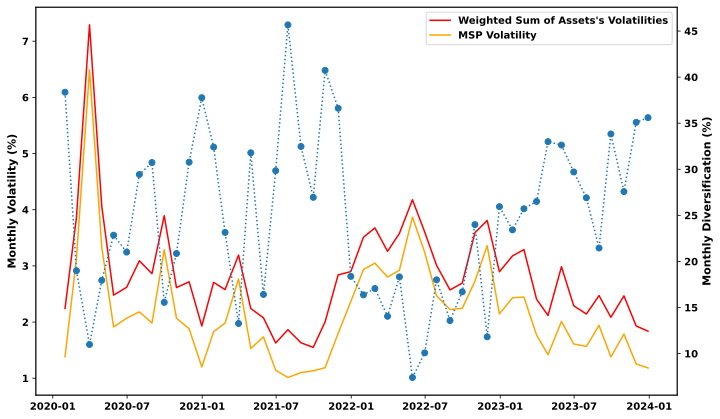

In [177]:
plot_portf_diversif(returns[tickers], weights_MSP, returns["MSP"])